# import and split df

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style="darkgrid")
%matplotlib inline
from matplotlib.gridspec import GridSpec

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.preprocessing import StandardScaler, FunctionTransformer, MinMaxScaler,QuantileTransformer
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.metrics import silhouette_samples, silhouette_score, davies_bouldin_score, adjusted_rand_score
import matplotlib.cm as cm

In [ ]:
df_cluster = pd.read_csv('/content/drive/MyDrive/OpenClassrooms/POlist_fatmi_amine/P4_olist_cleaned.csv', \
                         parse_dates=['order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date'])

In [ ]:
df_cluster['payment'] = df_cluster['price'] + df_cluster['freight_value']
df_cluster['perc_freight'] = df_cluster['freight_value'] / df_cluster['payment']

# Split DF

In [ ]:
df_2017 = df_cluster.query('order_purchase_timestamp < datetime.datetime(2018,1,1,0,0,0)').reset_index()
df_2017_2m = df_cluster.query('order_purchase_timestamp < datetime.datetime(2018,3,1,0,0,0)').reset_index()
df_2017_4m = df_cluster.query('order_purchase_timestamp < datetime.datetime(2018,5,1,0,0,0)').reset_index()
df_2017_6m = df_cluster.query('order_purchase_timestamp < datetime.datetime(2018,7,1,0,0,0)').reset_index()
df_2017_8m = df_cluster.query('order_purchase_timestamp < datetime.datetime(2018,9,1,0,0,0)').reset_index()

# Functions

In [ ]:
# define class DataFrameSelector for the pipeline
from sklearn.base import BaseEstimator, TransformerMixin
class DataFrameSelector(BaseEstimator, TransformerMixin):
  def __init__(self, attribute_names):
    self.attribute_names = attribute_names
  def fit(self, X, y=None):
    return self
  def transform(self, X):
    return X[self.attribute_names].values
  def inverse_transform(self,X,y=None):
    return self

In [ ]:
sum_of_sq_dist = {}
davies_bouldin = {}

def plot_silhouette_project(X_feat, X_2d):

  range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10]

  for n_clusters in range_n_clusters:
      # Create a subplot with 1 row and 2 columns
      fig, (ax1, ax2) = plt.subplots(1, 2)
      fig.set_size_inches(18, 7)

      # The 1st subplot is the silhouette plot
      # The silhouette coefficient can range from -1, 1 but in this example all
      # lie within [-0.1, 1]
      ax1.set_xlim([-1, 1])
      # The (n_clusters+1)*10 is for inserting blank space between silhouette
      # plots of individual clusters, to demarcate them clearly.
      # ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

      # Initialize the clusterer with n_clusters value and a random generator
      # seed of 10 for reproducibility.
      clusterer = KMeans(n_clusters=n_clusters, init='k-means++', random_state=10)
      cluster_labels = clusterer.fit_predict(X_feat)

      # The silhouette_score gives the average value for all the samples.
      # This gives a perspective into the density and separation of the formed
      # clusters
      silhouette_avg = silhouette_score(X_feat, cluster_labels)
      print("For n_clusters =", n_clusters,
            "The average silhouette_score is :", silhouette_avg)

      # Compute the silhouette scores for each sample
      sample_silhouette_values = silhouette_samples(X_feat, cluster_labels)
      # Compute the Sum of squared distances
      sum_of_sq_dist[n_clusters] = clusterer.inertia_
      # Compute Davies-Bouldin Index
      davies_bouldin[n_clusters] = davies_bouldin_score(X_feat, cluster_labels)
    
      y_lower = 10
      for i in range(n_clusters):
          # Aggregate the silhouette scores for samples belonging to
          # cluster i, and sort them
          ith_cluster_silhouette_values = \
              sample_silhouette_values[cluster_labels == i]

          ith_cluster_silhouette_values.sort()

          size_cluster_i = ith_cluster_silhouette_values.shape[0]
          y_upper = y_lower + size_cluster_i

          color = cm.nipy_spectral(float(i) / n_clusters)
          ax1.fill_betweenx(np.arange(y_lower, y_upper),
                            0, ith_cluster_silhouette_values,
                            facecolor=color, edgecolor=color, alpha=0.7)

          # Label the silhouette plots with their cluster numbers at the middle
          ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

          # Compute the new y_lower for next plot
          y_lower = y_upper + 10  # 10 for the 0 samples

      ax1.set_title("The silhouette plot for the various clusters.")
      ax1.set_xlabel("The silhouette coefficient values")
      ax1.set_ylabel("Cluster label")

      # The vertical line for average silhouette score of all the values
      ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

      # ax1.set_yticks([])  # Clear the yaxis labels / ticks
      ax1.set_xticks([-1,-0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8, 1])

      # 2nd Plot showing the actual clusters formed
      colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
      ax2.scatter(X_2d[:, 0], X_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                  c=colors, edgecolor='k')

      # Labeling the clusters
      # centers = clusterer.cluster_centers_
      # Draw white circles at cluster centers
      # ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
      #             c="white", alpha=1, s=200, edgecolor='k')

      # for i, c in enumerate(centers):
      #     ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
      #                 s=50, edgecolor='k')

      ax2.set_title("The visualization of the clustered data after T-SNE(n_comp=2).")
      ax2.set_xlabel("Feature space for the 1st feature")
      ax2.set_ylabel("Feature space for the 2nd feature")

      plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                    "with n_clusters = %d" % n_clusters),
                  fontsize=14, fontweight='bold')
    
  # Create a subplot with 1 row and 2 columns
  fig, (ax1, ax2) = plt.subplots(1, 2)
  fig.set_size_inches(18, 7)

  ax1.set_xlabel('Number of Clusters(k)')
  ax1.set_ylabel('Sum of Square Distances') 
  ax1.set_title('Elbow Method For Optimal k')
  sns.pointplot(x = list(sum_of_sq_dist.keys()), y = list(sum_of_sq_dist.values()), ax=ax1)

  ax2.set_xlabel('Number of Clusters(k)')
  ax2.set_ylabel('Davies-Bouldin Index') 
  ax2.set_title('Davies-Bouldin For Optimal k')
  sns.pointplot(x = list(davies_bouldin.keys()), y = list(davies_bouldin.values()), ax=ax2)
      
  plt.show()

In [ ]:
def plot_silhouette_project_AC(X_feat, X_2d, n_clusters):


    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    # ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    cluster_labels = clusterer.fit_predict(X_feat)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X_feat, cluster_labels)
    print("The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X_feat, cluster_labels)
  
    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    # ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-1,-0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X_2d[:, 0], X_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for AgglomerativeClustering on sample data"),
                fontsize=14, fontweight='bold')
    
plt.show()

In [ ]:
def plot_silhouette_project_DBSCAN(X_feat, X_2d, n_clusters, eps, min_samples):


    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    # ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = DBSCAN(eps=eps, min_samples=min_samples)
    cluster_labels = clusterer.fit_predict(X_feat)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X_feat, cluster_labels)
    print("The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X_feat, cluster_labels)
  
    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    # ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-1,-0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X_2d[:, 0], X_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for DBSCAN clustering on sample data"),
                fontsize=14, fontweight='bold')
    
plt.show()

In [ ]:
def plot_silhouette_project_KMEANS(X_feat, X_2d, n_clusters):


    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    # ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X_feat)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X_feat, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X_feat, cluster_labels)
  
    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    # ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-1,-0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X_2d[:, 0], X_2d[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')


    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                fontsize=14, fontweight='bold')
    
plt.show()

In [ ]:
def add_attr_group(df):
  last_order_date = df['order_purchase_timestamp'].max()
  df['last_order'] = (last_order_date - df['order_purchase_timestamp']).dt.days

  df = df.groupby('customer_unique_id').agg({'customer_id':'count',
                                                           'nb_days_to_deliver':'mean',
                                                           'payment_installments':'mean',
                                                           'review_score':'mean',
                                                           'title_length':'mean',
                                                           'message_length':'mean',
                                                           'last_order':'min',
                                                           'nb_items_ordered':'sum',
                                                           'nb_unique_products':'sum',
                                                           'unique_sellers':'sum',
                                                           'price':'sum',
                                                           'freight_value':'sum',
                                                           'payment':'sum',
                                                           'perc_freight':'mean',
                                                           'product_name_lenght':'mean',
                                                           'product_description_lenght':'mean',
                                                           'product_photos_qty':'mean'}).reset_index()
  df = df.rename({'customer_id':'frequency', 'last_order':'recency', 'payment':'monetary'}, axis=1)

  df['monetary_cat'] = np.ceil(np.log(df['monetary']+1)/1.6)
  return df

# DF_2017

In [ ]:
df_2017 = add_attr_group(df_2017)

In [ ]:
# split the data to keep a representative sample (all monetary_categories are evenly represented between split data and whole data)
from sklearn.model_selection import StratifiedShuffleSplit

split = StratifiedShuffleSplit(n_splits=1, test_size=0.1, random_state=37)
for train_index, test_index in split.split(df_2017, df_2017['monetary_cat']):
    strat_train_set = df_2017.loc[train_index]
    strat_test_set = df_2017.loc[test_index]

In [ ]:
sample_monetary = (strat_test_set['monetary_cat'].value_counts()/len(strat_test_set)).sort_index().rename({'monetary_cat':'sample'}, axis=1)
sample_monetary

2.0    0.008805
3.0    0.557830
4.0    0.397906
5.0    0.034983
6.0    0.000476
Name: monetary_cat, dtype: float64

In [ ]:
full_monetary = (df_2017['monetary_cat'].value_counts()/len(df_2017)).sort_index()

In [ ]:
pd.concat([full_monetary, sample_monetary], axis=1)

,monetary_cat,monetary_cat
2.0,0.008878,0.008805
3.0,0.557743,0.557830
4.0,0.397844,0.397906
5.0,0.034965,0.034983
6.0,0.000571,0.000476


In [ ]:
compare_strat.columns=['full', 'sample']
compare_strat

,full,sample
2.0,0.008878,0.008805
3.0,0.557743,0.557830
4.0,0.397844,0.397906
5.0,0.034965,0.034983
6.0,0.000571,0.000476


## Test different configurations

In this section, I will be using KMeans clustering algorithm to test different configurations. This includes:

  - Feature selection
  - Feature transformation
  - Projection methods to visualize clusters in 2D
 

### Iteration 1

All features + log transform + Std Scaler.

Both PCA and T-SNE methods are used to visualized clusters.

In [ ]:
features= ['frequency', 'nb_days_to_deliver',
       'payment_installments', 'review_score', 'title_length',
       'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'monetary_cat']

In [ ]:
# pipeline to transform features
pipeline1 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

In [ ]:
# transformed sample data
X_sample1 = pipeline1.fit_transform(strat_test_set)

In [ ]:
# Reduce feature space to 2 using T-SNE technique for visualzation only
X_tsne1 = TSNE(n_components=2).fit_transform(X_sample1)

(4202, 2)

In [ ]:
# same with PCA
pca = PCA(n_components=5)
X_pca1 = pca.fit_transform(X_sample1)

For n_clusters = 2 The average silhouette_score is : 0.1740337476951647
For n_clusters = 3 The average silhouette_score is : 0.18728910912937283
For n_clusters = 4 The average silhouette_score is : 0.189775713886635
For n_clusters = 5 The average silhouette_score is : 0.20059052162471422
For n_clusters = 6 The average silhouette_score is : 0.19954031484472662
For n_clusters = 7 The average silhouette_score is : 0.15063056292236157
For n_clusters = 8 The average silhouette_score is : 0.1383800380315256
For n_clusters = 9 The average silhouette_score is : 0.1317528517060396
For n_clusters = 10 The average silhouette_score is : 0.1268587954212678


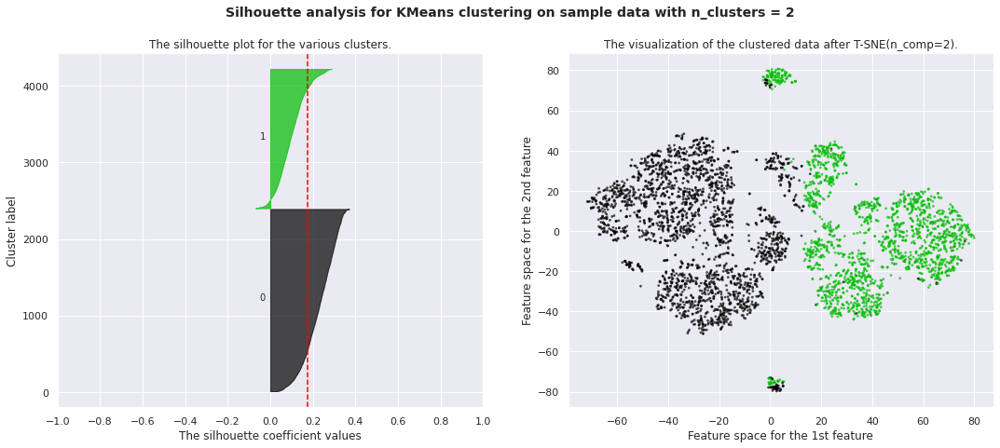

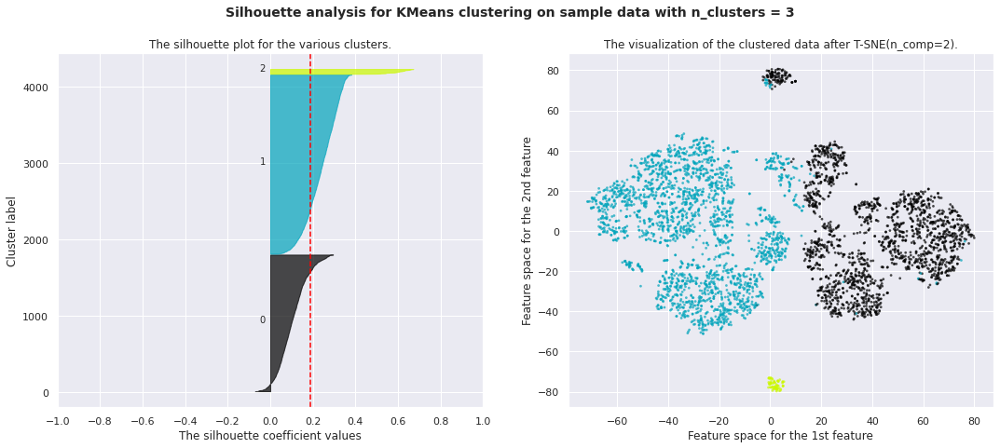

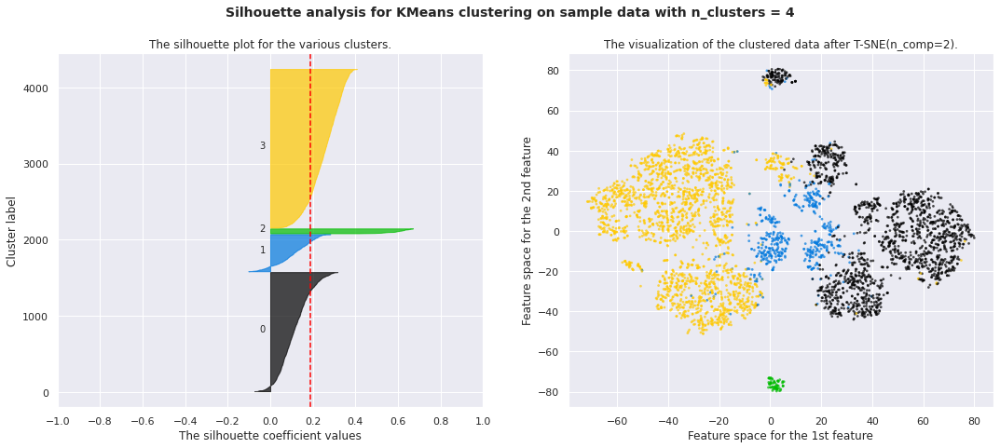

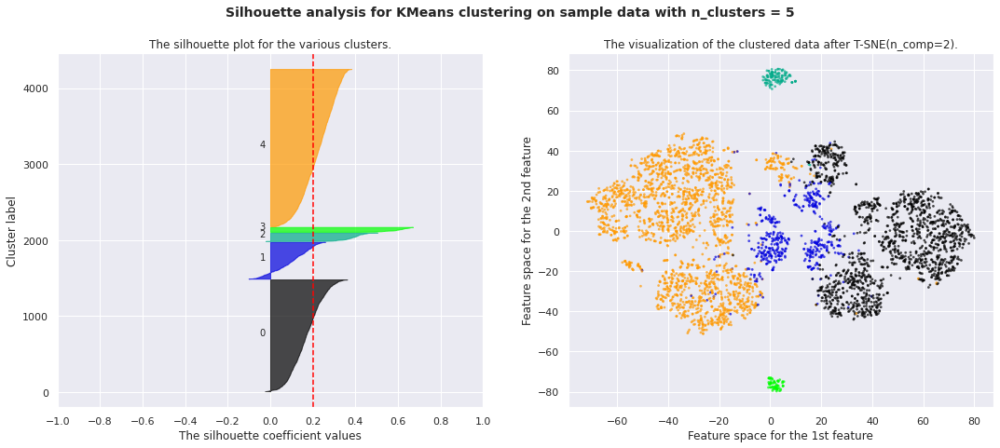

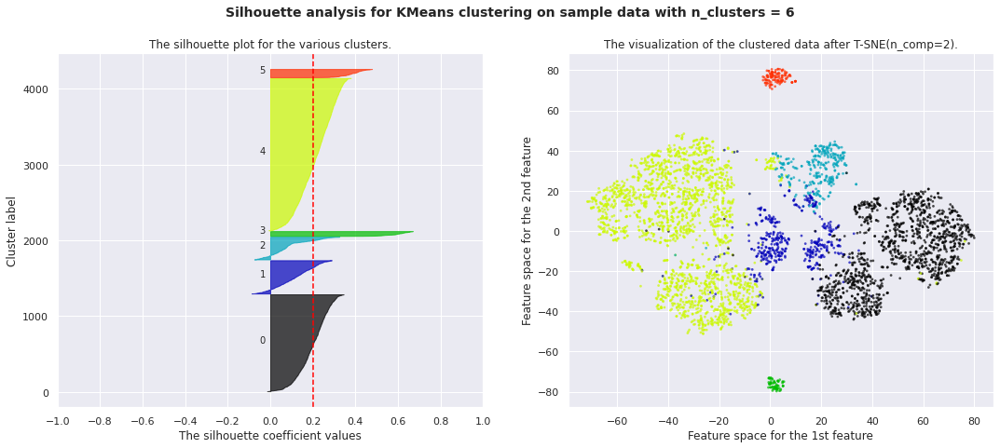

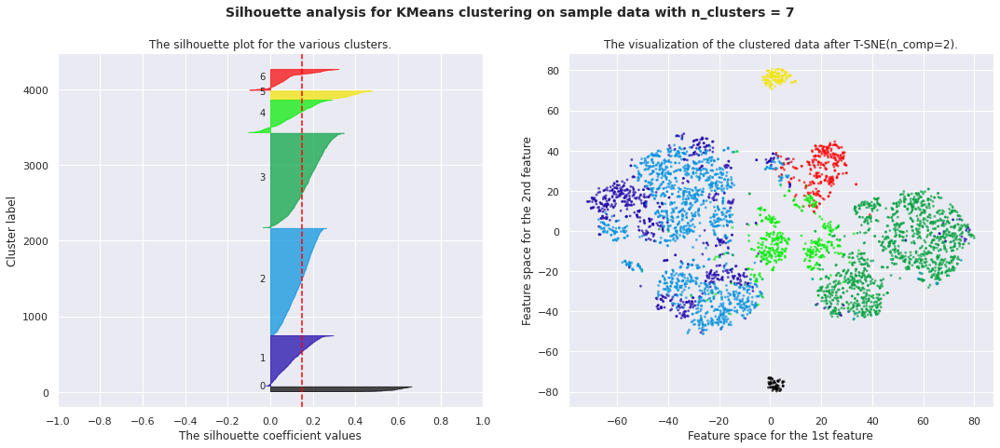

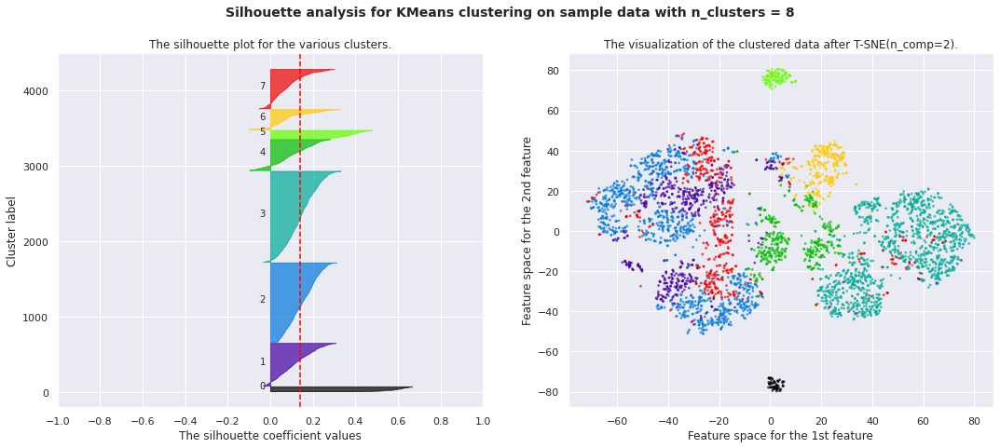

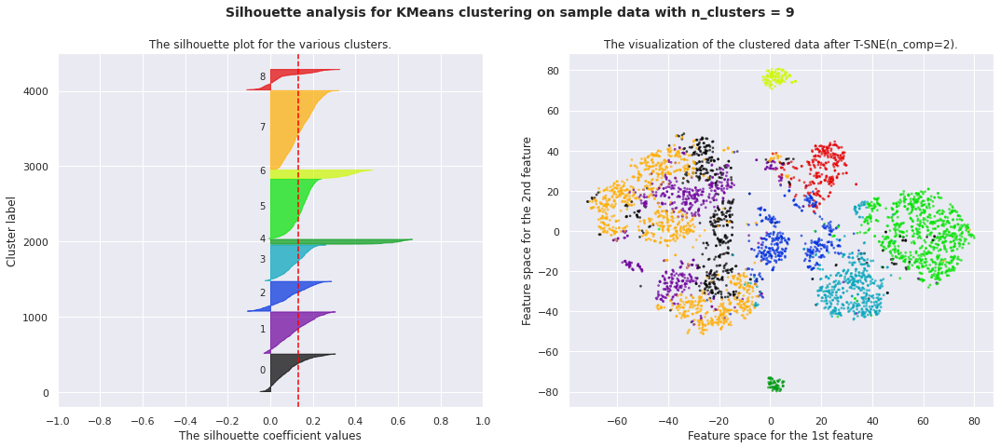

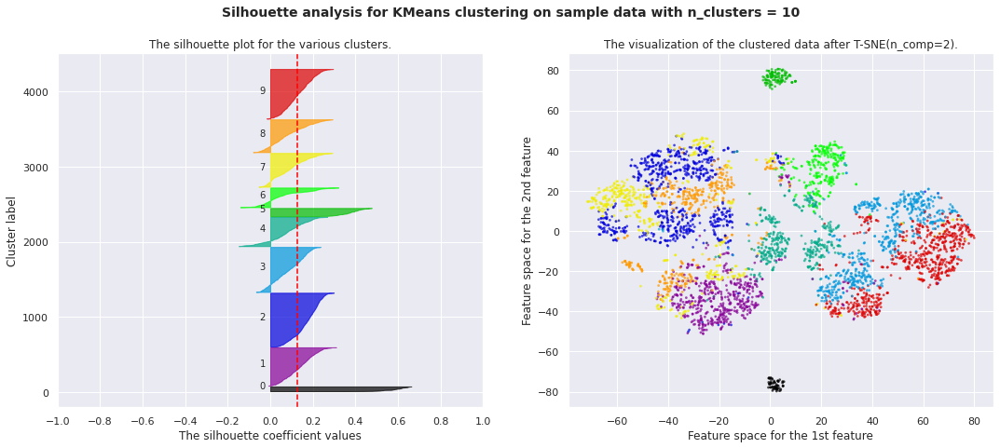

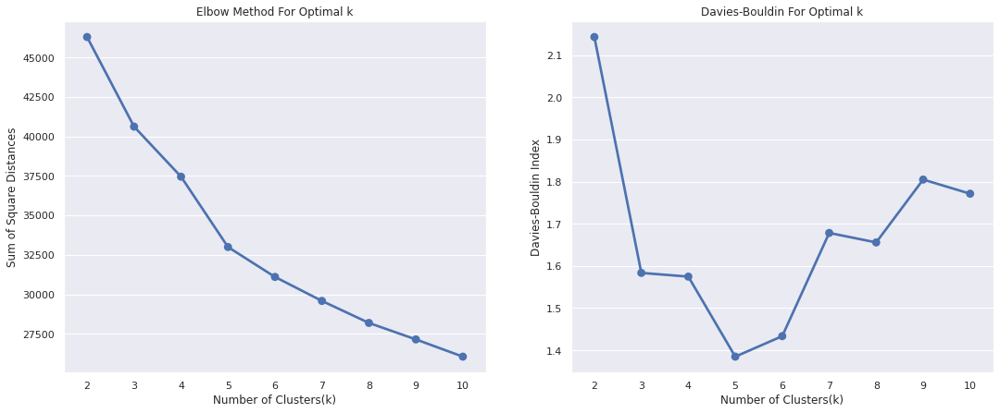

In [ ]:
# plot silhouette, clusters, elbow and davies bouldin for different k-values.
plot_silhouette_project(X_sample1,X_tsne1)

For n_clusters = 2 The average silhouette_score is : 0.1740337476951647
For n_clusters = 3 The average silhouette_score is : 0.18728910912937283
For n_clusters = 4 The average silhouette_score is : 0.189775713886635
For n_clusters = 5 The average silhouette_score is : 0.20059052162471422
For n_clusters = 6 The average silhouette_score is : 0.19954031484472662
For n_clusters = 7 The average silhouette_score is : 0.15063056292236157
For n_clusters = 8 The average silhouette_score is : 0.1383800380315256
For n_clusters = 9 The average silhouette_score is : 0.1317528517060396
For n_clusters = 10 The average silhouette_score is : 0.1268587954212678


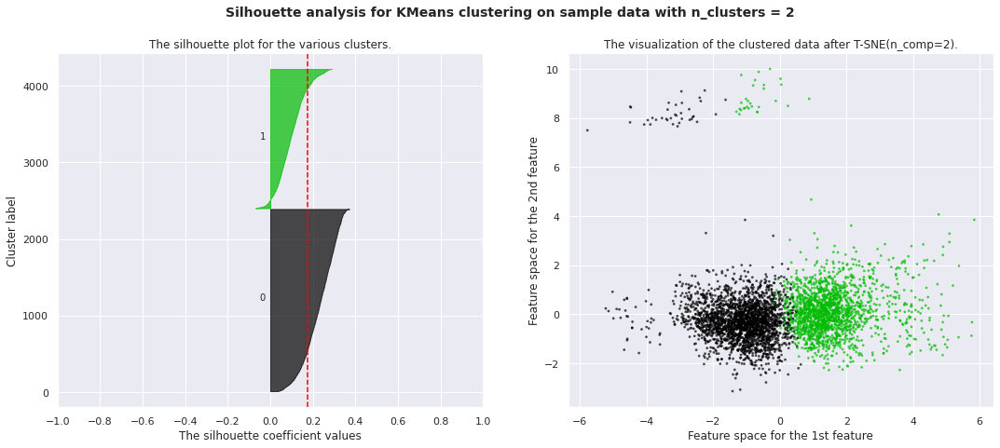

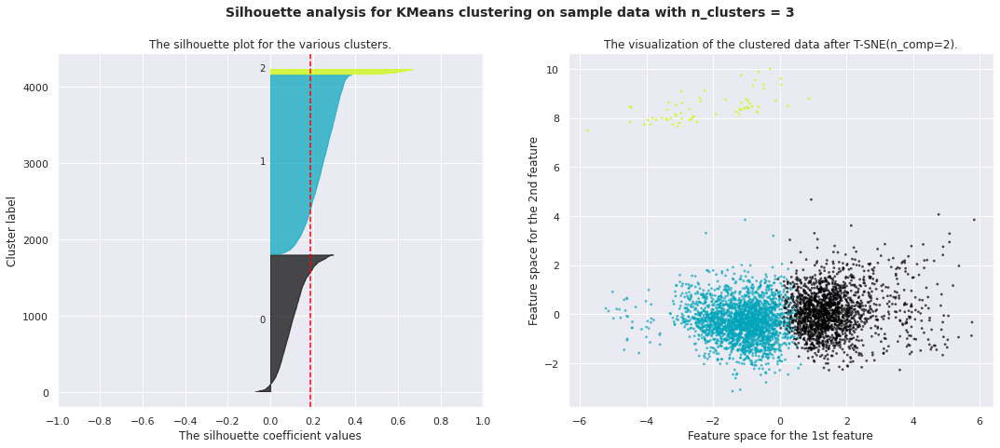

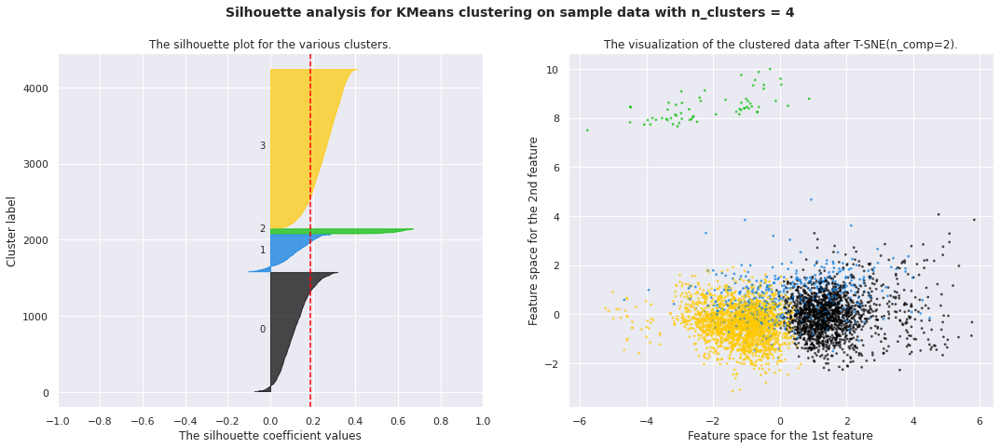

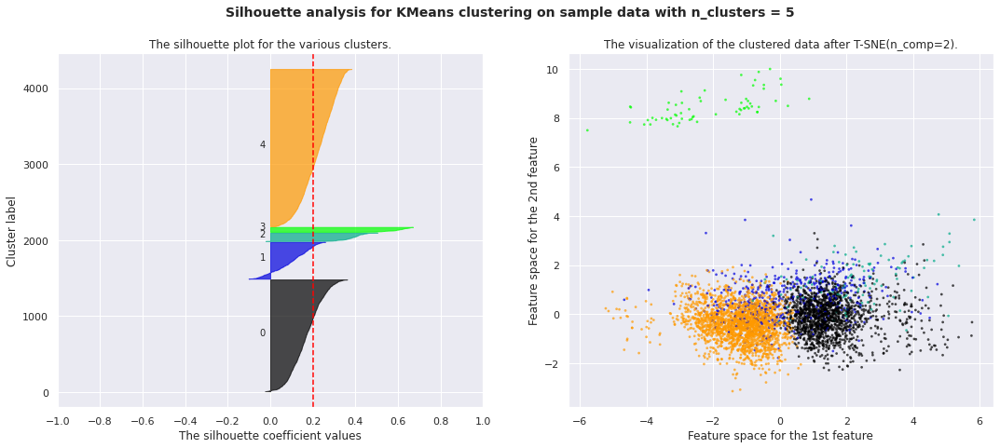

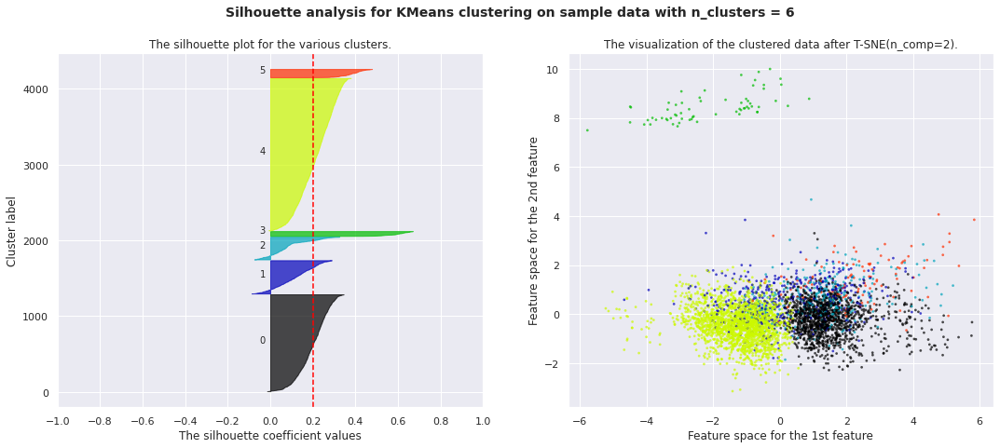

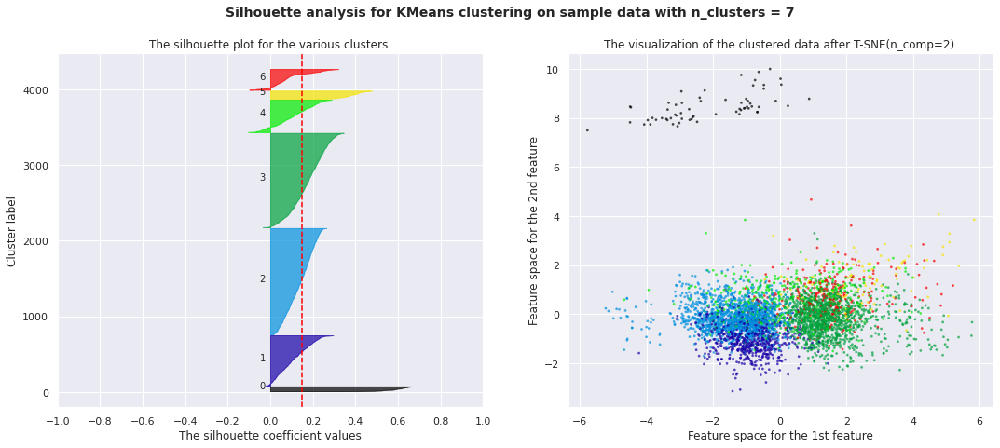

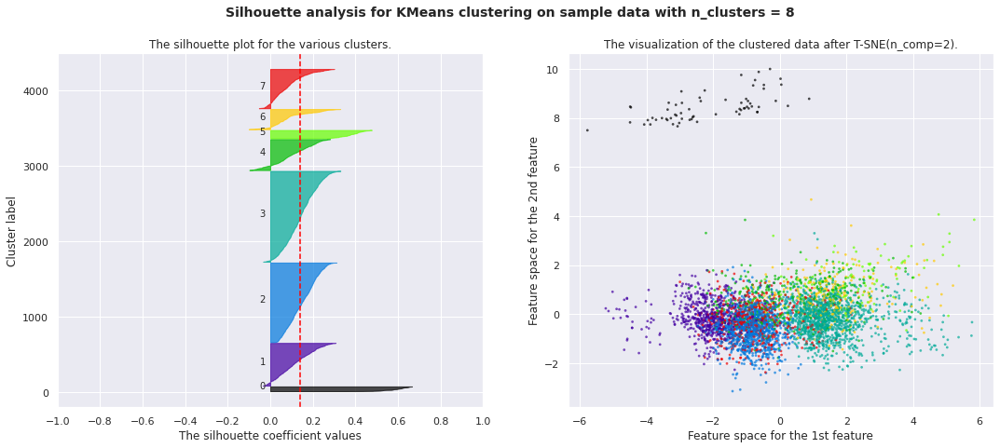

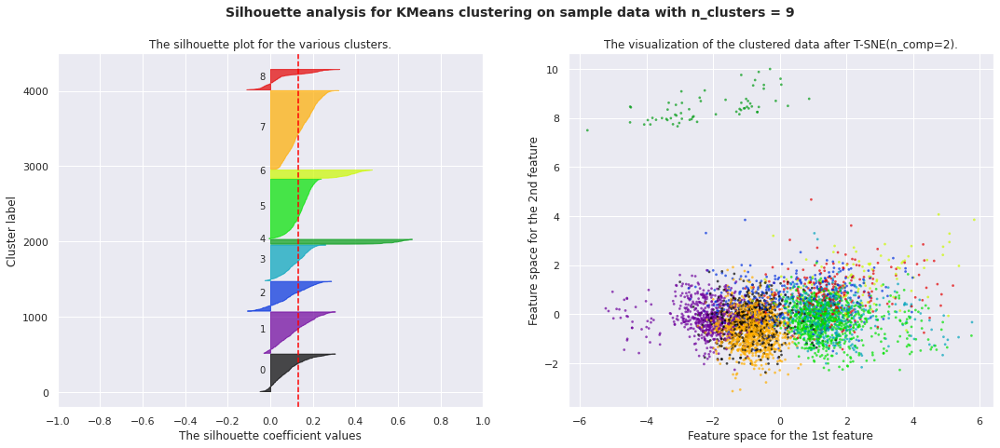

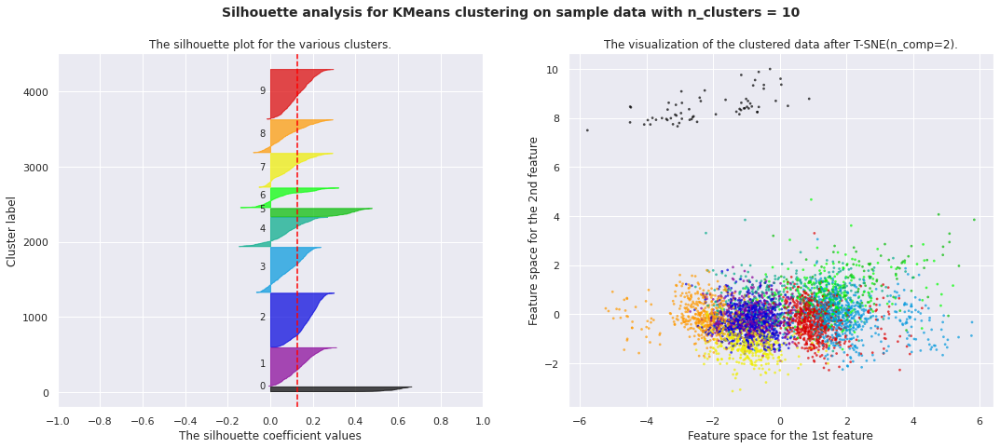

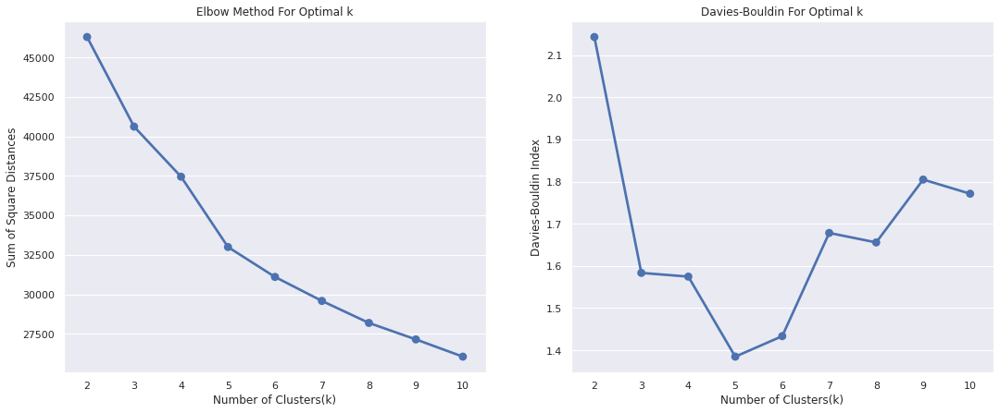

In [ ]:
plot_silhouette_project(X_sample1, X_pca1)

Different observations:
  - clustering is not performng well with all features
  - T-SNE is better for visualization than PCA (more robust to preserve distance from the global space to the reduced one)

From now, I will be using T-SNE only to dislay clusters in 2D.

### Iteration 2

Same features as previoulsy but using QuantileTransformer instead of Log transformation.

In [ ]:
features= ['frequency', 'nb_days_to_deliver',
       'payment_installments', 'review_score', 'title_length',
       'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'monetary_cat']

In [ ]:
pipeline2 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                         ('std_scaler', StandardScaler())
])

In [ ]:
X_sample2 = pipeline2.fit_transform(strat_test_set)

In [ ]:
X_tsne2 = TSNE(n_components=2).fit_transform(X_sample2)

For n_clusters = 2 The average silhouette_score is : 0.17639506361556248
For n_clusters = 3 The average silhouette_score is : 0.18871312983271096
For n_clusters = 4 The average silhouette_score is : 0.19485161379894342
For n_clusters = 5 The average silhouette_score is : 0.14318427038524606
For n_clusters = 6 The average silhouette_score is : 0.11798805077894135
For n_clusters = 7 The average silhouette_score is : 0.11162272810245627
For n_clusters = 8 The average silhouette_score is : 0.10907956493388951
For n_clusters = 9 The average silhouette_score is : 0.10434494229645275
For n_clusters = 10 The average silhouette_score is : 0.10716404319138648


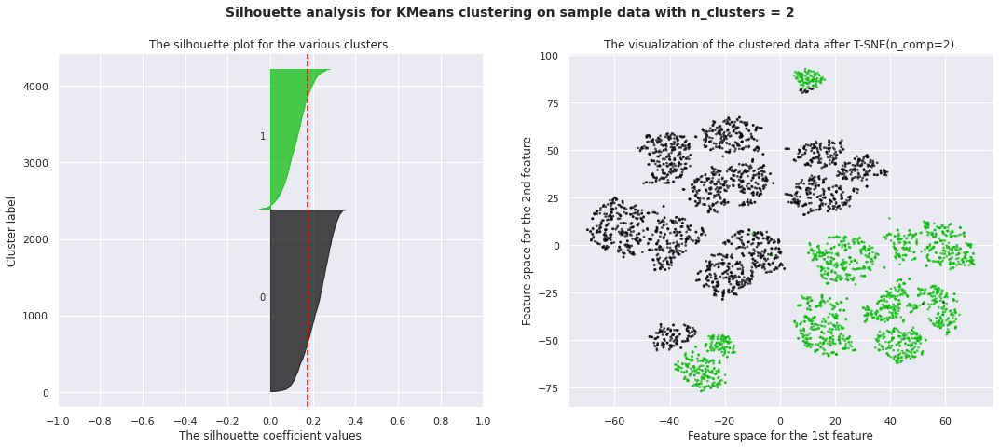

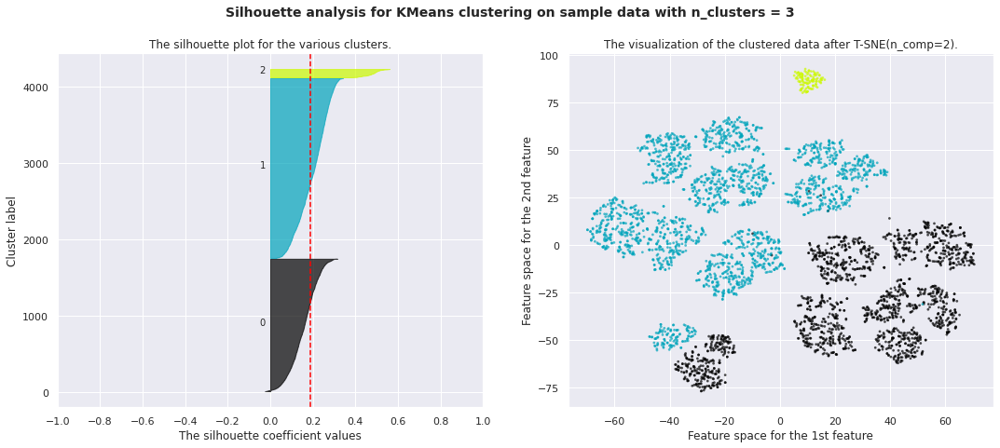

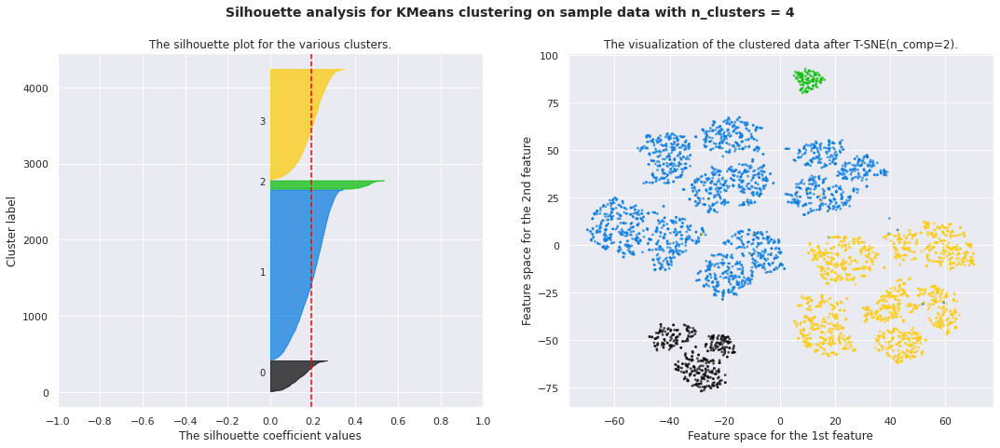

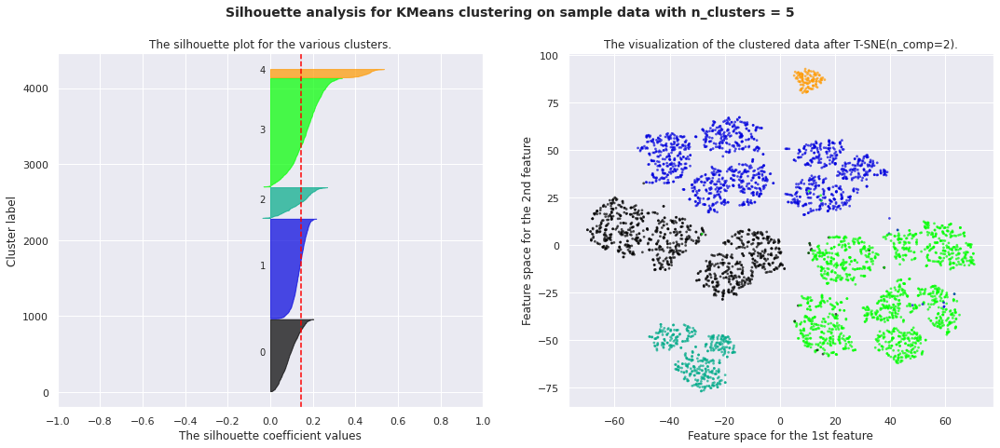

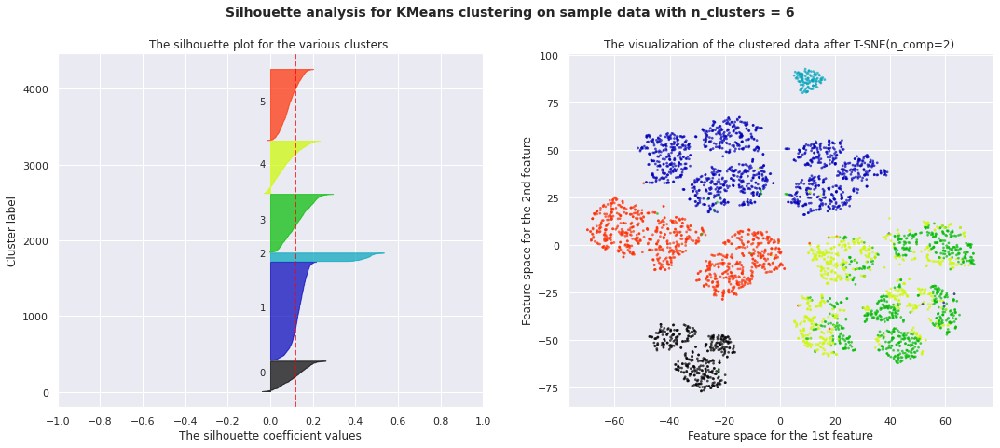

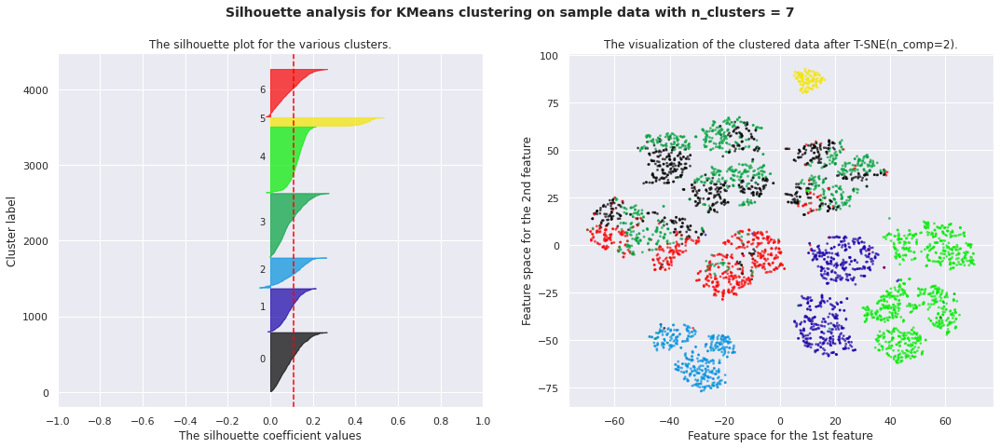

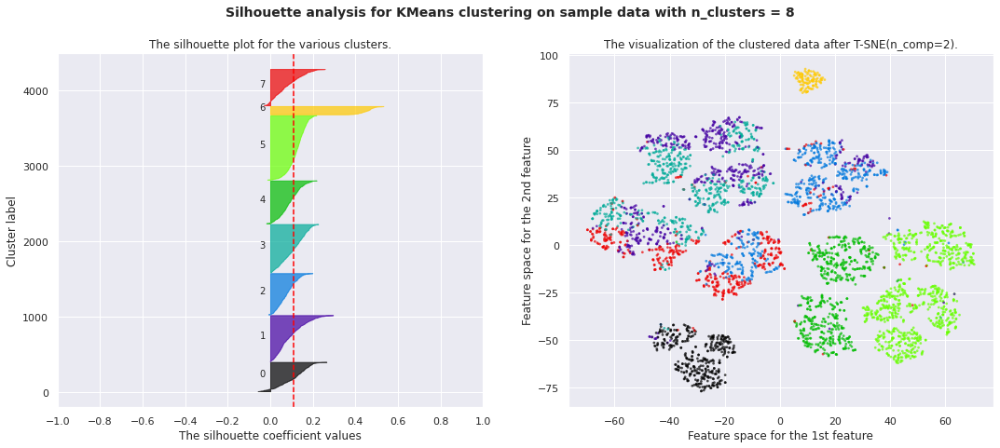

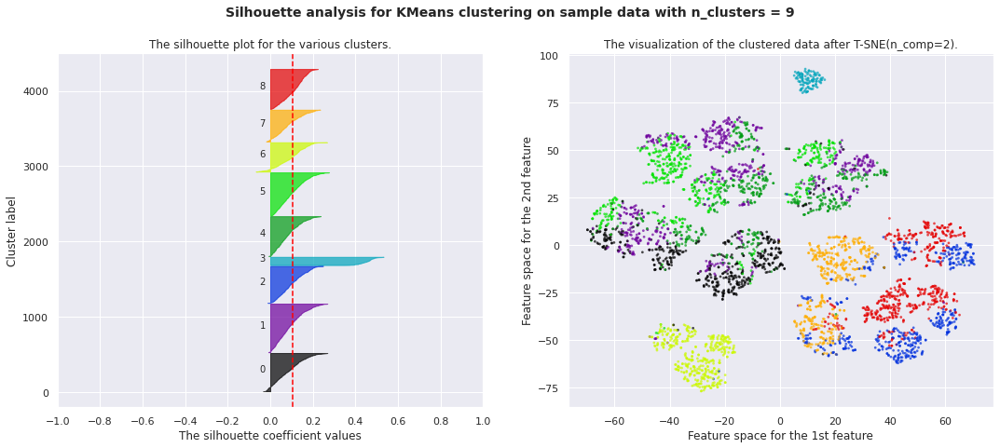

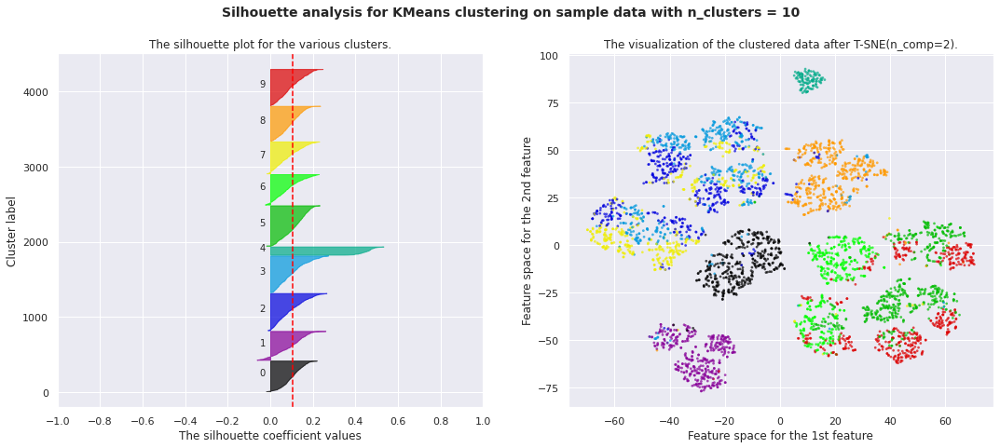

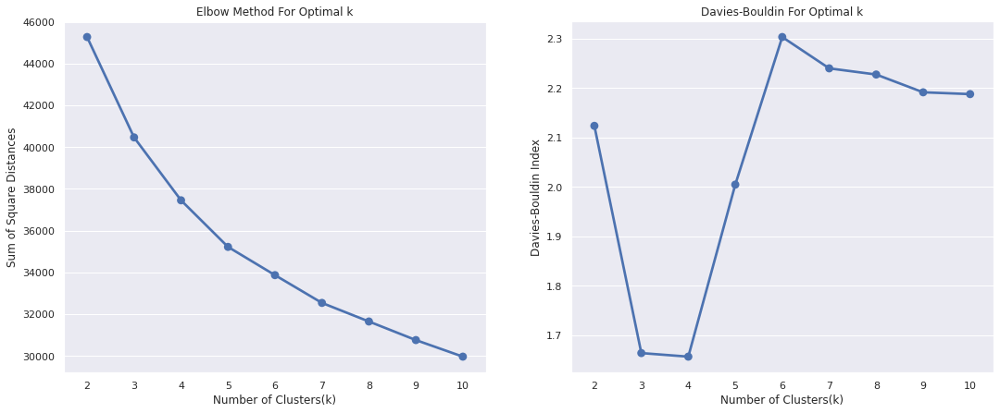

In [ ]:
plot_silhouette_project(X_sample2, X_tsne2)

### Iteration 3

As the clustering is not satisfying with all features, I will first reduce the features to RFM and add progressively features in the next iterations.


In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary']

In [ ]:
pipeline3 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                        #  ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                         ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

In [ ]:
X_sample3 = pipeline3.fit_transform(strat_test_set)

In [ ]:
X_tsne3 = TSNE(n_components=2).fit_transform(X_sample3)

For n_clusters = 2 The average silhouette_score is : 0.7289543646942171
For n_clusters = 3 The average silhouette_score is : 0.38709312165482945
For n_clusters = 4 The average silhouette_score is : 0.3862579799765745
For n_clusters = 5 The average silhouette_score is : 0.35892746518518615
For n_clusters = 6 The average silhouette_score is : 0.36697218852908214
For n_clusters = 7 The average silhouette_score is : 0.3782116090878854
For n_clusters = 8 The average silhouette_score is : 0.3783805238227474
For n_clusters = 9 The average silhouette_score is : 0.35378361369015443
For n_clusters = 10 The average silhouette_score is : 0.35608920814937106


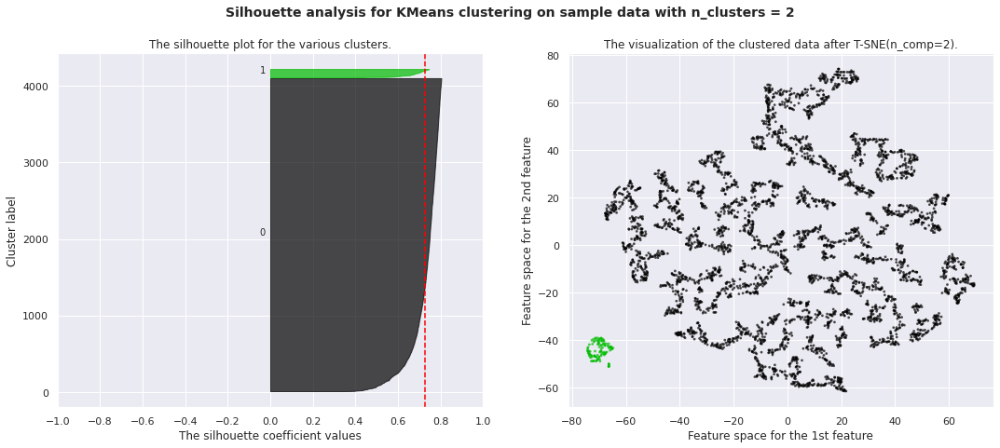

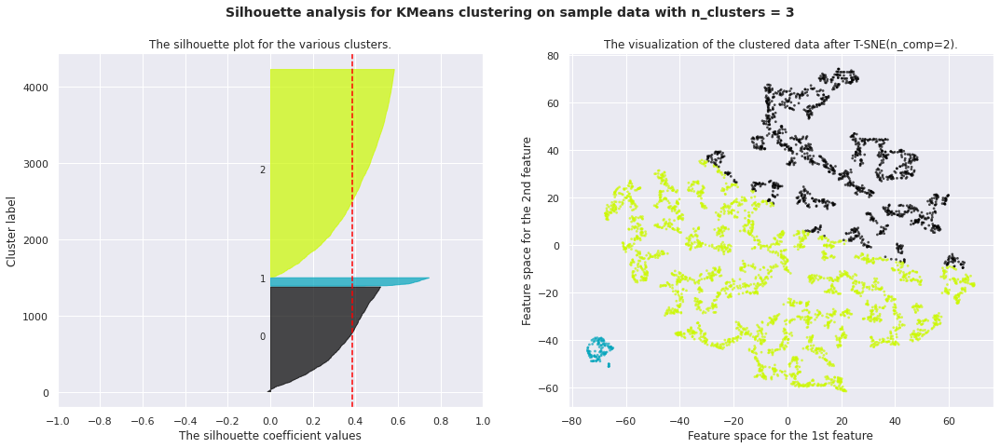

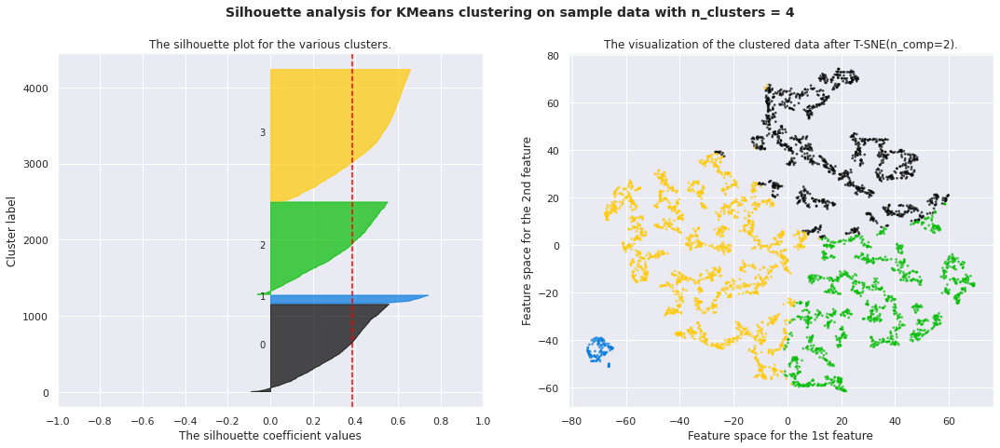

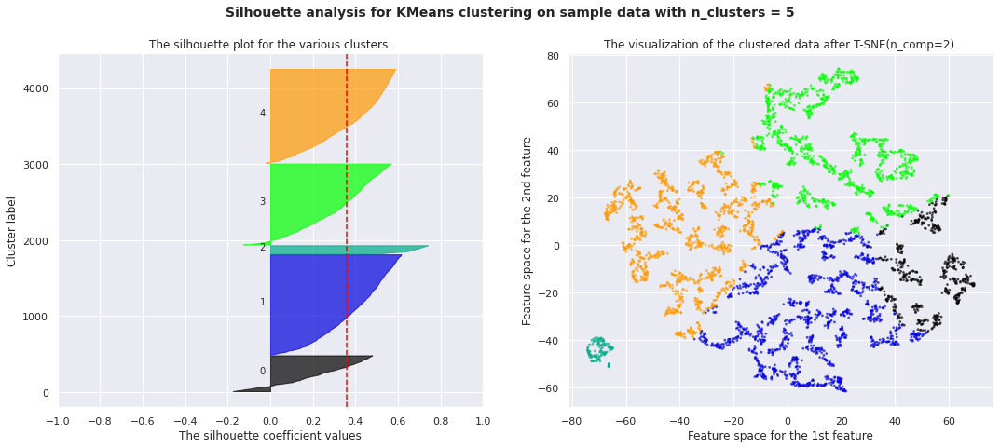

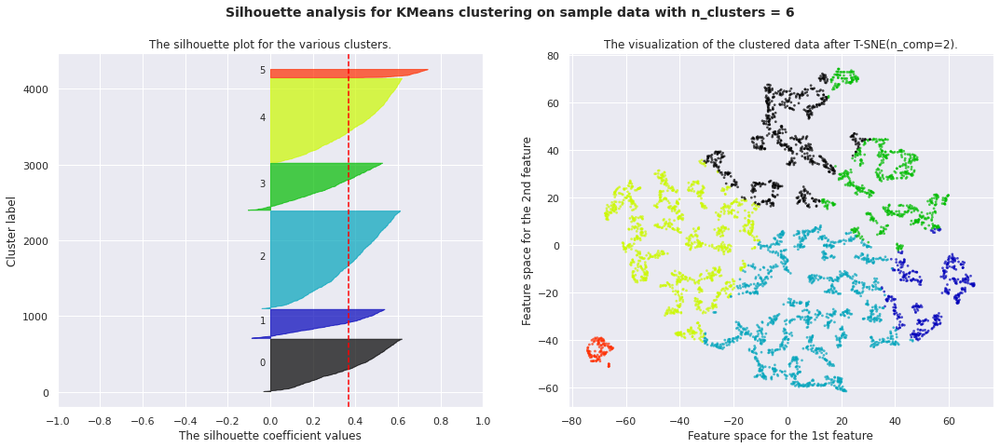

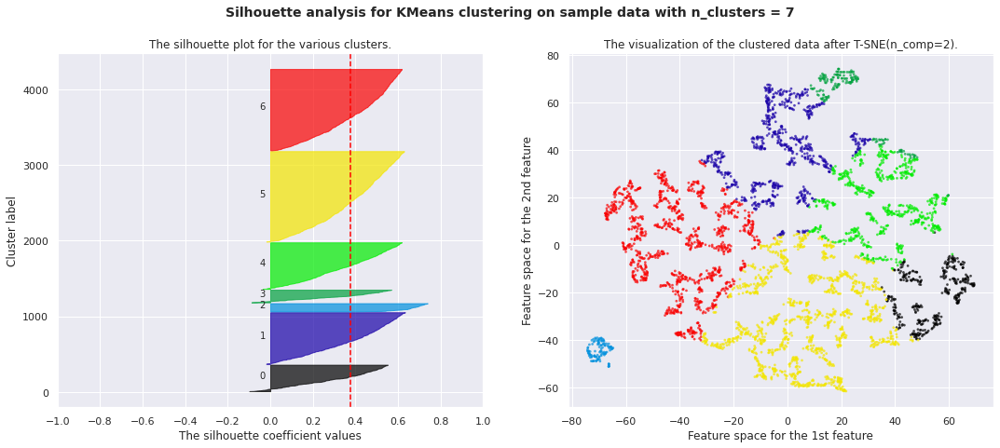

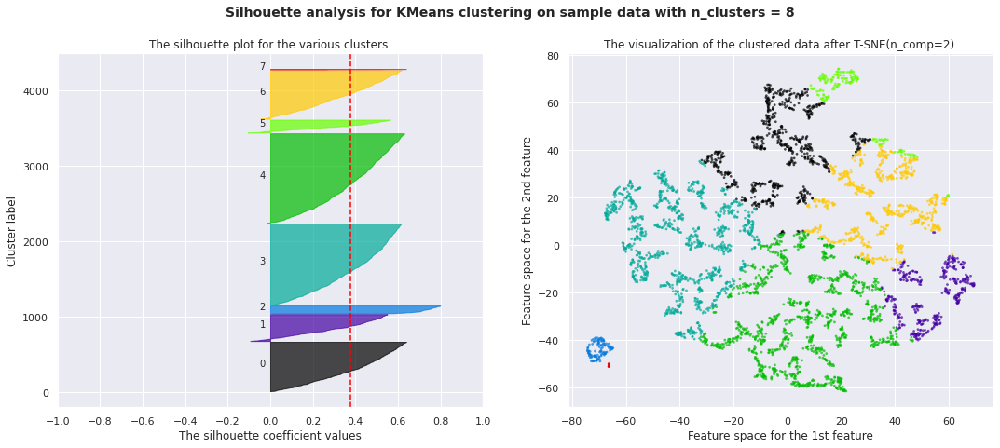

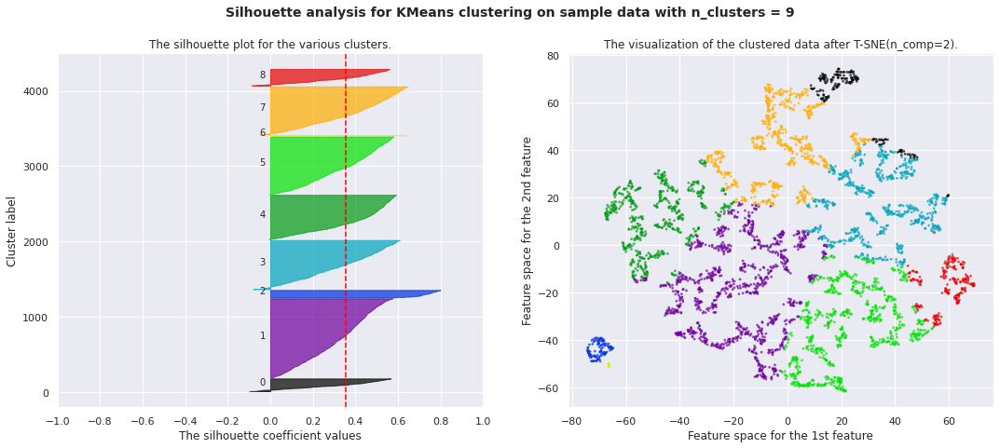

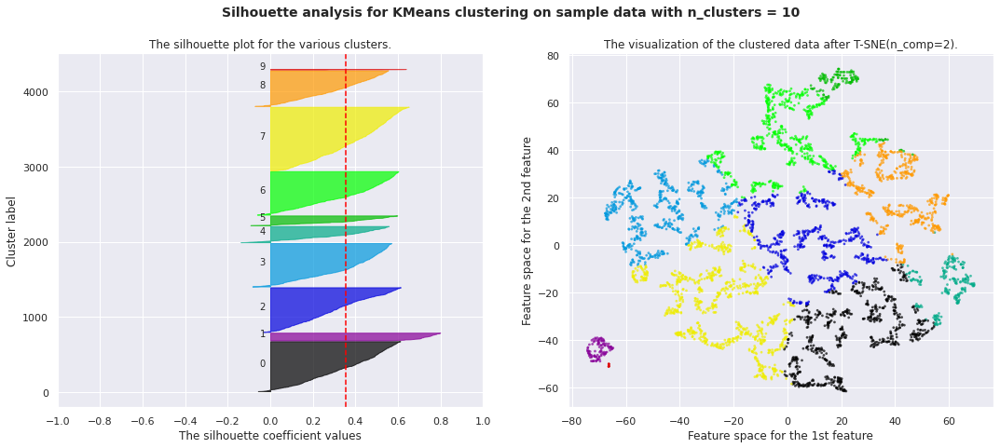

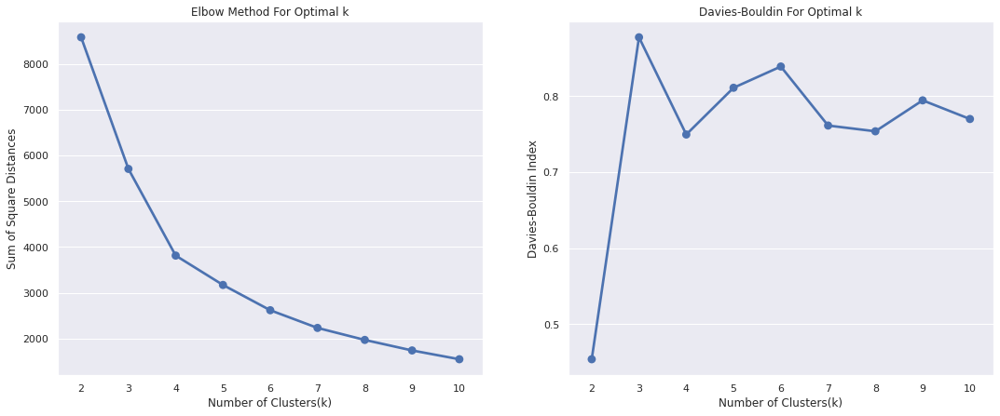

In [ ]:
plot_silhouette_project(X_sample3, X_tsne3)

The clustering is better with these RFM features. 

  - 4 is the optimal number of clusters
  - silhouette score is 0.35

### Iteration 4

Same as iteration 3 but using QuantileTransformer



In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary']

In [ ]:
pipeline4 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                        #  ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

In [ ]:
X_sample4 = pipeline4.fit_transform(strat_test_set)

In [ ]:
X_tsne4 = TSNE(n_components=2).fit_transform(X_sample4)

For n_clusters = 2 The average silhouette_score is : 0.7285228893228528
For n_clusters = 3 The average silhouette_score is : 0.36627520374391775
For n_clusters = 4 The average silhouette_score is : 0.38962053375728944
For n_clusters = 5 The average silhouette_score is : 0.41512038671743007
For n_clusters = 6 The average silhouette_score is : 0.391536658257254
For n_clusters = 7 The average silhouette_score is : 0.3827861819329895
For n_clusters = 8 The average silhouette_score is : 0.3666134964308032
For n_clusters = 9 The average silhouette_score is : 0.3793061831492718
For n_clusters = 10 The average silhouette_score is : 0.38065813853457864


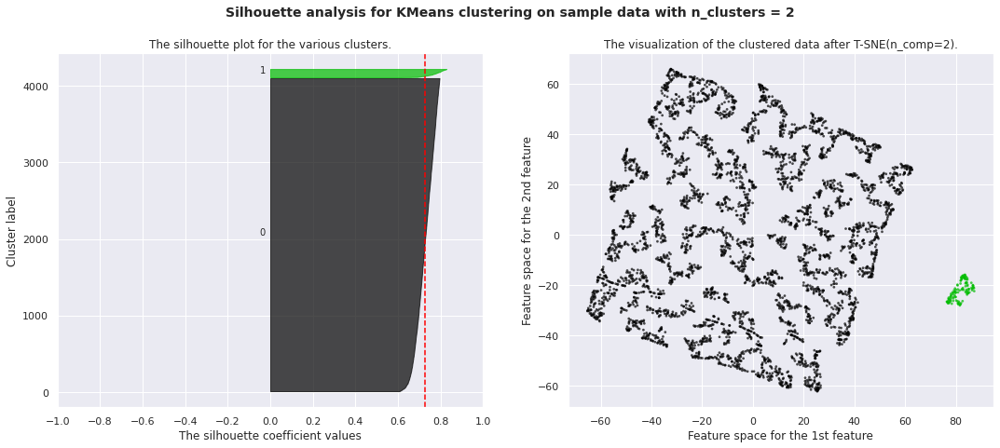

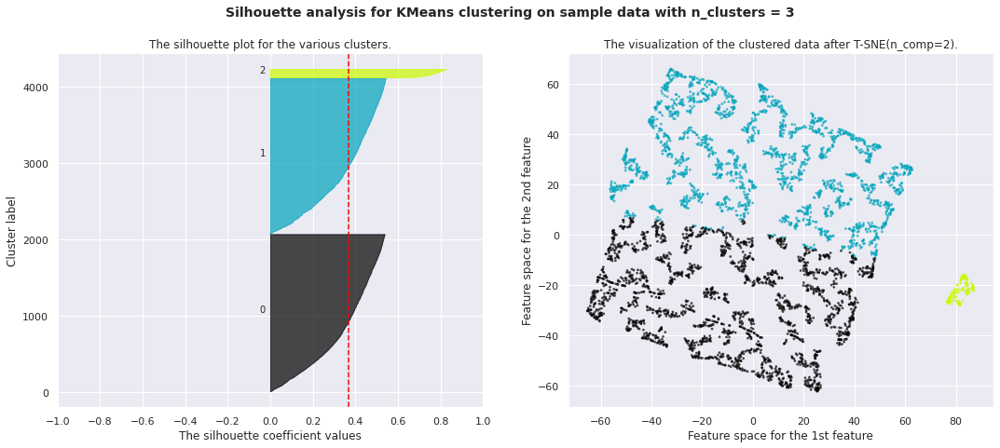

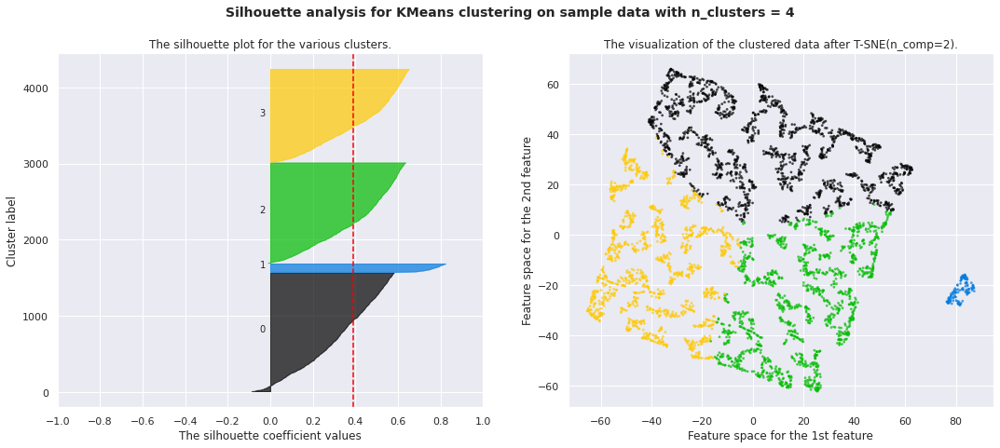

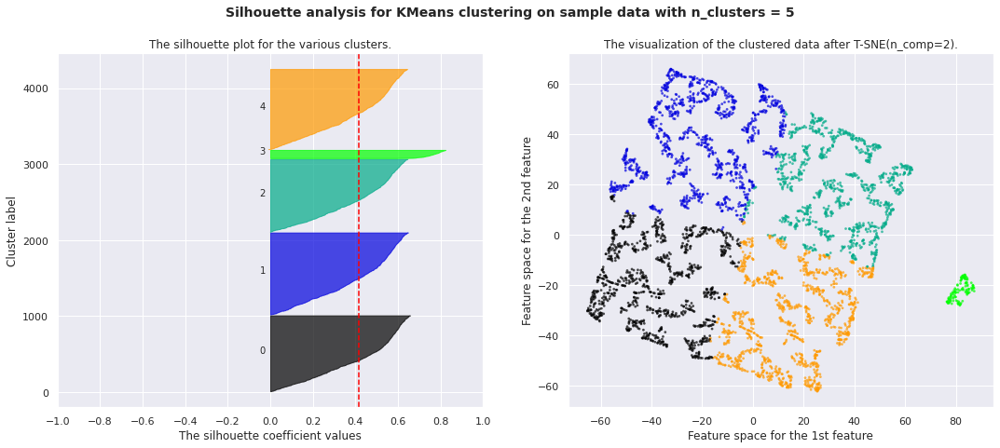

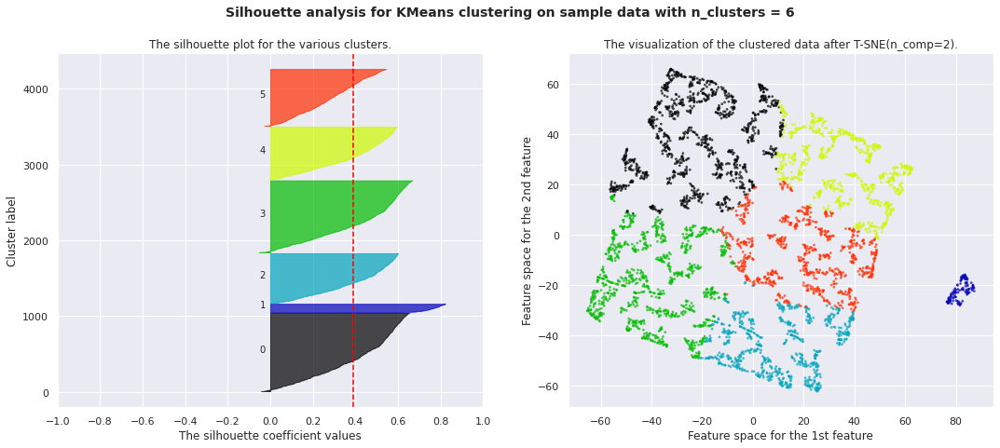

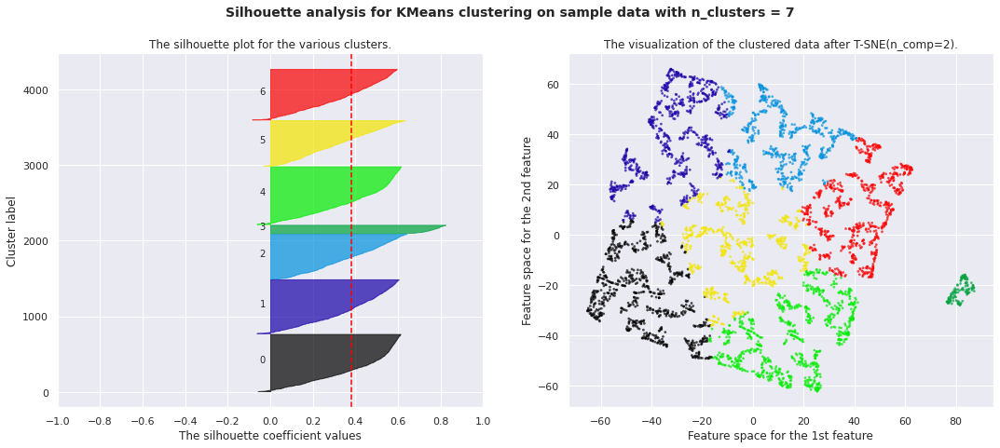

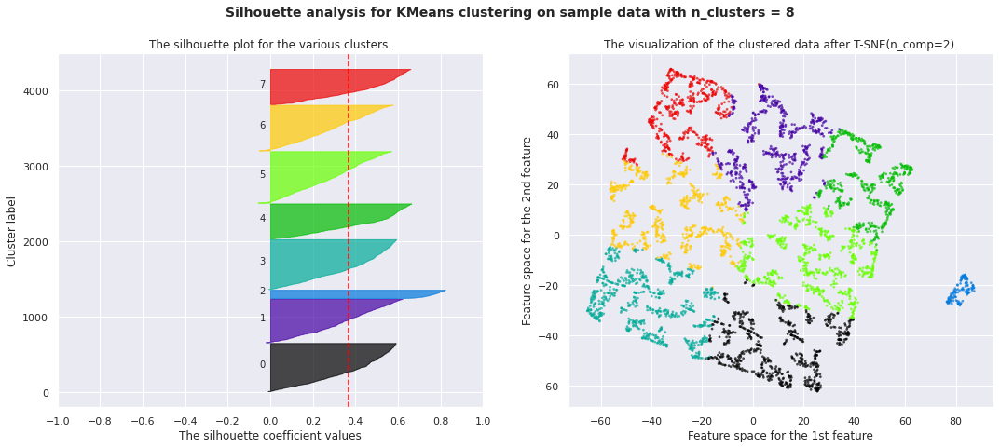

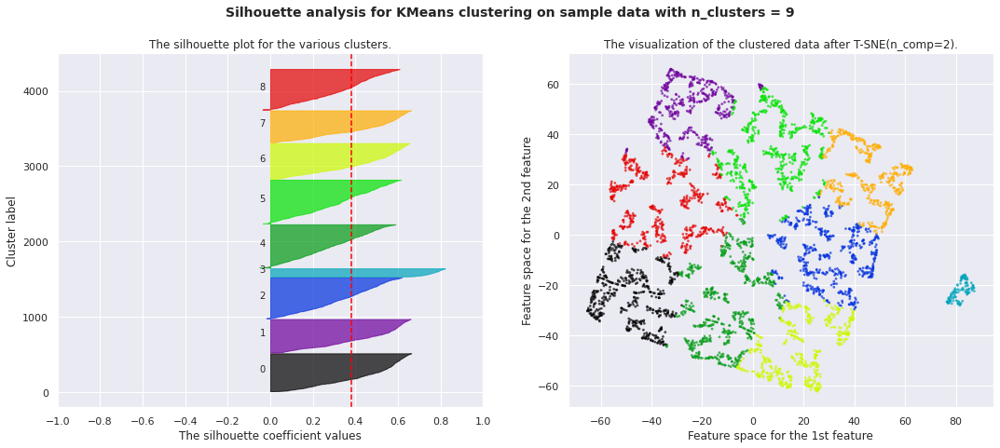

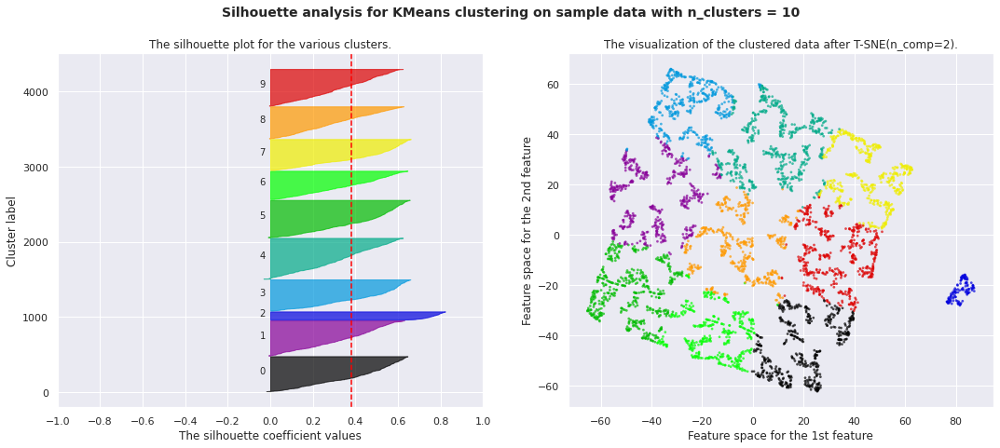

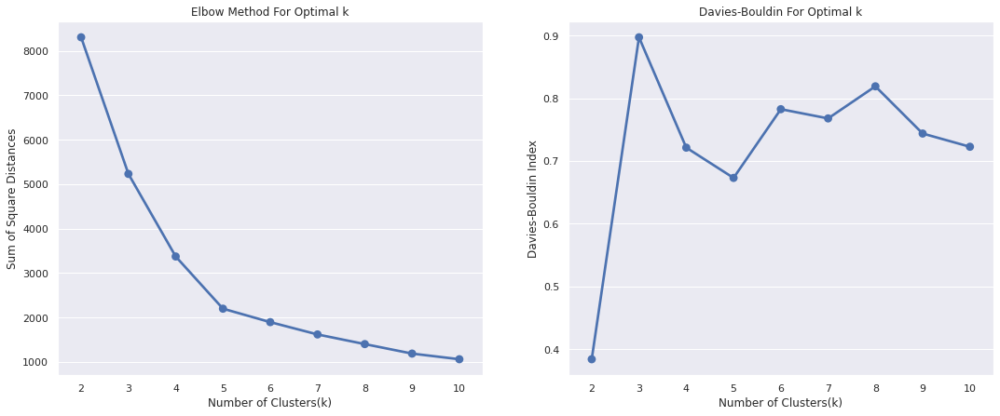

In [ ]:
plot_silhouette_project(X_sample4, X_tsne4)

### Iteration 5



1.   Reduce number of feature to RFM + payment_installments
2.   Log + Std scaler



In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary', 'payment_installments']

In [ ]:
pipeline5 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                        #  ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                         ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

In [ ]:
X_sample5 = pipeline5.fit_transform(strat_test_set)

In [ ]:
X_tsne5 = TSNE(n_components=2).fit_transform(X_sample5)

For n_clusters = 2 The average silhouette_score is : 0.317690701931795
For n_clusters = 3 The average silhouette_score is : 0.3306895855774773
For n_clusters = 4 The average silhouette_score is : 0.3259516020872892
For n_clusters = 5 The average silhouette_score is : 0.2909622863272333
For n_clusters = 6 The average silhouette_score is : 0.29940407601359403
For n_clusters = 7 The average silhouette_score is : 0.3035629719917201
For n_clusters = 8 The average silhouette_score is : 0.3012933508337745
For n_clusters = 9 The average silhouette_score is : 0.2860704610213778
For n_clusters = 10 The average silhouette_score is : 0.2937494346897449


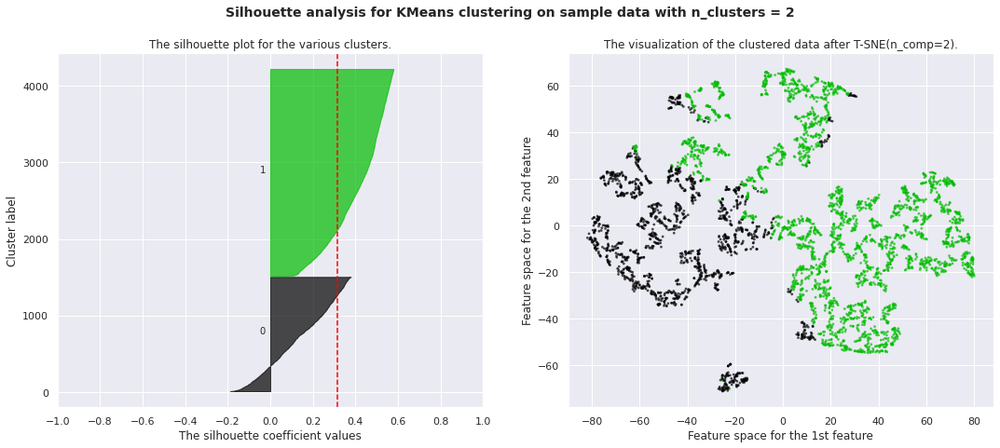

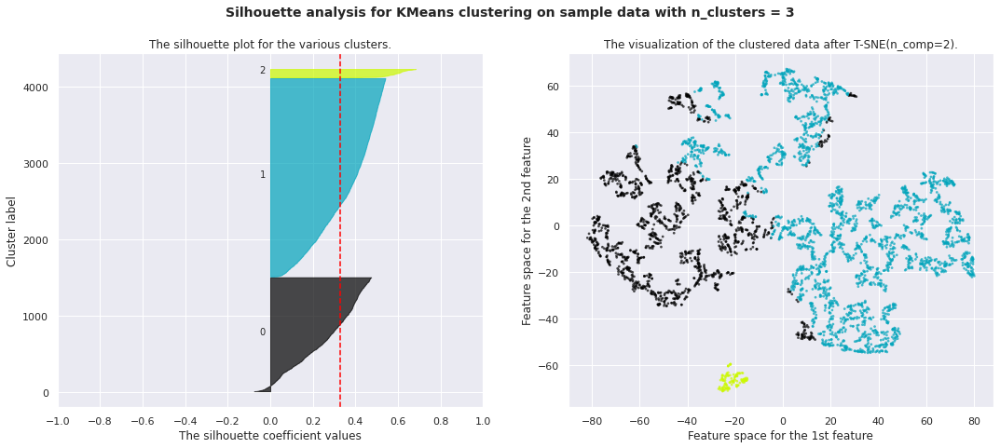

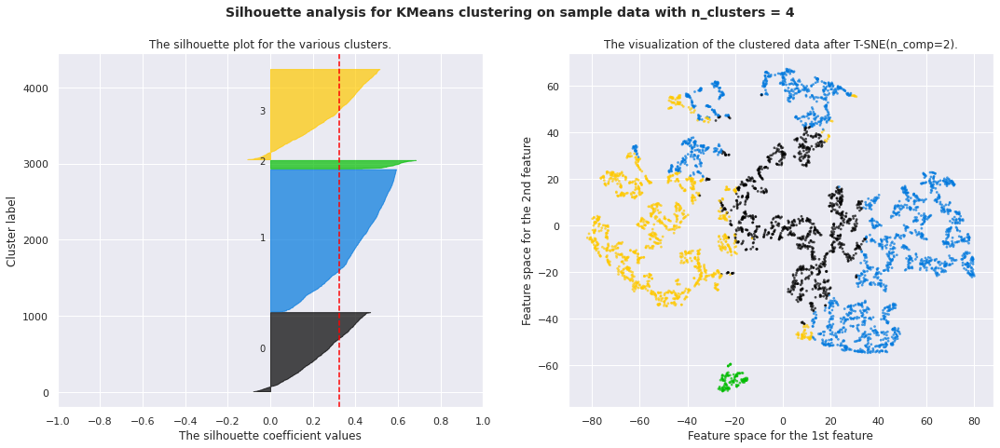

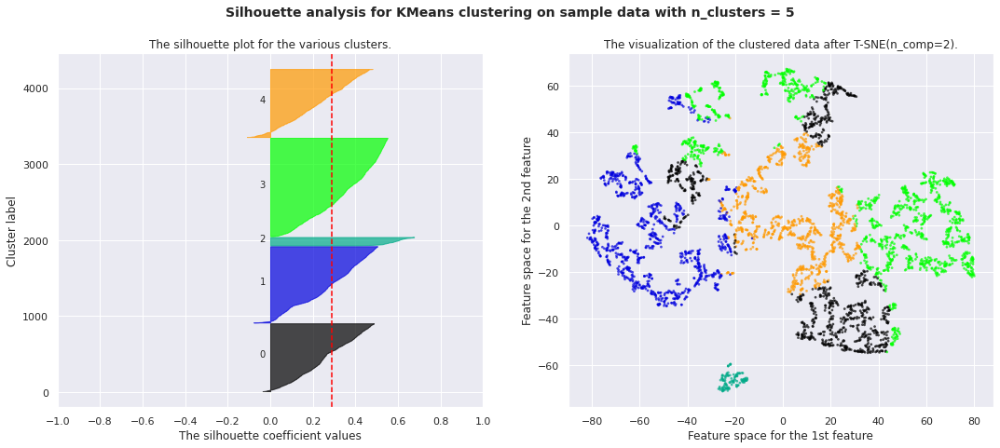

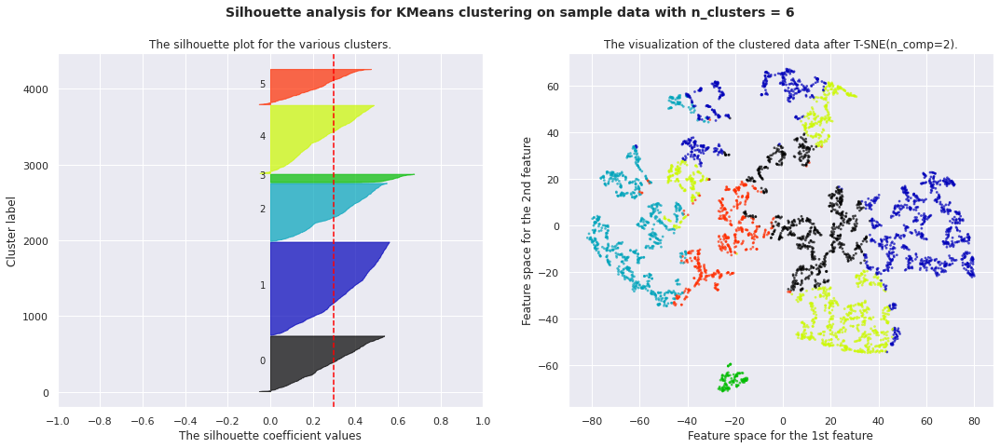

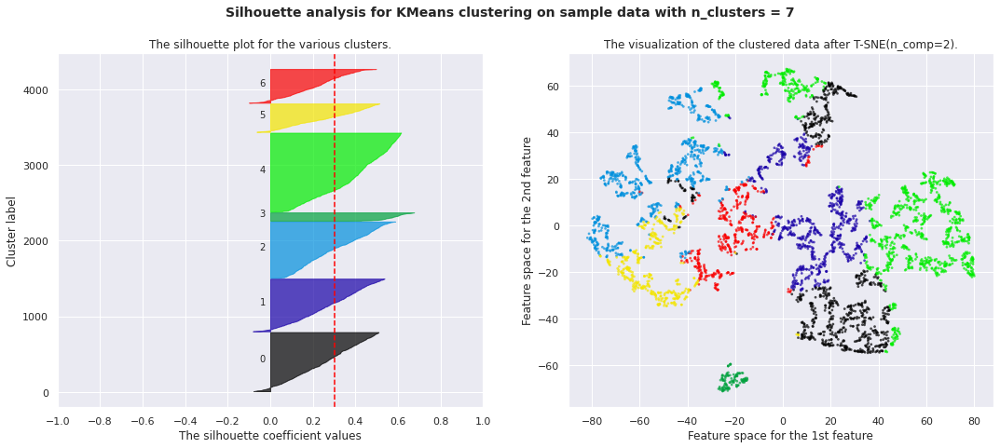

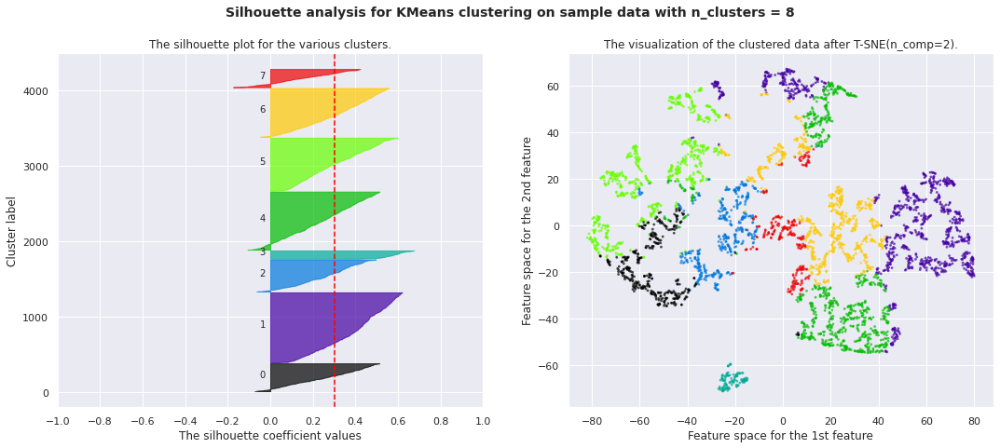

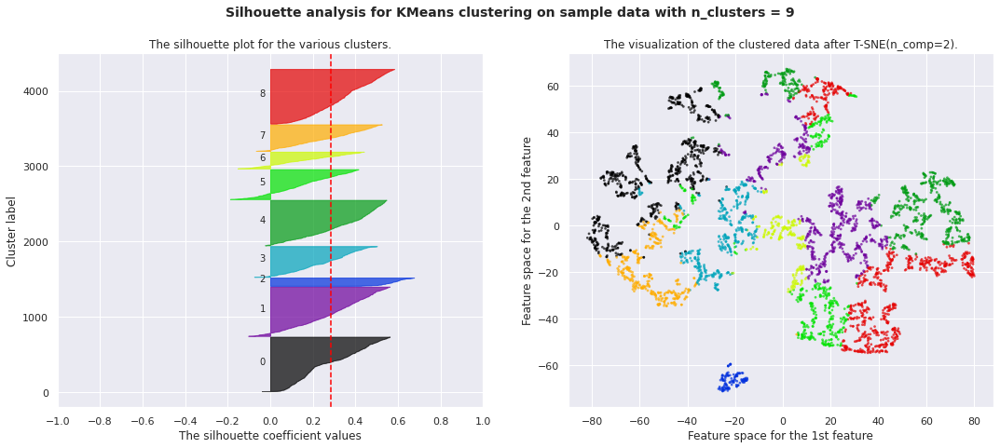

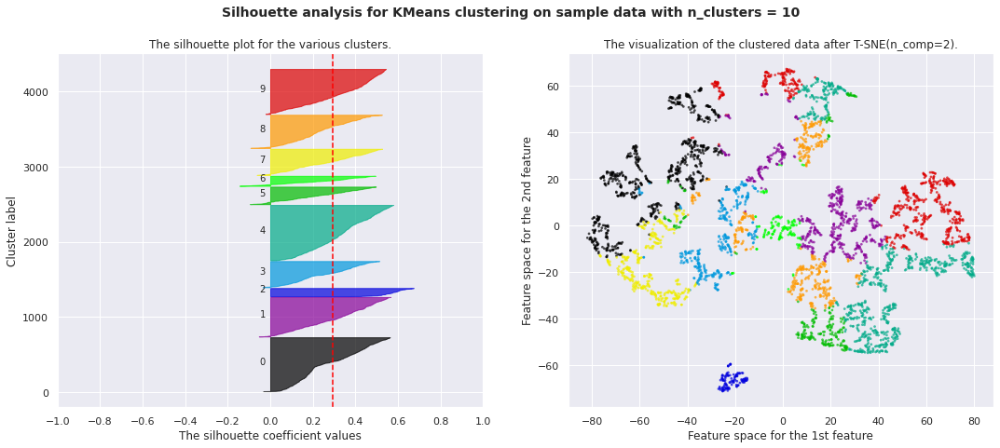

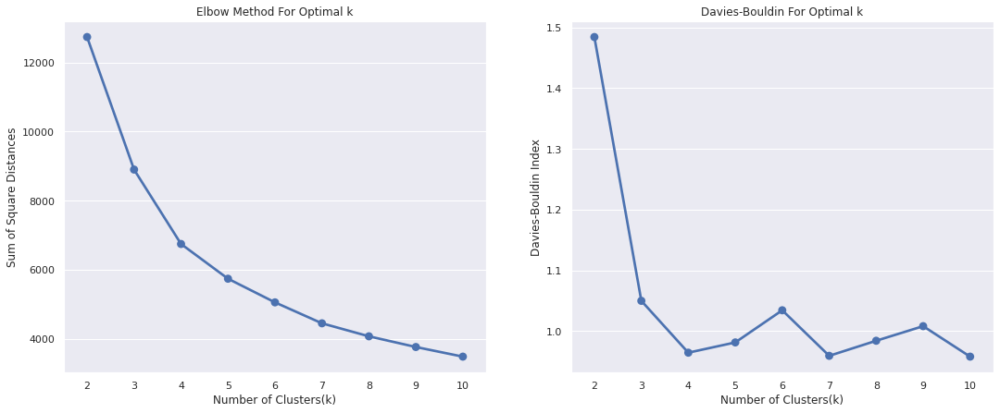

In [ ]:
plot_silhouette_project(X_sample5, X_tsne5)

### Iteration 6



1.   Reduce number of feature to RFM + payment_installments
2.   Quantile + Std scaler



In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary', 'payment_installments']

In [ ]:
pipeline6 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                        #  ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

In [ ]:
X_sample6 = pipeline6.fit_transform(strat_test_set)

In [ ]:
X_tsne6 = TSNE(n_components=2).fit_transform(X_sample6)

For n_clusters = 2 The average silhouette_score is : 0.6634848163260966
For n_clusters = 3 The average silhouette_score is : 0.3326944173237632
For n_clusters = 4 The average silhouette_score is : 0.3061560435193275
For n_clusters = 5 The average silhouette_score is : 0.32483714532410846
For n_clusters = 6 The average silhouette_score is : 0.3391498240336782
For n_clusters = 7 The average silhouette_score is : 0.3653446731206246
For n_clusters = 8 The average silhouette_score is : 0.3666733582257095
For n_clusters = 9 The average silhouette_score is : 0.3670001381303336
For n_clusters = 10 The average silhouette_score is : 0.35240048856226647


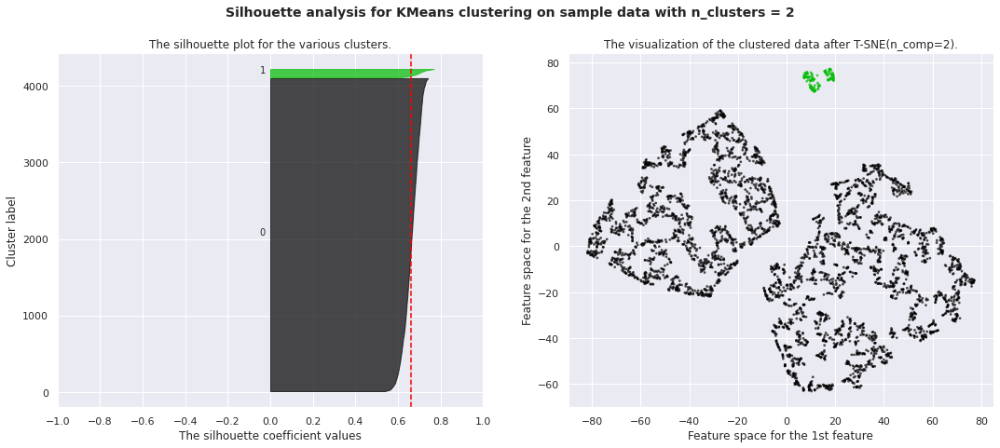

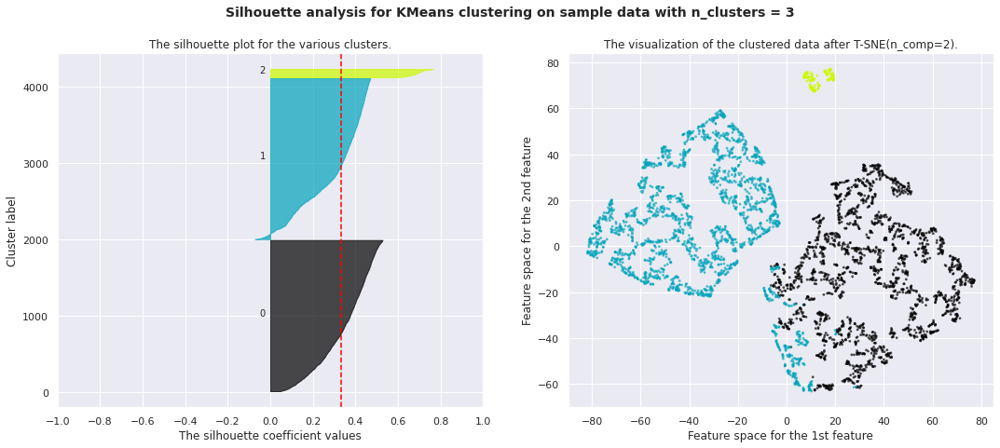

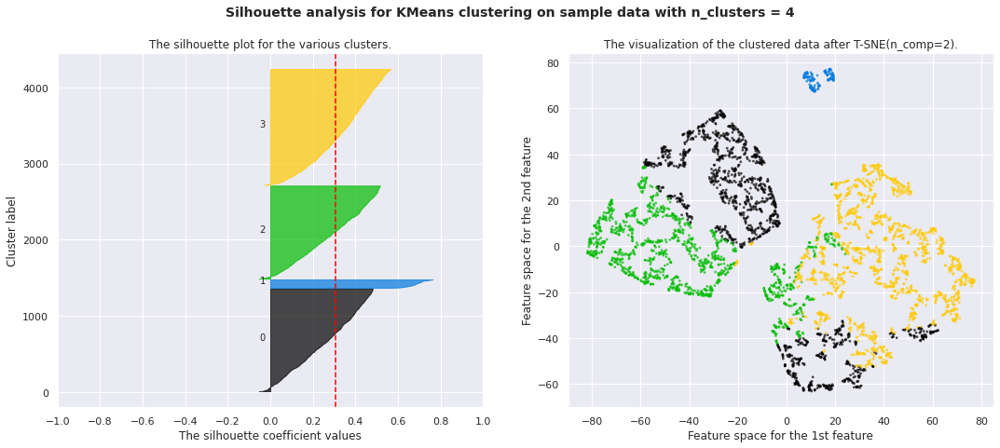

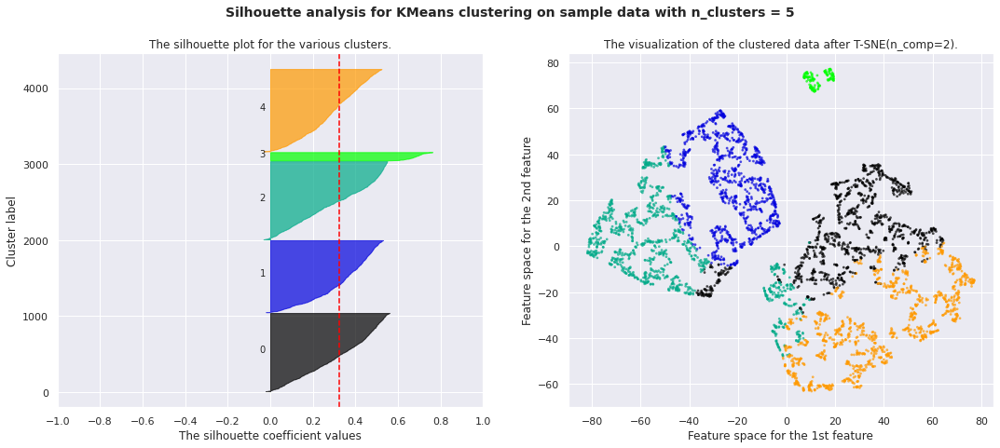

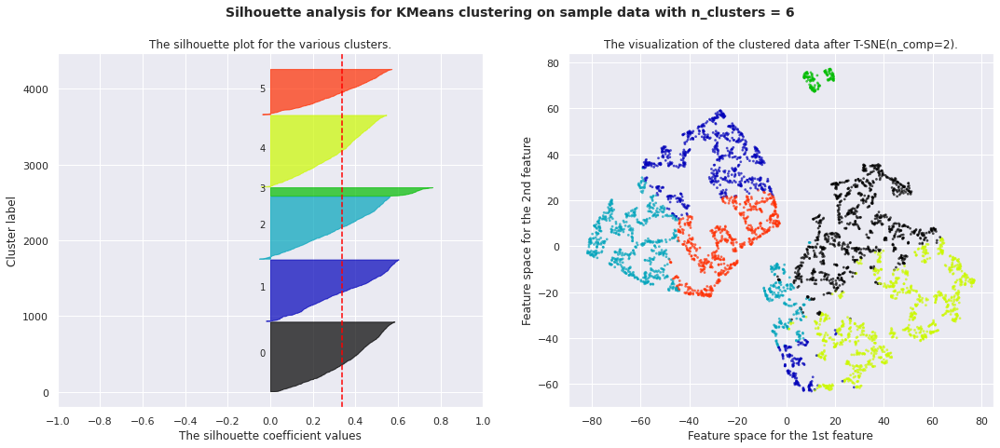

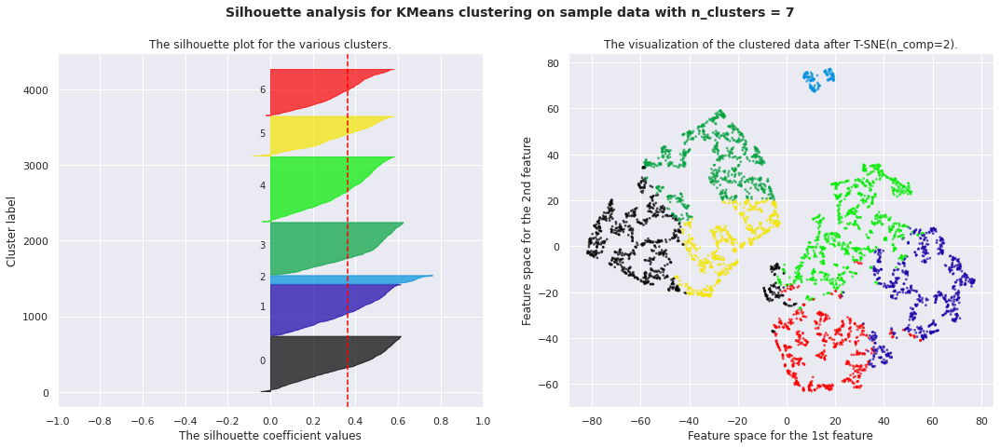

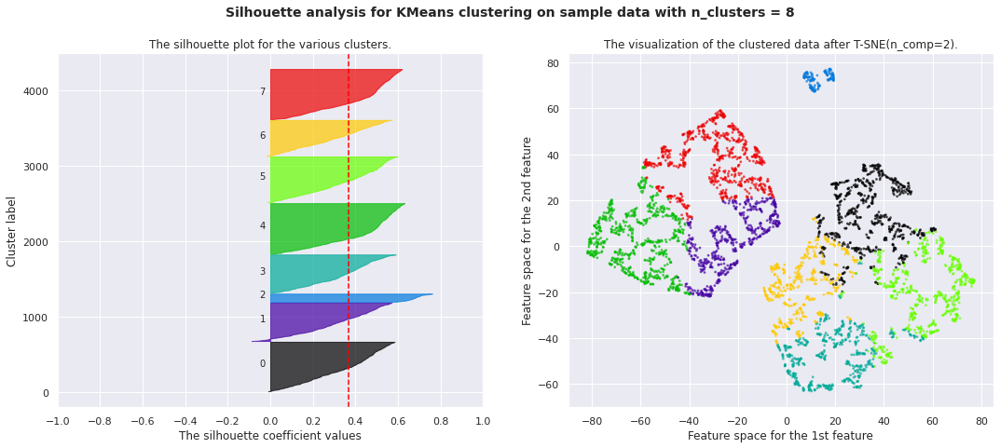

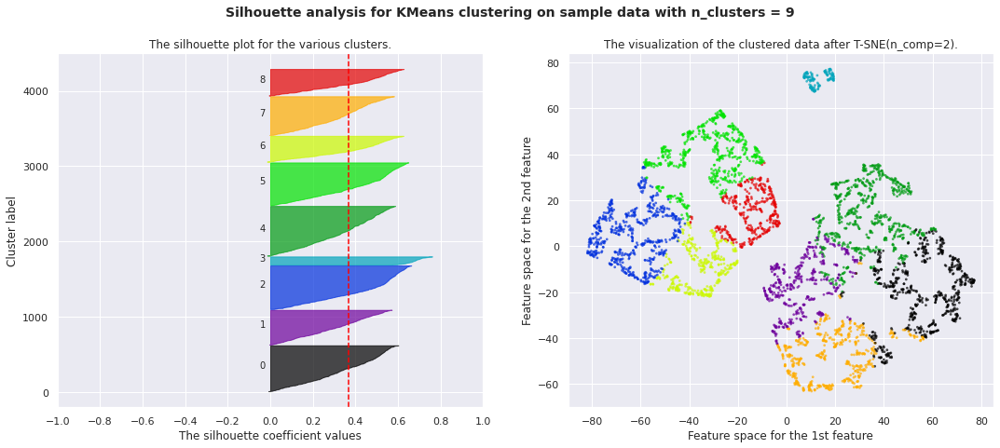

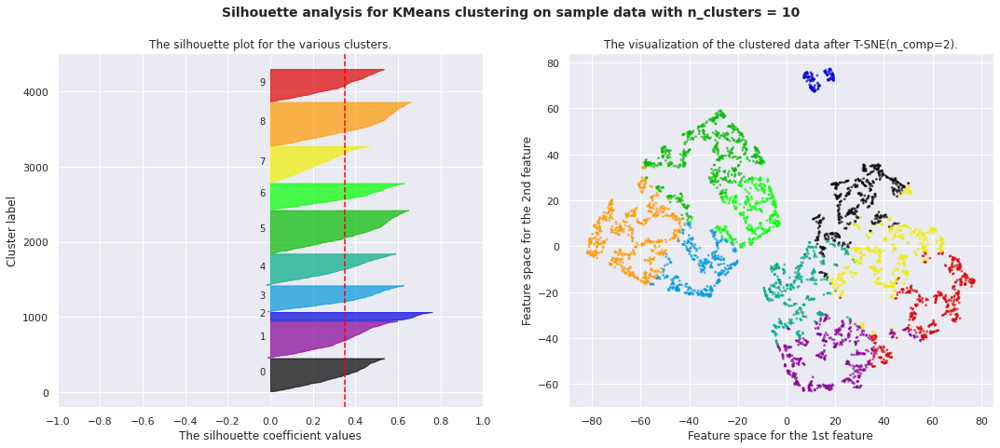

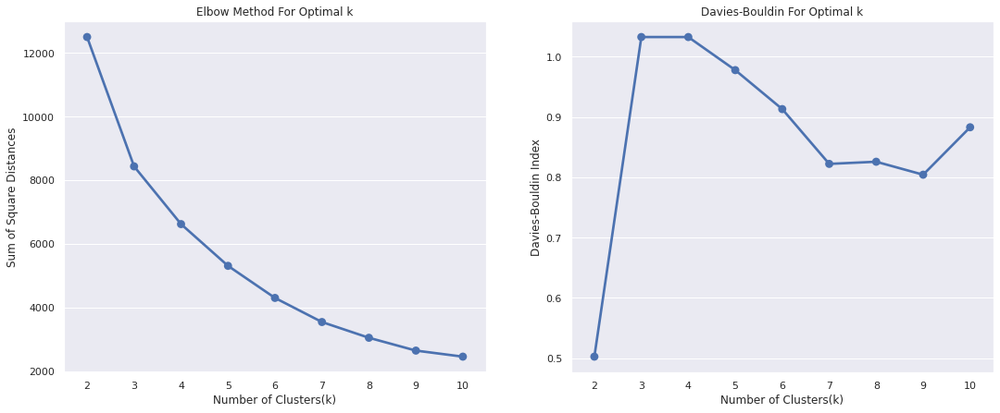

In [ ]:
plot_silhouette_project(X_sample6, X_tsne6)

### Iteration 7



1.   Reduce number of feature to RFM + nb_items_ordered (payment_instalment useless)
2.   Quantile + Std scaler



In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary', 'nb_items_ordered']

In [ ]:
pipeline7 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                        #  ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

In [ ]:
X_sample7 = pipeline7.fit_transform(strat_test_set)

In [ ]:
X_tsne7 = TSNE(n_components=2).fit_transform(X_sample7)

For n_clusters = 2 The average silhouette_score is : 0.5531104795188059
For n_clusters = 3 The average silhouette_score is : 0.31748170654025415
For n_clusters = 4 The average silhouette_score is : 0.3853711556358075
For n_clusters = 5 The average silhouette_score is : 0.40730490149608634
For n_clusters = 6 The average silhouette_score is : 0.42410411723068697
For n_clusters = 7 The average silhouette_score is : 0.4148847797115776
For n_clusters = 8 The average silhouette_score is : 0.38923463458595964
For n_clusters = 9 The average silhouette_score is : 0.3677933558061737
For n_clusters = 10 The average silhouette_score is : 0.37888143226785403


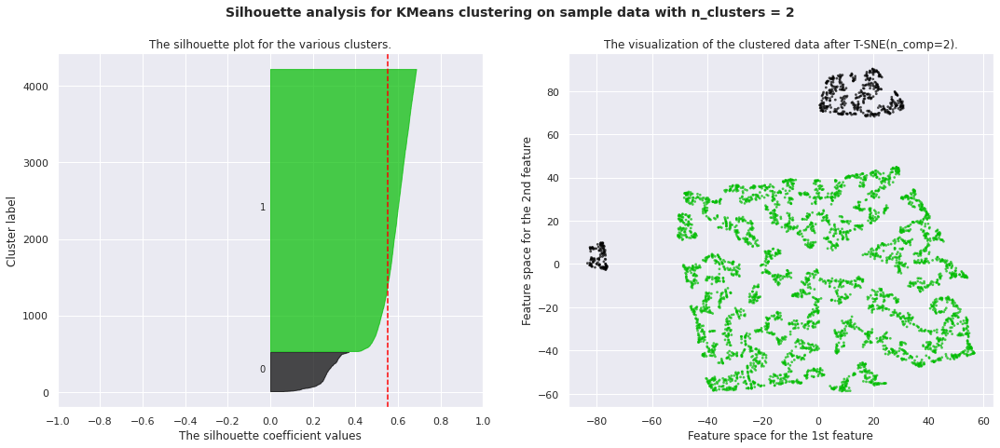

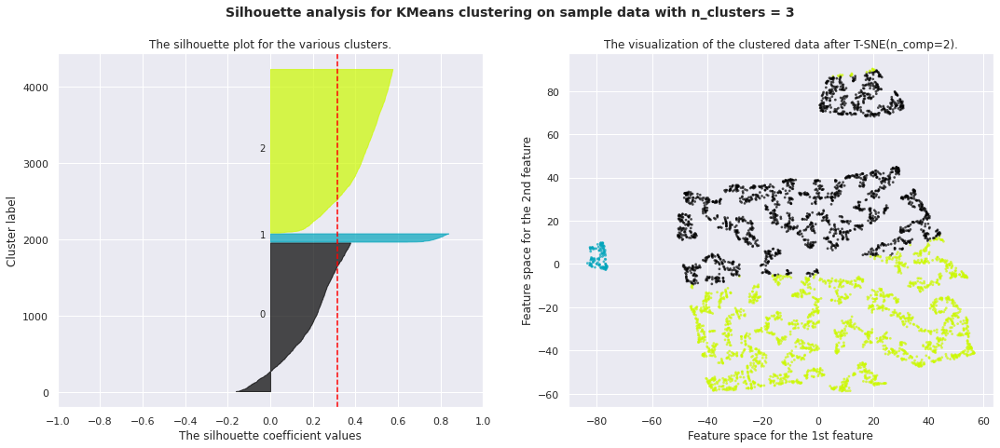

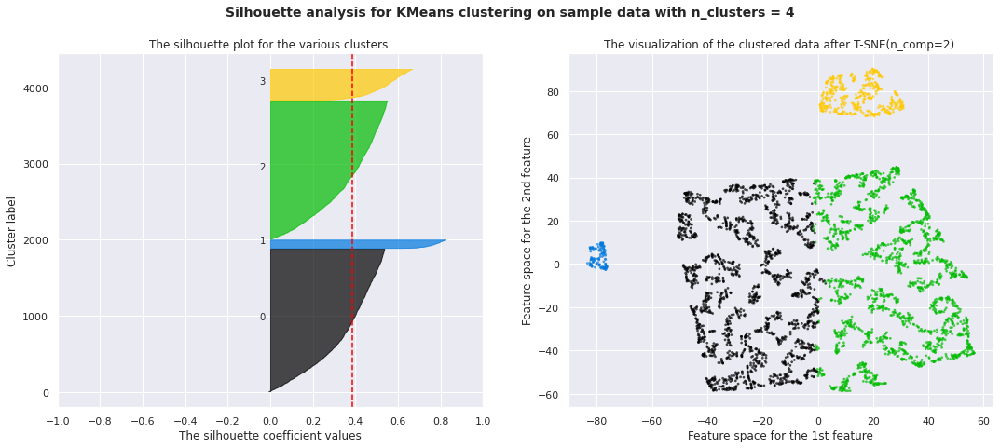

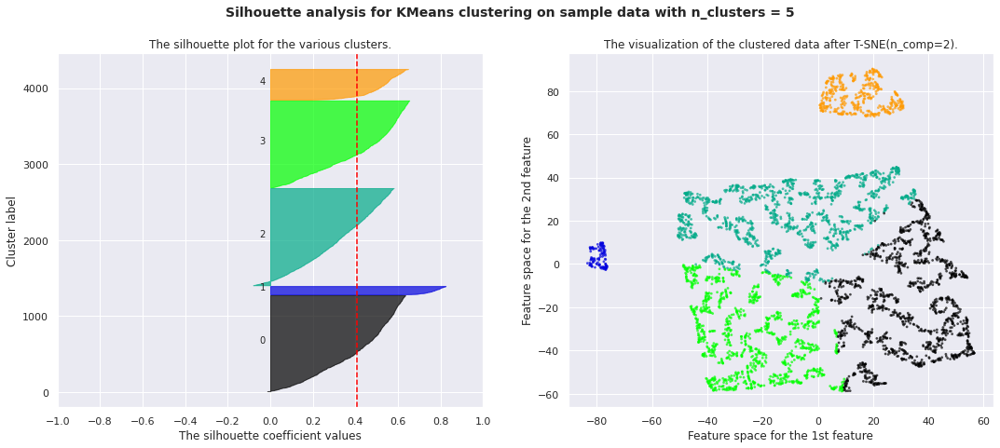

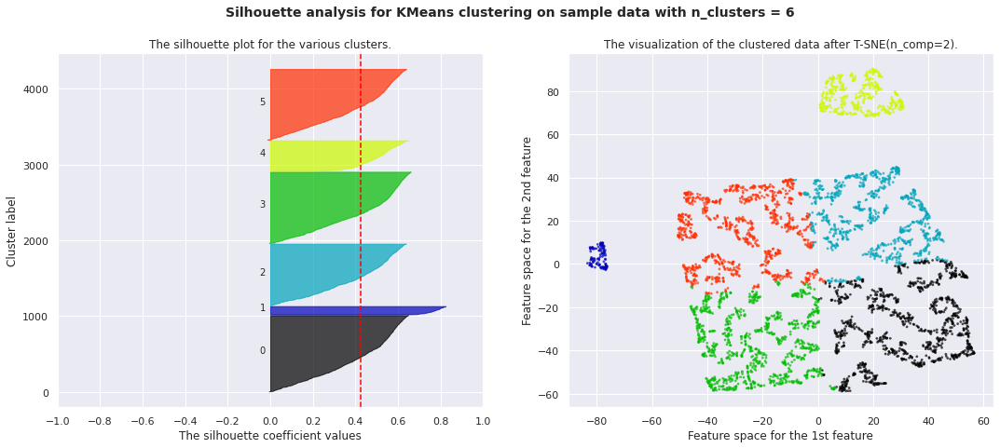

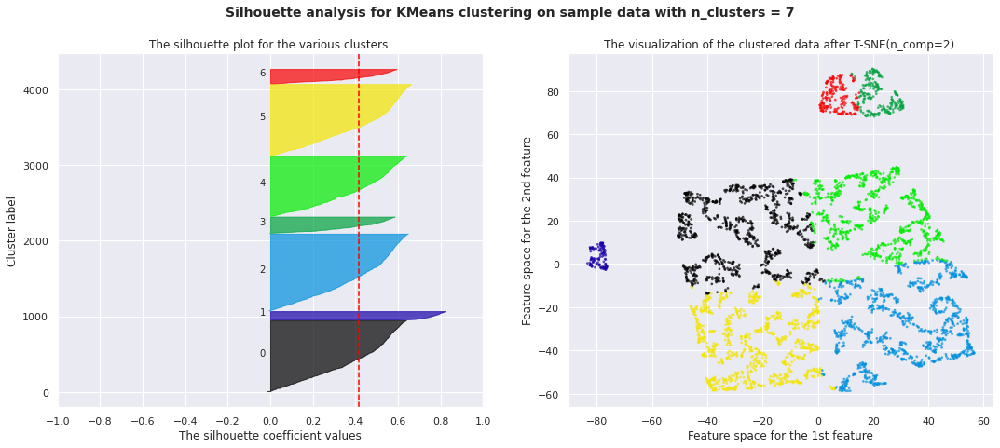

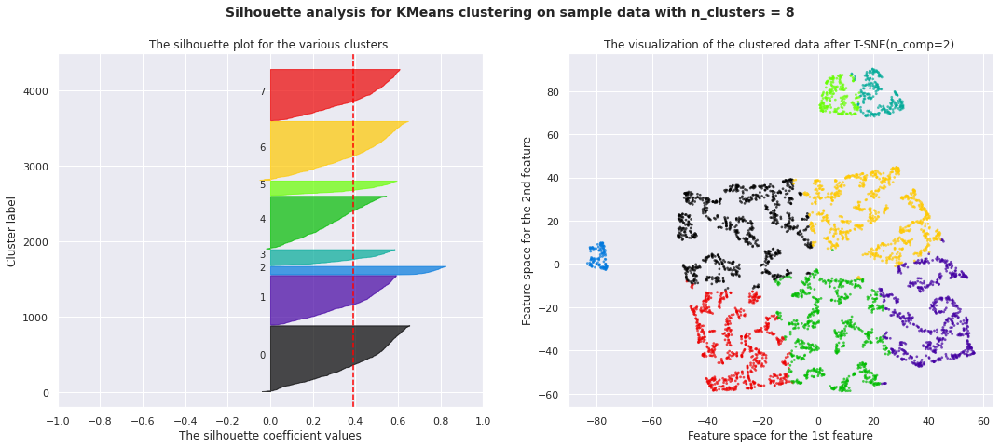

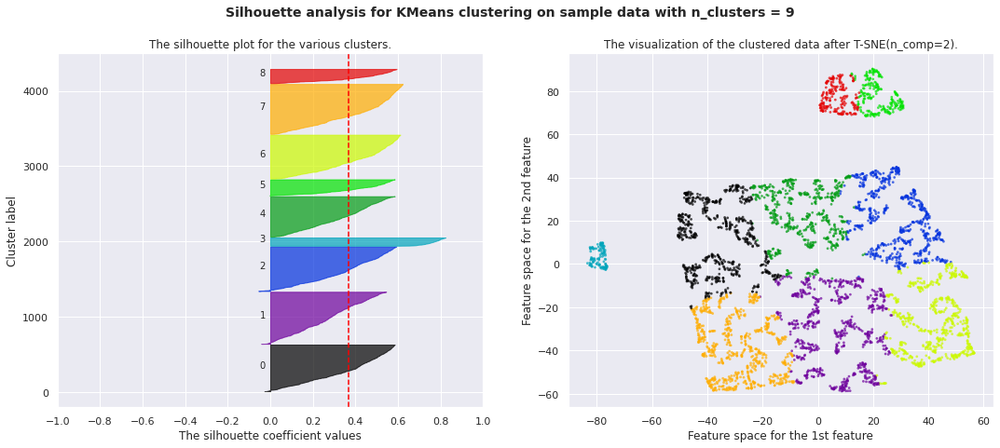

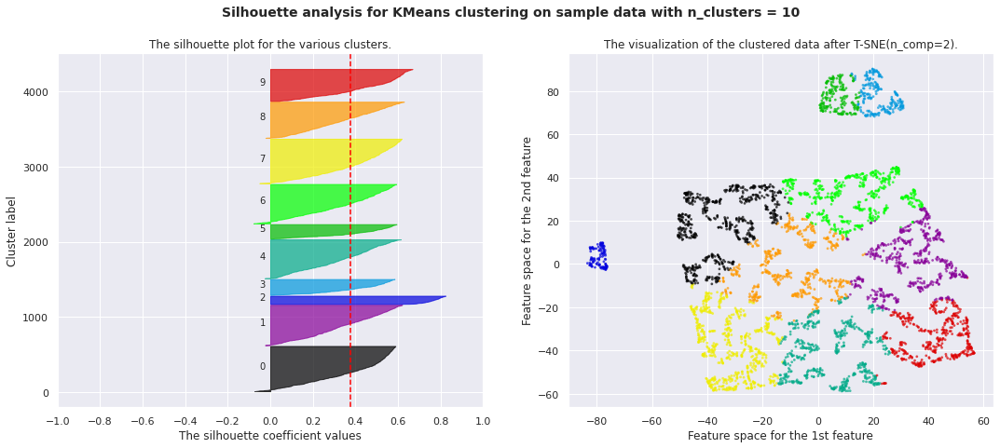

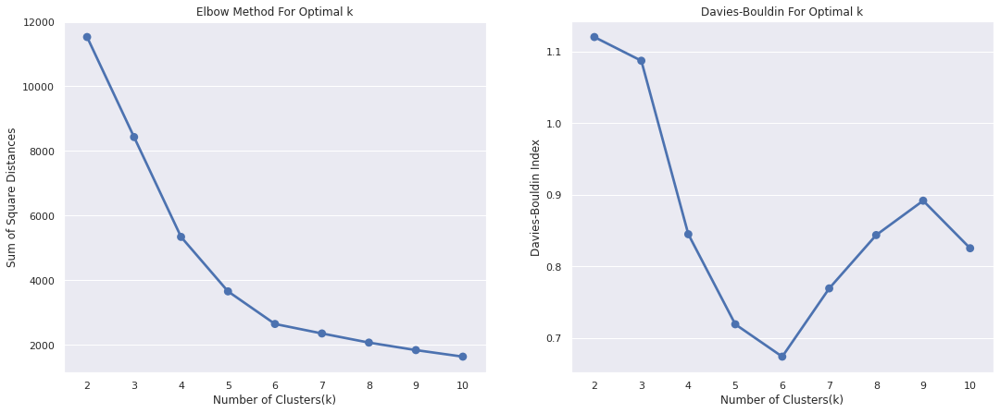

In [ ]:
plot_silhouette_project(X_sample7, X_tsne7)

### Iteration 8



1.   Reduce number of feature to RFM + nb_items + perc_freight (payment_instalment useless)
2.   Quantile + Std scaler



In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary', 'nb_items_ordered', 'perc_freight']

In [ ]:
pipeline8 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                        #  ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

In [ ]:
X_sample8 = pipeline8.fit_transform(strat_test_set)

In [ ]:
X_tsne8 = TSNE(n_components=2).fit_transform(X_sample8)

For n_clusters = 2 The average silhouette_score is : 0.2898825412447189
For n_clusters = 3 The average silhouette_score is : 0.3286744849962534
For n_clusters = 4 The average silhouette_score is : 0.38852555307748493
For n_clusters = 5 The average silhouette_score is : 0.36097491913257673
For n_clusters = 6 The average silhouette_score is : 0.35451620303040865
For n_clusters = 7 The average silhouette_score is : 0.3470541347615672
For n_clusters = 8 The average silhouette_score is : 0.33153444019940564
For n_clusters = 9 The average silhouette_score is : 0.32225830026282887
For n_clusters = 10 The average silhouette_score is : 0.3334441360747765


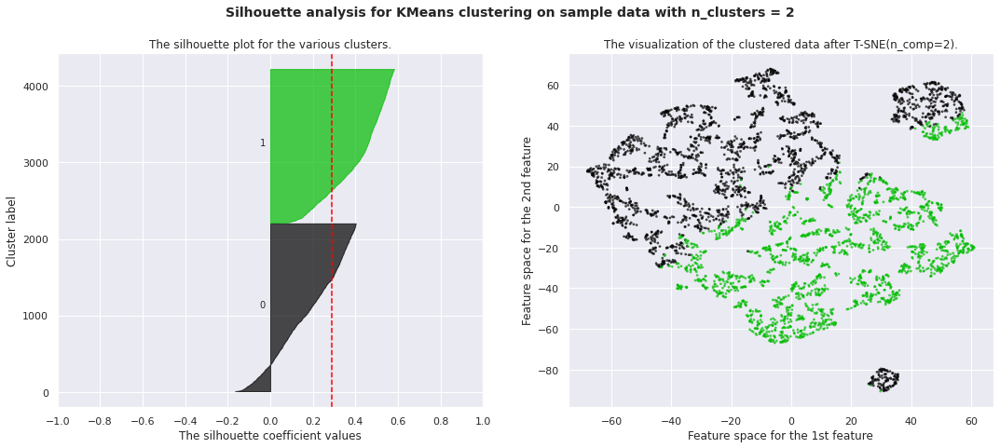

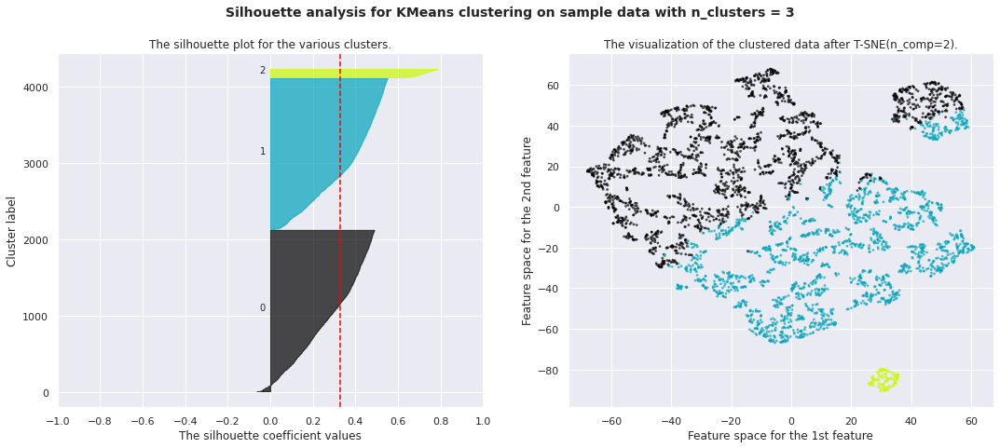

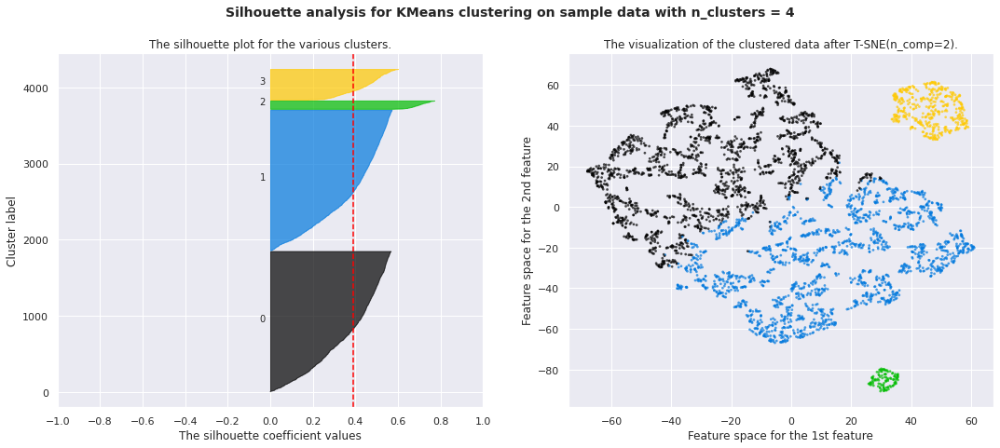

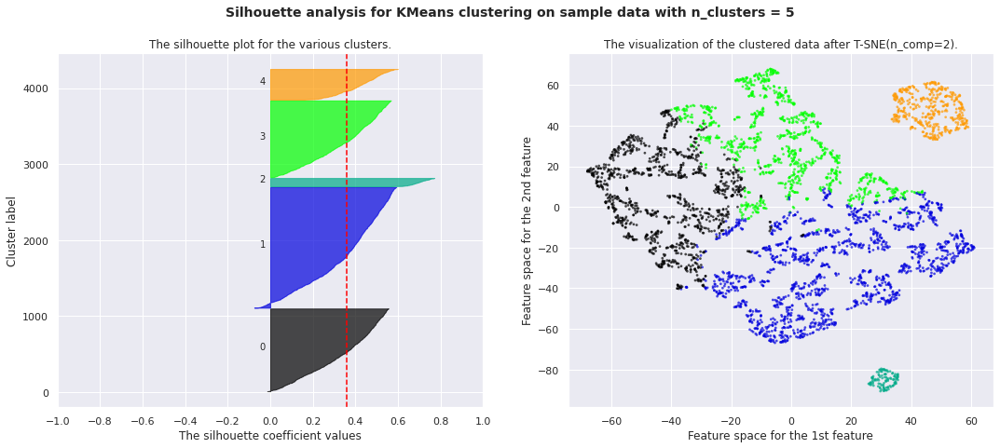

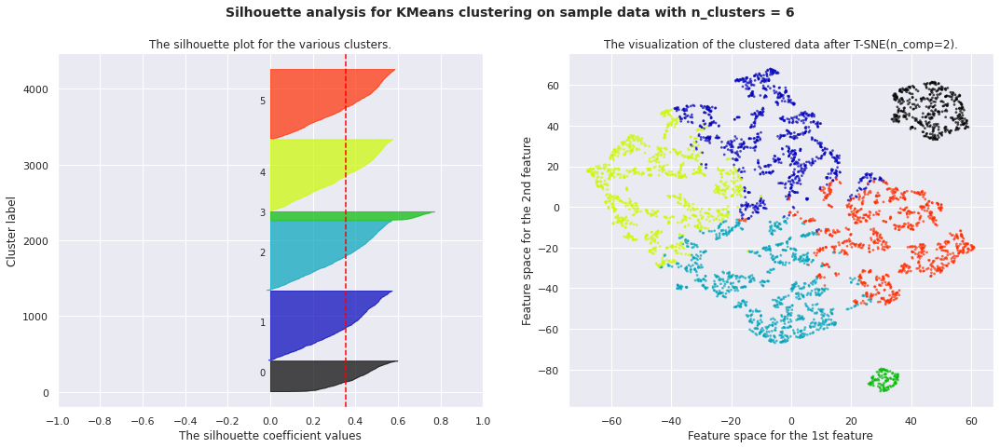

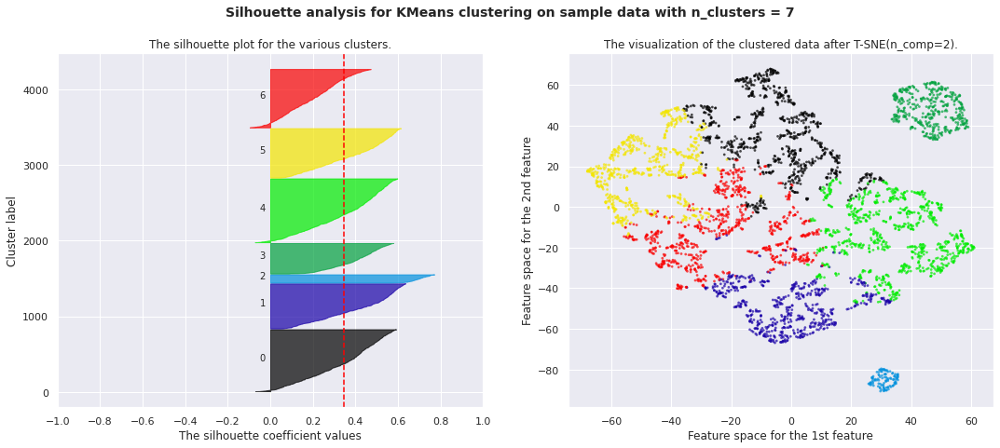

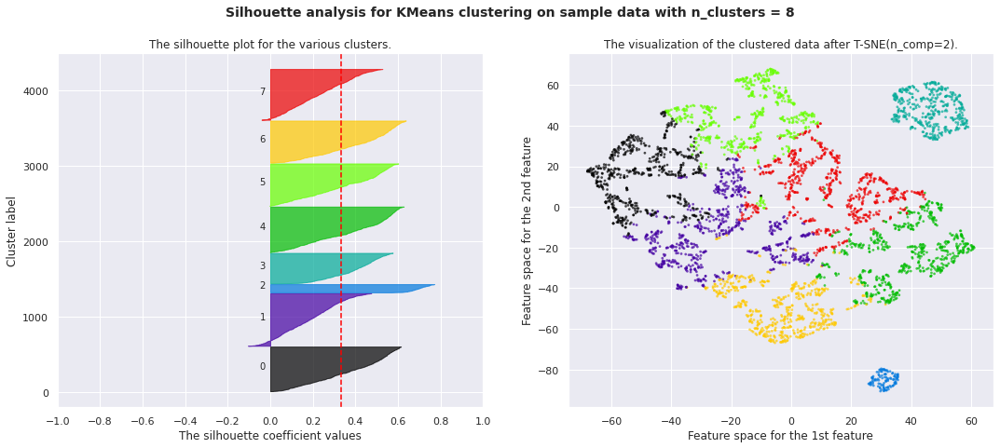

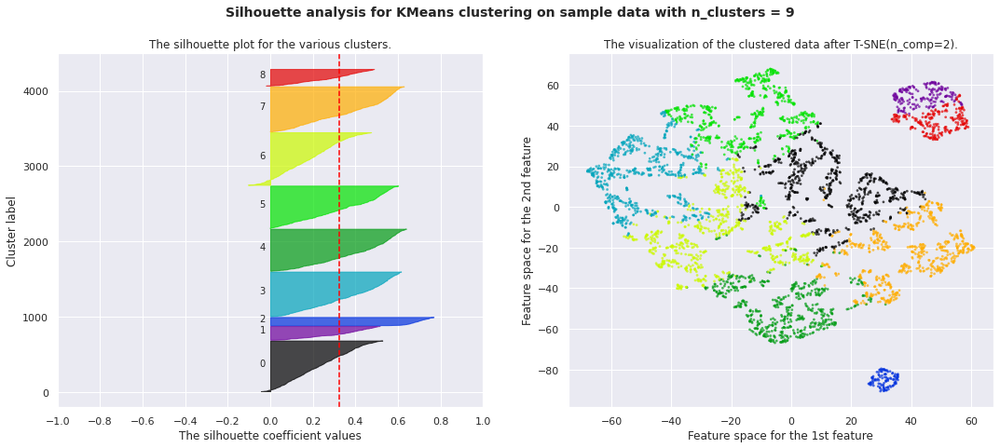

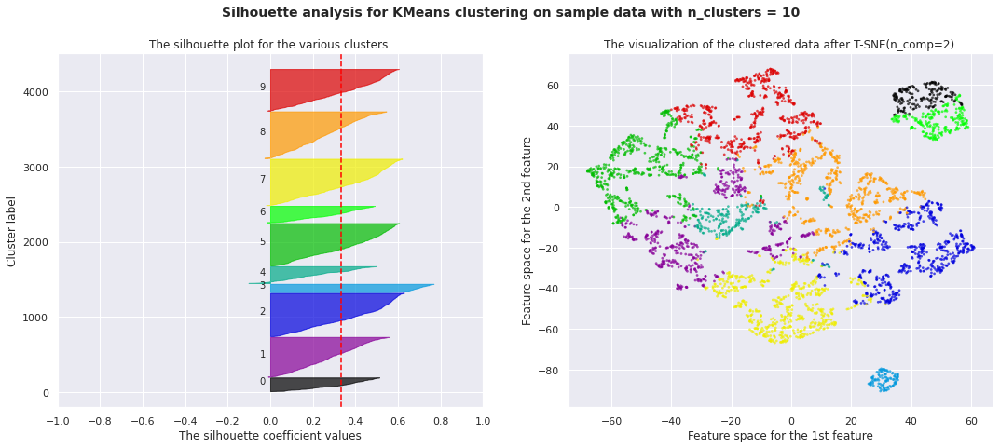

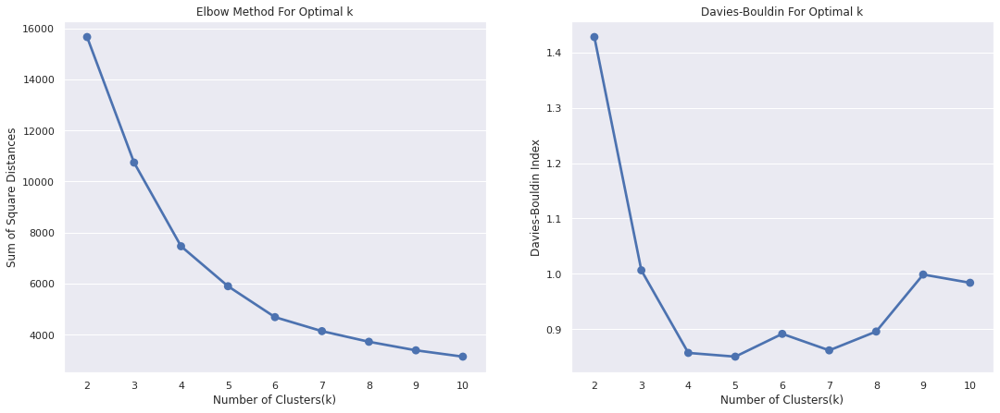

In [ ]:
plot_silhouette_project(X_sample8, X_tsne8)

### Iteration 9



1.   Reduce number of feature to RFM + nb_items + nb_days_to_deliver (payment_instalment - perc_freight useless)
2.   Quantile + Std scaler



In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary', 'nb_items_ordered', 'nb_days_to_deliver']

In [ ]:
pipeline9 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                        #  ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

In [ ]:
X_sample9 = pipeline9.fit_transform(strat_test_set)

In [ ]:
X_tsne9 = TSNE(n_components=2).fit_transform(X_sample9)

For n_clusters = 2 The average silhouette_score is : 0.4730347531849126
For n_clusters = 3 The average silhouette_score is : 0.23804119167428242
For n_clusters = 4 The average silhouette_score is : 0.28214664968268677
For n_clusters = 5 The average silhouette_score is : 0.28361887559374566
For n_clusters = 6 The average silhouette_score is : 0.29968090472821635
For n_clusters = 7 The average silhouette_score is : 0.29599532414518387
For n_clusters = 8 The average silhouette_score is : 0.3064332564802023
For n_clusters = 9 The average silhouette_score is : 0.30459779686747285
For n_clusters = 10 The average silhouette_score is : 0.29458596713483864


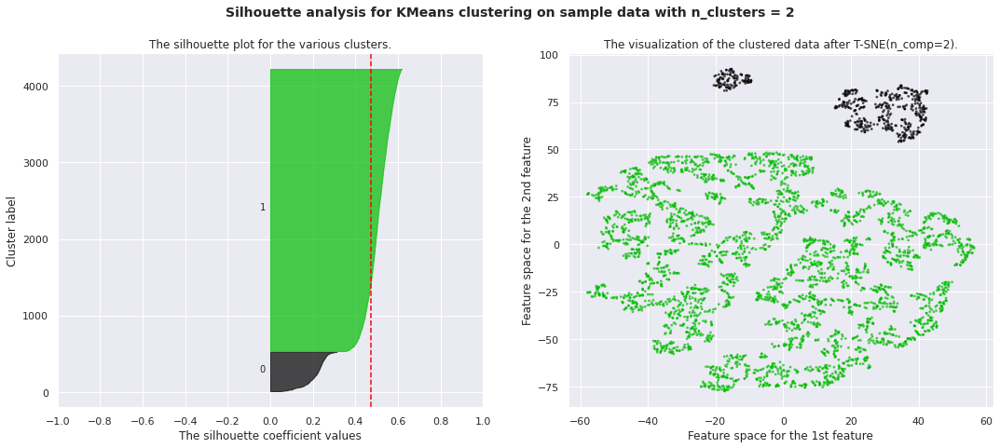

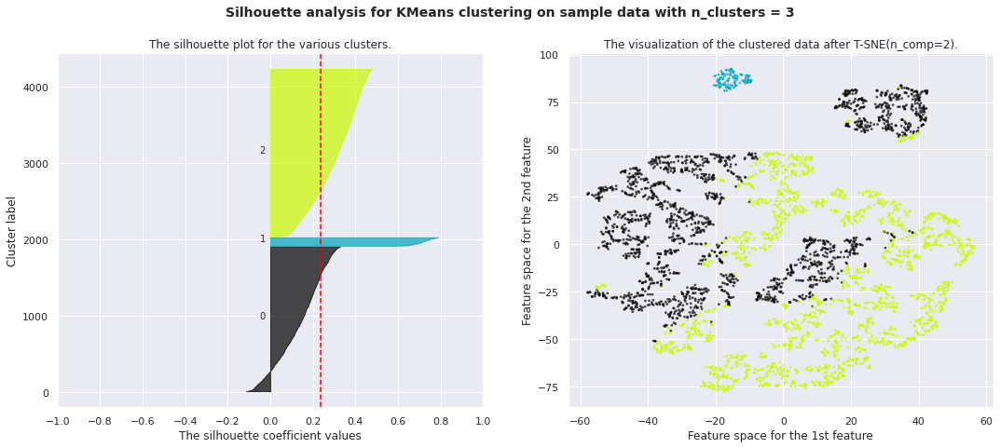

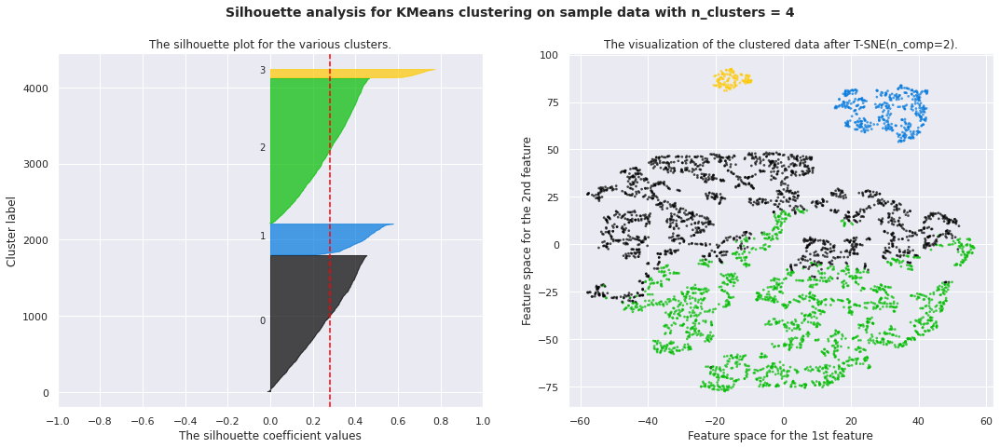

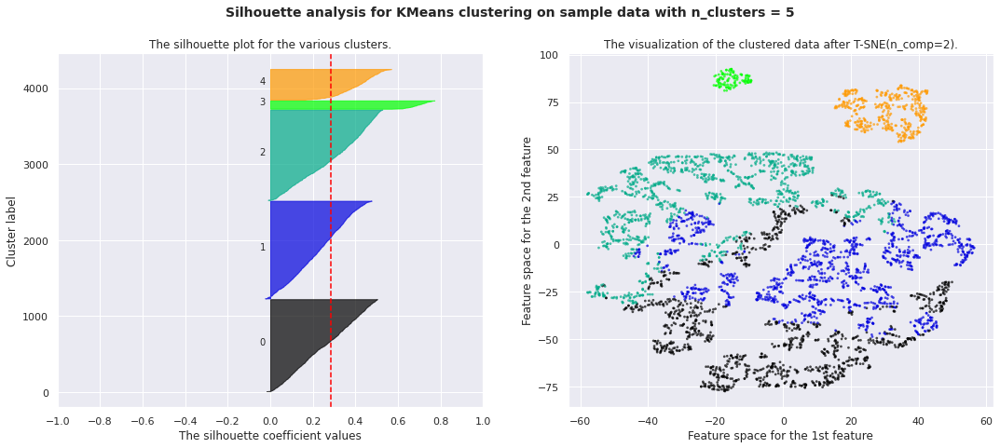

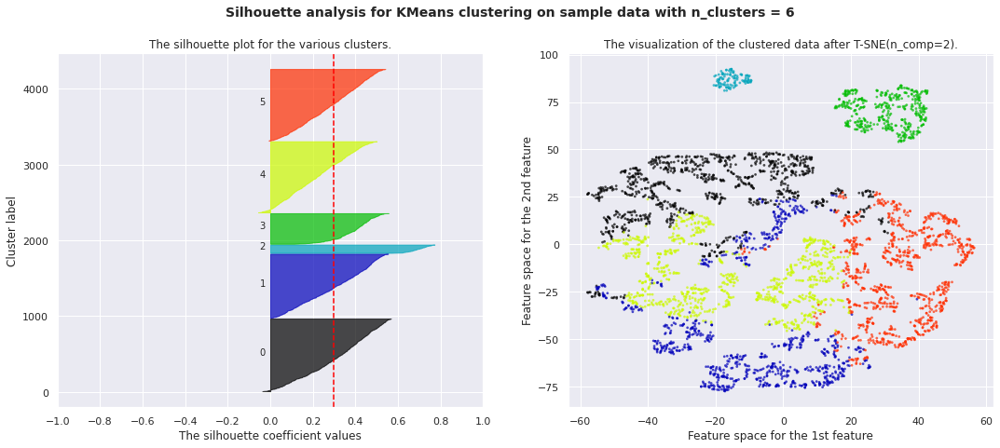

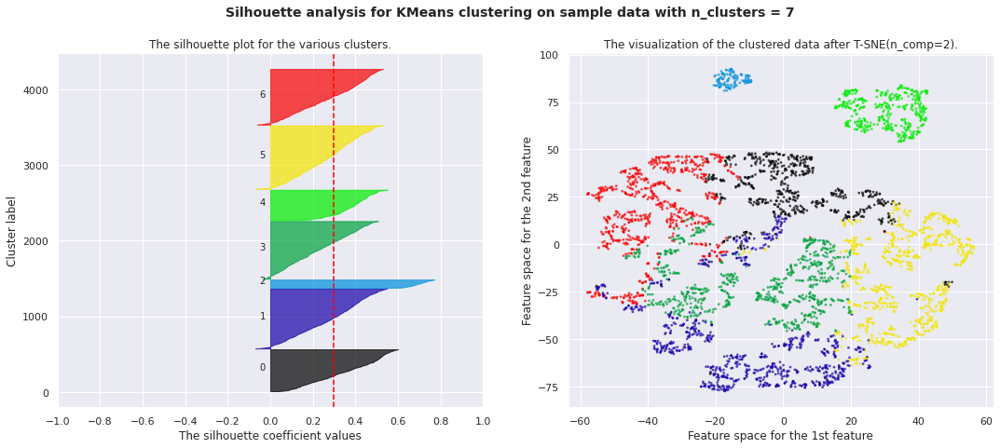

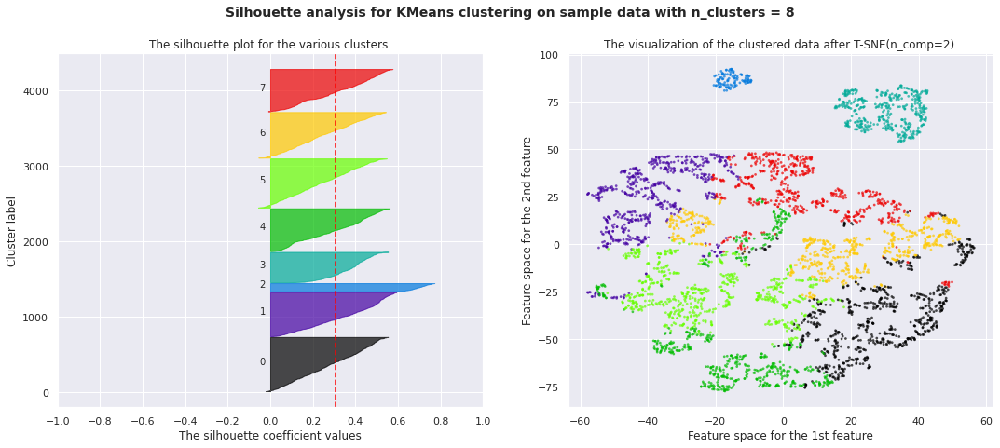

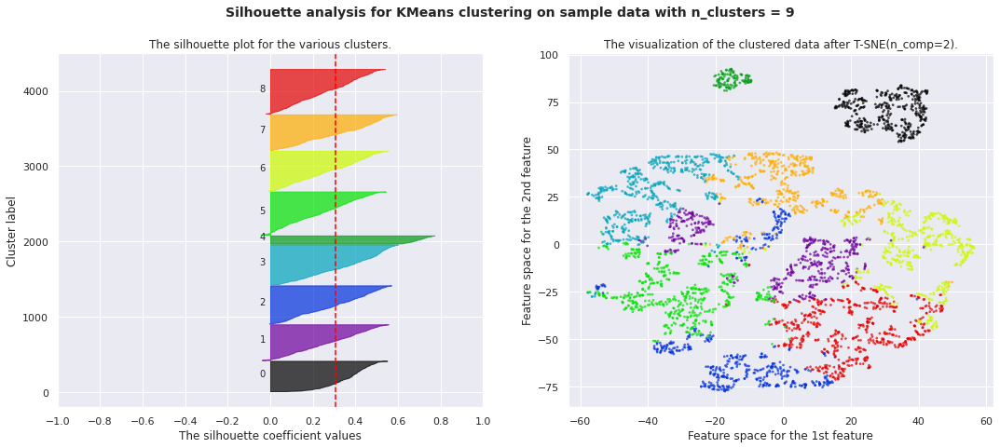

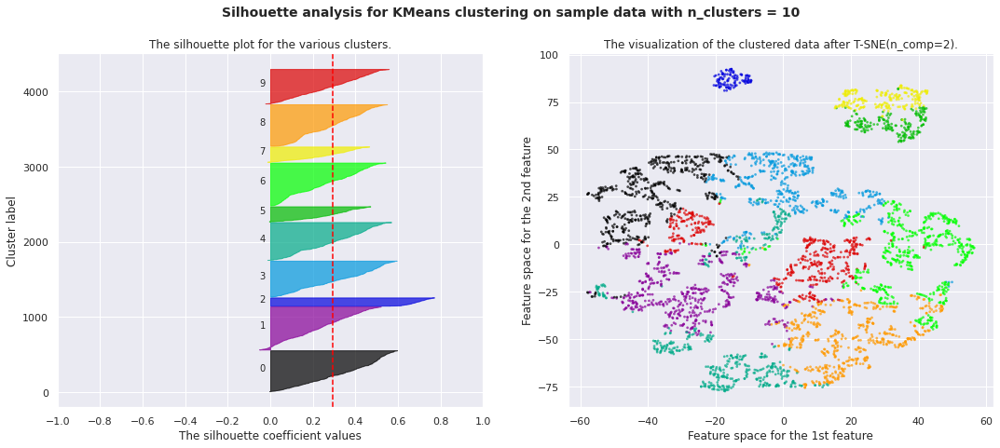

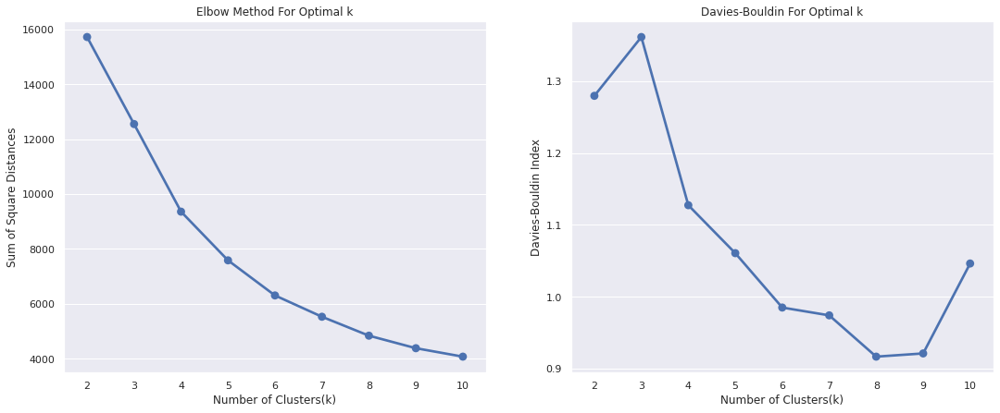

In [ ]:
plot_silhouette_project(X_sample9, X_tsne9)

### Iteration 10



1.   Reduce number of feature to RFM + nb_items + review_score (payment_instalment - perc_freight - nb_days useless)
2.   Quantile + Std scaler



In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary', 'nb_items_ordered', 'review_score']

In [ ]:
pipeline10 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                        #  ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

In [ ]:
X_sample10 = pipeline10.fit_transform(strat_test_set)

In [ ]:
X_tsne10 = TSNE(n_components=2).fit_transform(X_sample10)

For n_clusters = 2 The average silhouette_score is : 0.48318812037945413
For n_clusters = 3 The average silhouette_score is : 0.29320266373152265
For n_clusters = 4 The average silhouette_score is : 0.3414355529658365
For n_clusters = 5 The average silhouette_score is : 0.29639456411954845
For n_clusters = 6 The average silhouette_score is : 0.2923169778758336
For n_clusters = 7 The average silhouette_score is : 0.3061534825284886
For n_clusters = 8 The average silhouette_score is : 0.32070098451093715
For n_clusters = 9 The average silhouette_score is : 0.32483103235169597
For n_clusters = 10 The average silhouette_score is : 0.31381286629810895


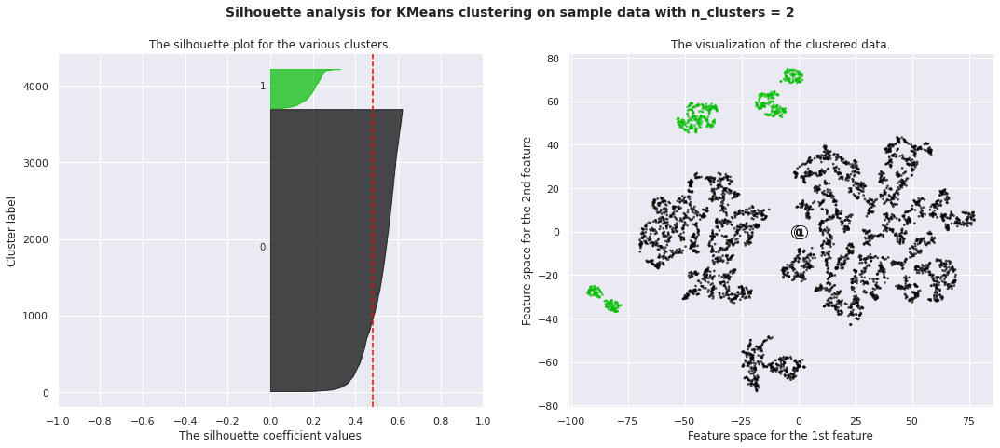

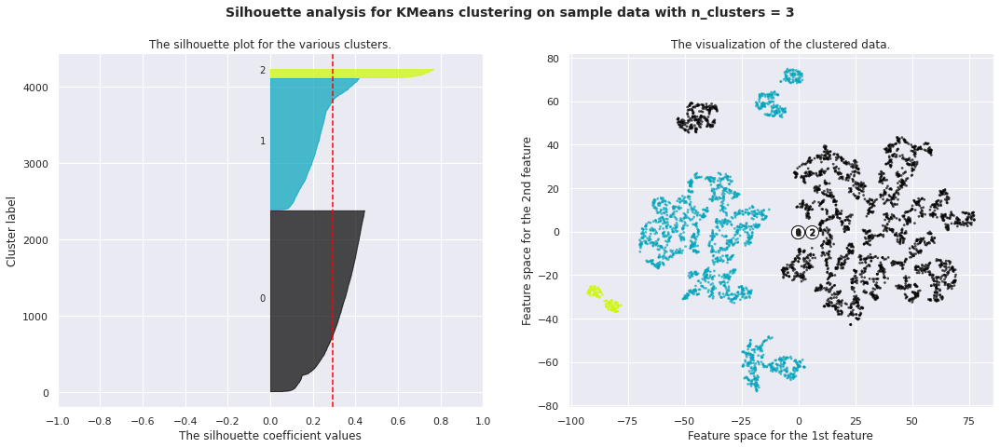

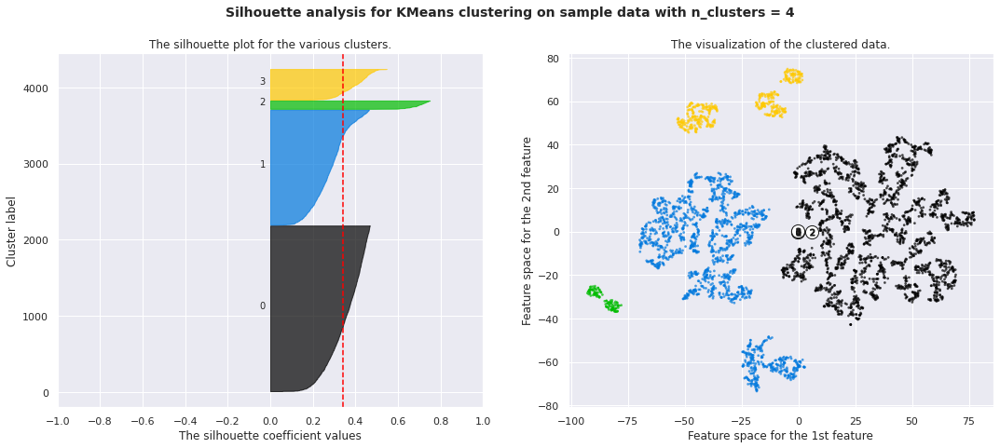

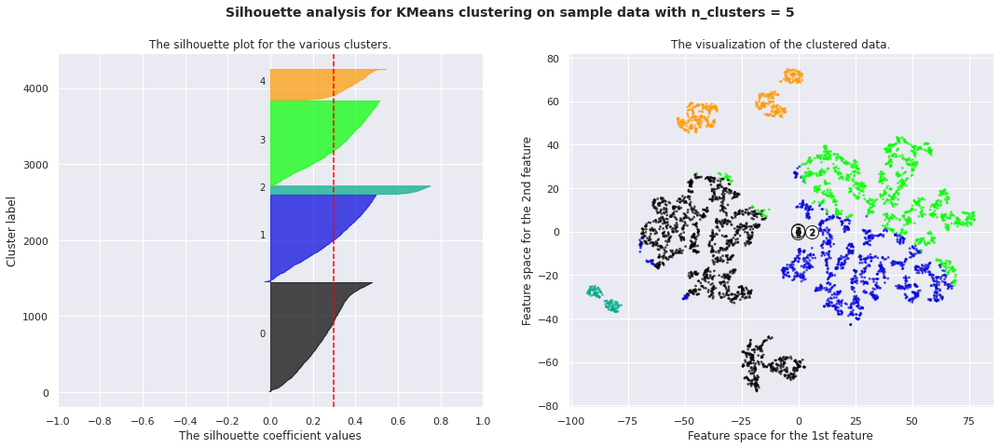

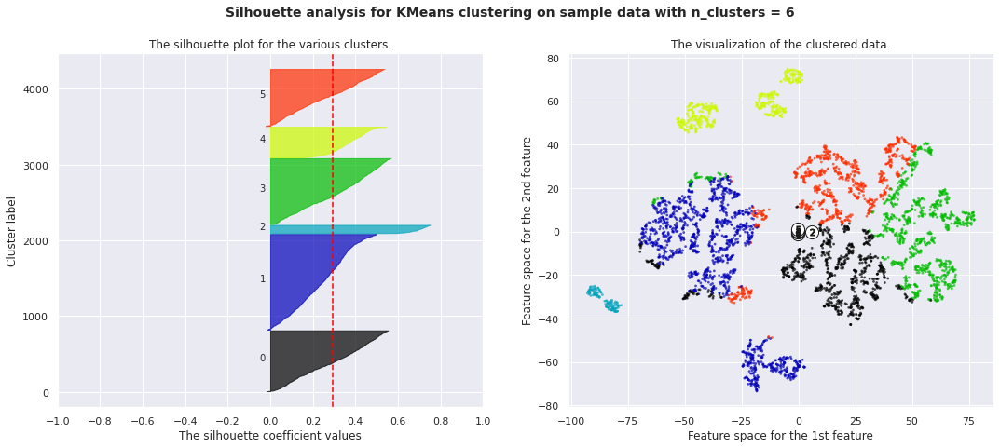

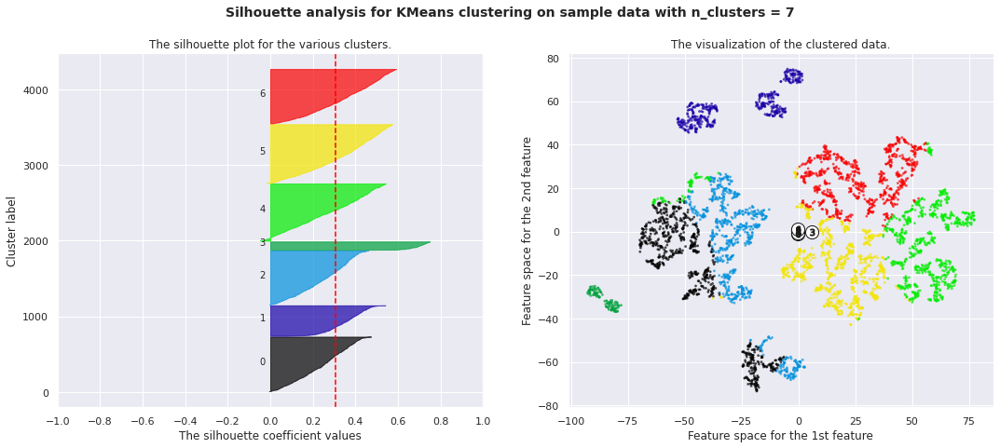

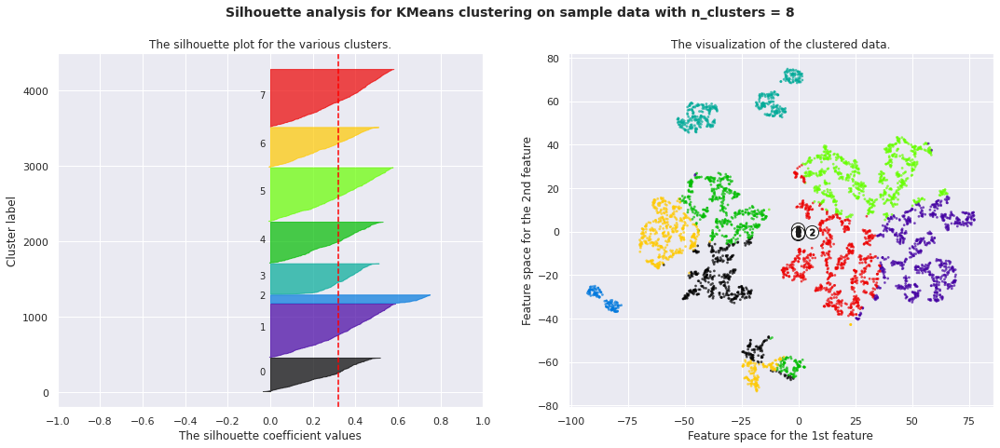

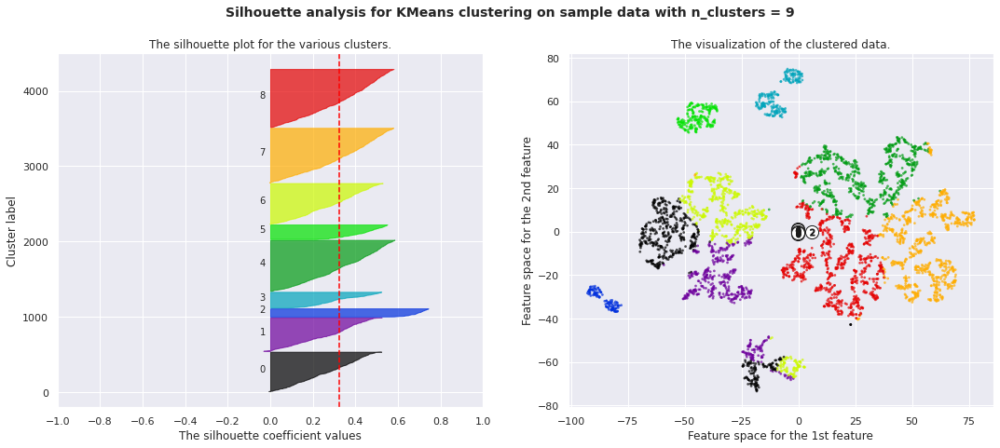

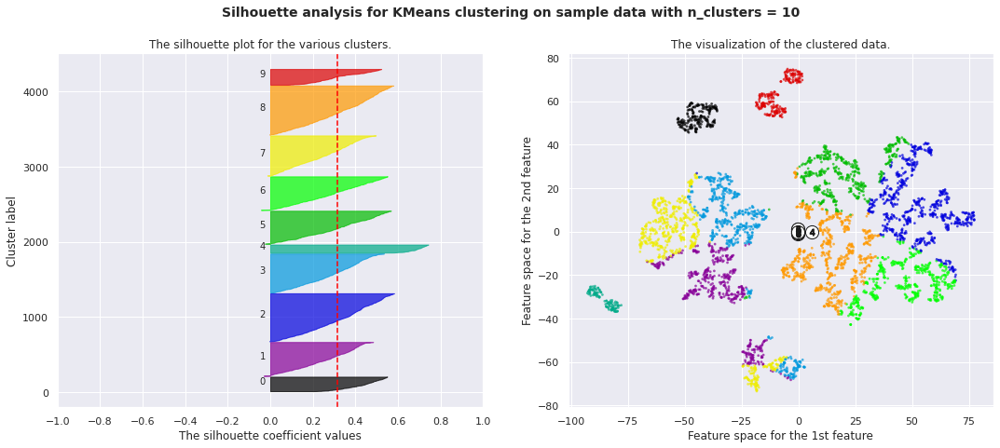

In [ ]:
plot_silhouette_project(X_sample10, X_tsne10)

### Iteration 10



1.   Reduce number of feature to RFM + nb_items + review_score (payment_instalment - perc_freight - nb_days useless)
2.   Quantile + Std scaler



In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary', 'nb_items_ordered']
review=['review_score']

In [ ]:
pipe1 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                        #  ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

pipe2 = Pipeline([
                         ('selector', DataFrameSelector(review)),
                         ('std_scaler', MinMaxScaler())
])

full_pipeline = FeatureUnion(transformer_list=[
                                               ('pipe1', pipe1),
                                               ('pipe2', pipe2)
])

In [ ]:
X_sample10 = full_pipeline.fit_transform(strat_test_set)

In [ ]:
X_tsne10 = TSNE(n_components=2).fit_transform(X_sample10)

For n_clusters = 2 The average silhouette_score is : 0.5414775645572507
For n_clusters = 3 The average silhouette_score is : 0.3023967567742458
For n_clusters = 4 The average silhouette_score is : 0.3642623886483495
For n_clusters = 5 The average silhouette_score is : 0.38020509048324175
For n_clusters = 6 The average silhouette_score is : 0.38979510693980823
For n_clusters = 7 The average silhouette_score is : 0.37948180584800406
For n_clusters = 8 The average silhouette_score is : 0.3486419956191611
For n_clusters = 9 The average silhouette_score is : 0.34243413554153396
For n_clusters = 10 The average silhouette_score is : 0.32903184786755346


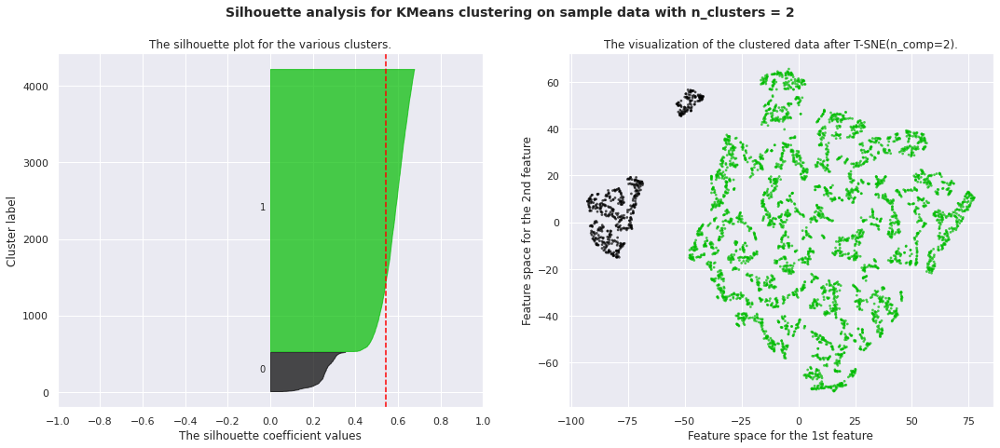

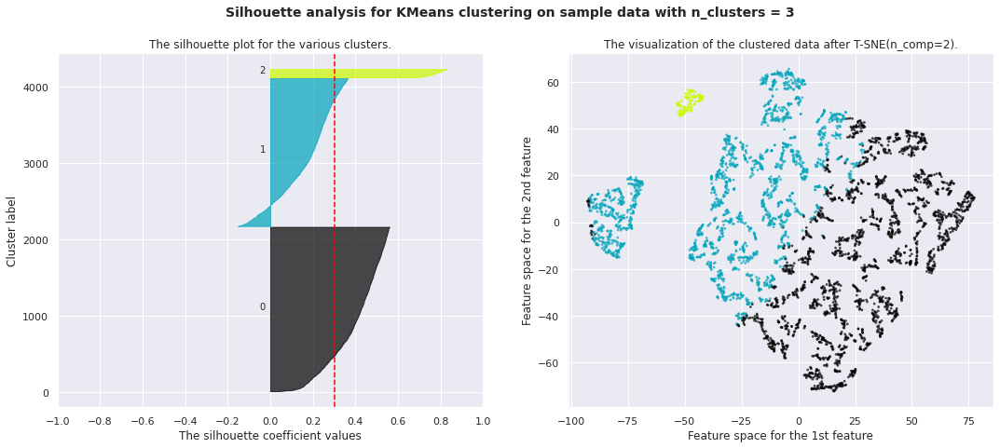

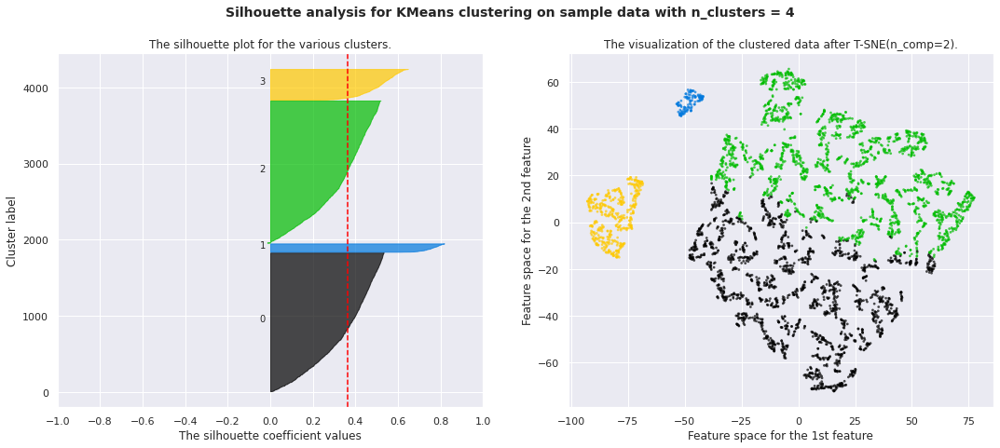

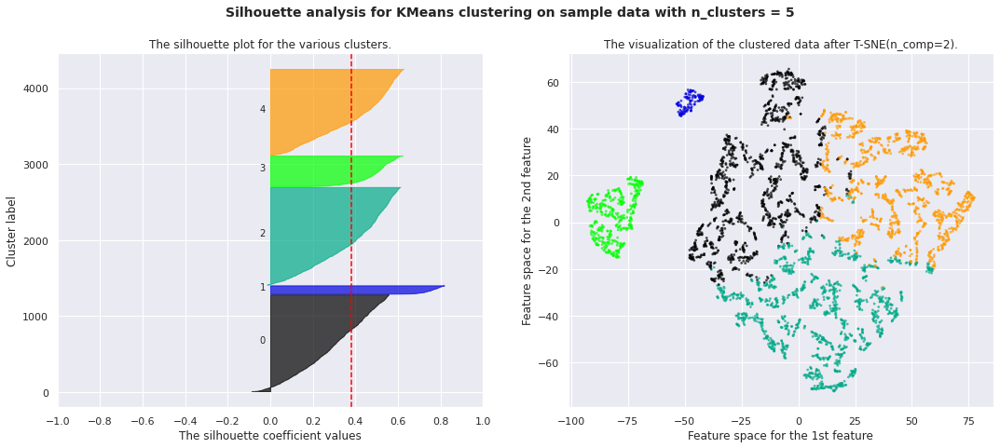

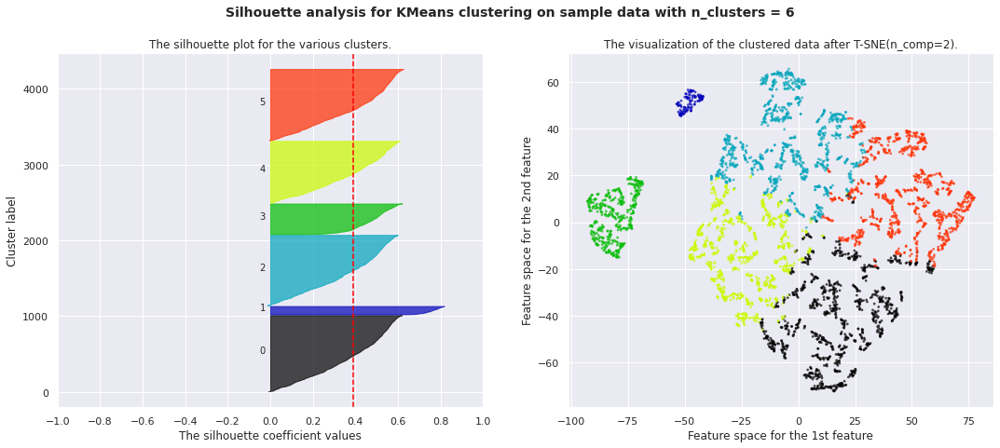

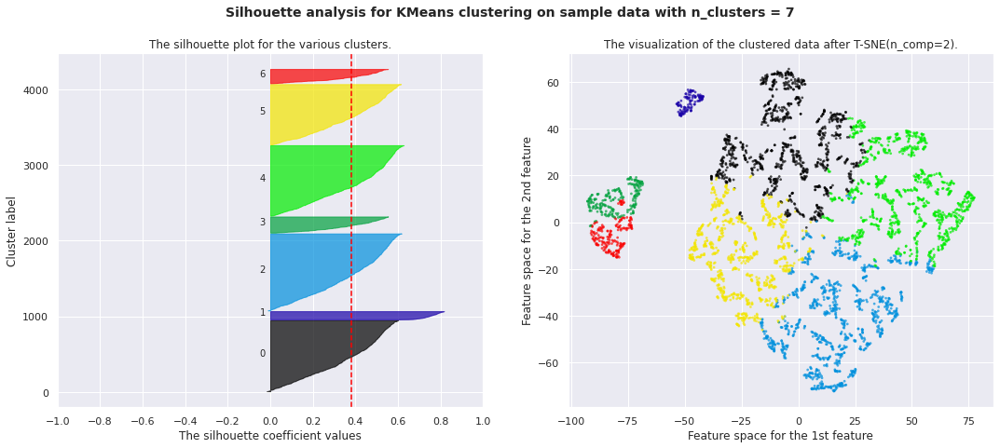

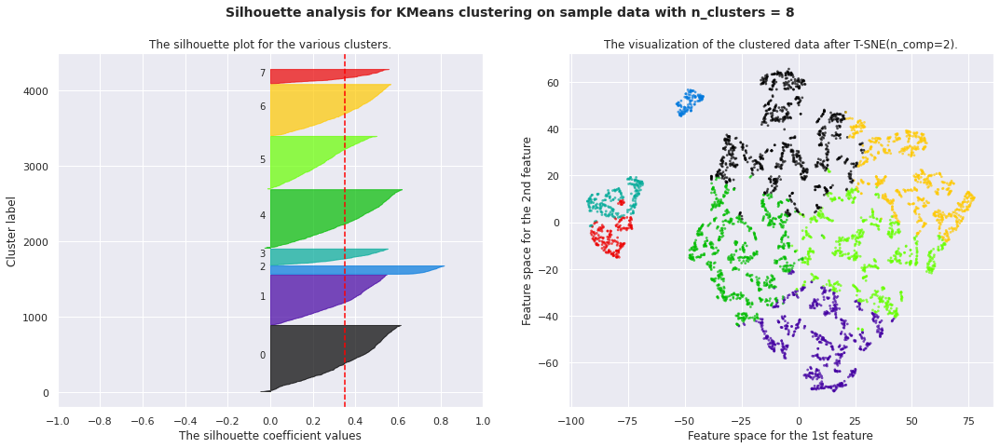

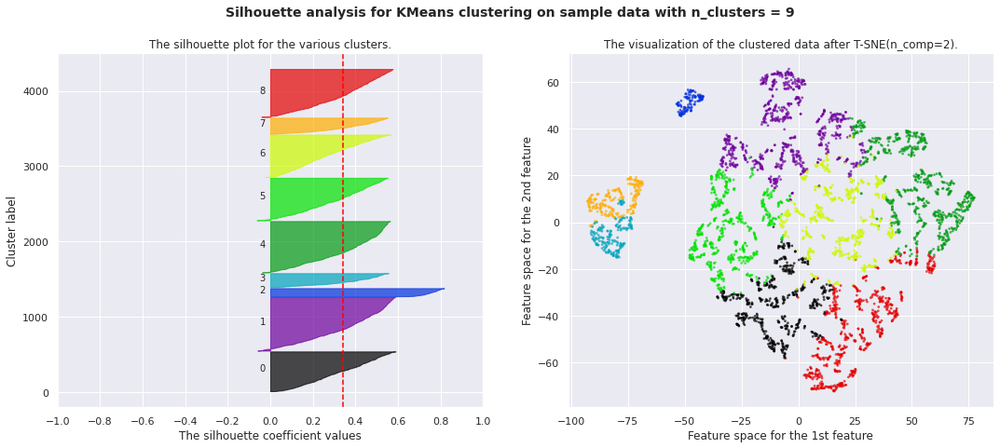

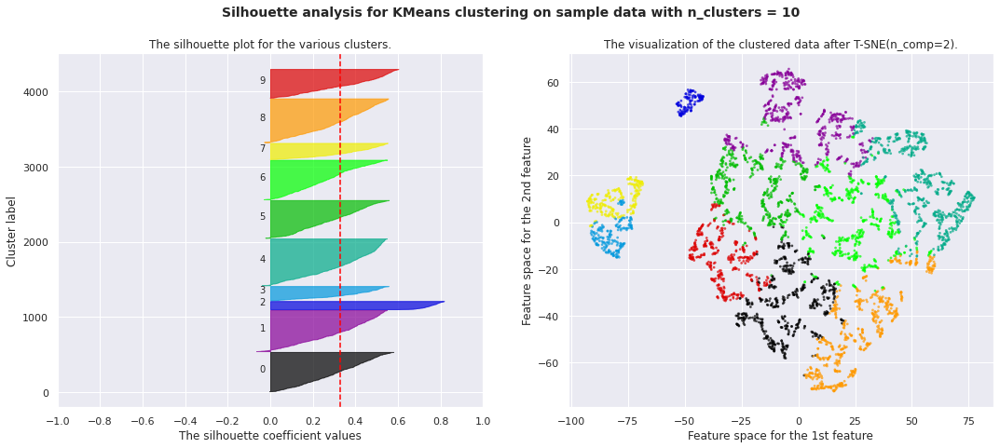

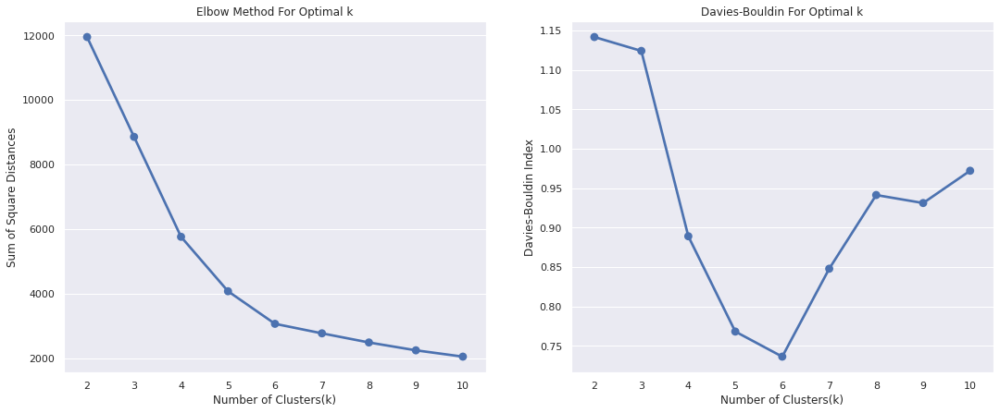

In [ ]:
plot_silhouette_project(X_sample10, X_tsne10)

## Best model ?

Based on the previous iterations, the most satisfying results were obtained using:

  - features (RFM + nb_items + review)
  - QuantileTransformer on RFM + nb_items followed by StdScaler
  - MinMaxScaler on review
  - optimal nb of clusters for KMeans = 6

I will now be KMeans with 2 other clustering algorithms using the same features and transformaton-scaling listed above.



### DBSCAN

For n_clusters = 3 The average silhouette_score is : 0.5041573199652183


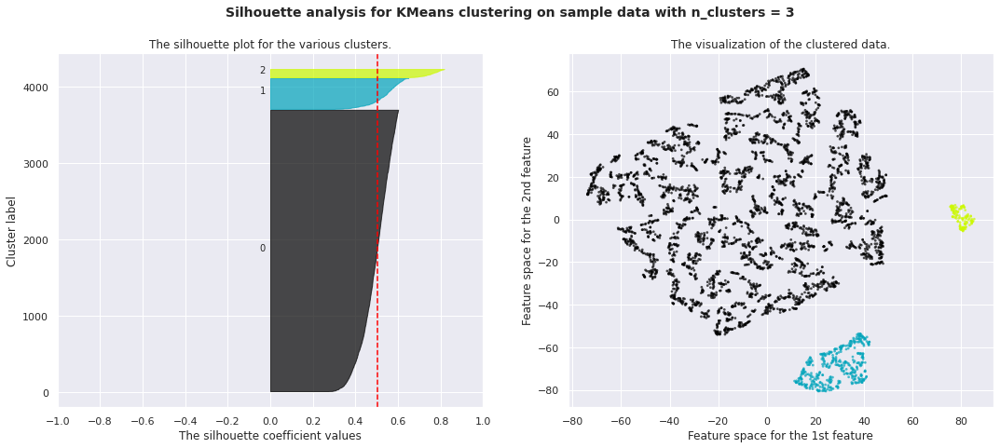

In [ ]:
plot_silhouette_project_DBSCAN(X_sample20, X_tsne20, 3, 2, 10)

### Agglomerative Clustering

The average silhouette_score is : 0.5041573199652183


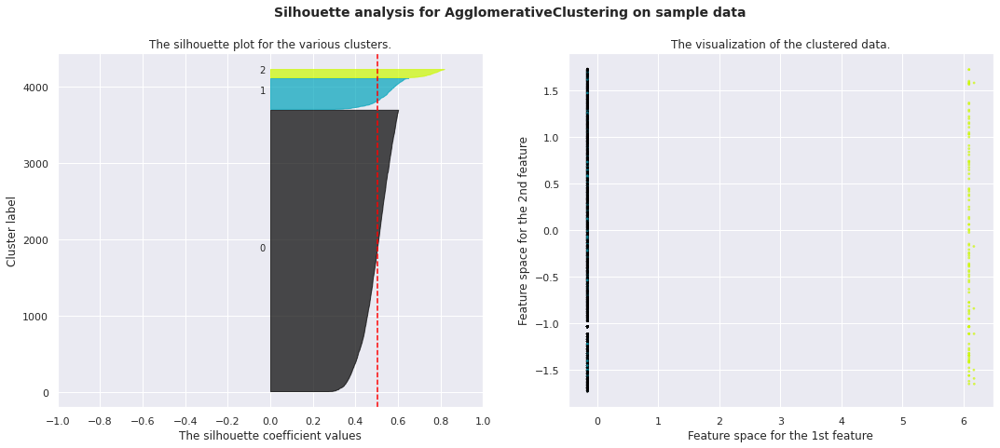

In [ ]:
plot_silhouette_project_AC(X_sample20, X_sample20, 3)

In [ ]:
km_sample = KMeans(n_clusters=6, random_state=10)
km_sample.fit_predict(X_sample20)

array([5, 2, 0, ..., 2, 3, 5], dtype=int32)

In [ ]:
km_sample.cluster_centers_

array([[-0.16395561,  0.8496621 , -0.91215965, -0.37316147,  0.8054175 ],
       [ 6.09914854, -0.17126448,  0.9284541 ,  2.6881716 ,  0.80018939],
       [-0.16395561, -0.82432836,  0.83085576, -0.37316147,  0.78987069],
       [-0.16395561,  0.05433264,  0.61492331,  2.674556  ,  0.67667079],
       [-0.16395561,  0.90860075,  0.78663797, -0.37316147,  0.81319018],
       [-0.16395561, -0.88754447, -0.89996853, -0.37316147,  0.78301384]])

In [ ]:
X_sample20_labeled = pd.DataFrame(X_sample20, columns=features+review)
X_sample20_labeled['cluster'] = km_sample.labels_

In [ ]:
X_sample20_labeled.groupby('cluster').agg({'frequency':'mean', 'recency':'mean', 'monetary':'mean', 'nb_items_ordered':'mean', 'review_score':'mean'})

,frequency,recency,monetary,nb_items_ordered,review_score
cluster,,,,,
0,-0.163956,0.849512,-0.913853,-0.373161,0.805279
1,6.099149,-0.171264,0.928454,2.688172,0.800189
2,-0.163956,-0.823396,0.830642,-0.373161,0.789559
3,-0.163956,0.054333,0.614923,2.674556,0.676671
4,-0.163956,0.909703,0.784747,-0.373161,0.813725
5,-0.163956,-0.887544,-0.899969,-0.373161,0.783014


In [ ]:
from sklearn.metrics.cluster import adjusted_rand_score, contingency_matrix, homogeneity_score
a = [1,6,2,2,2,2,2,2,2,2,2,2]
b = [0,2,3,5,3,5,3,3,3,5,3,3]
adjusted_rand_score(a,b), contingency_matrix(a,b),homogeneity_score(a,b)

(0.4210526315789474, array([[1, 0, 0, 0],
        [0, 0, 7, 3],
        [0, 1, 0, 0]]), 1.0)

# DF_2017_all



1.   Reduce number of feature to RFM + nb_items_ordered (payment_instalment useless)
2.   Quantile - MinMax + Std scaler



In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary', 'nb_items_ordered']
review=['review_score']

In [ ]:
pipe1 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                        #  ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

pipe2 = Pipeline([
                         ('selector', DataFrameSelector(review)),
                         ('std_scaler', MinMaxScaler())
])

full_pipeline = FeatureUnion(transformer_list=[
                                               ('pipe1', pipe1),
                                               ('pipe2', pipe2)
])

In [ ]:
X = full_pipeline.fit_transform(df_2017)

In [ ]:
X_tsne = TSNE(n_components=2).fit_transform(X)

For n_clusters = 6 The average silhouette_score is : 0.3908817274551898


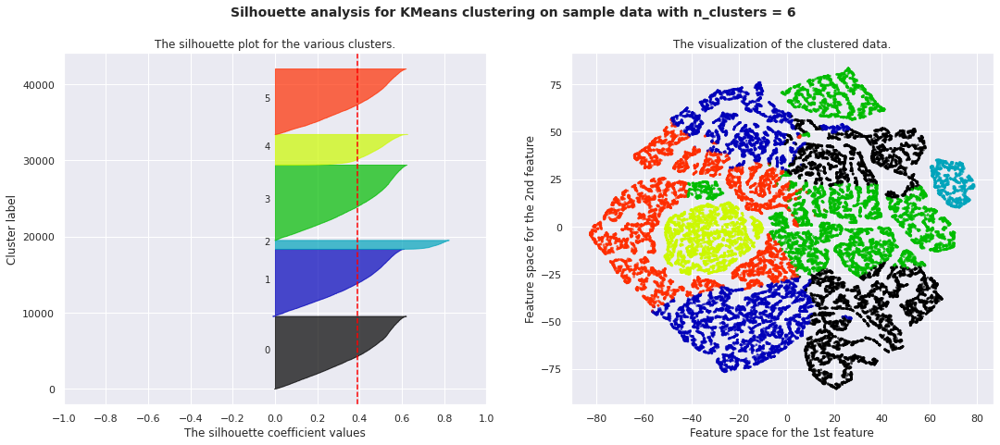

In [ ]:
plot_silhouette_project_KMEANS(X, X_tsne, 6)

In [ ]:
km = KMeans(n_clusters=6, random_state=10)
km.fit_predict(X)

array([3, 0, 1, ..., 0, 5, 3], dtype=int32)

In [ ]:
X_labeled = pd.DataFrame(X, columns=features+review)
X_labeled['cluster'] = km.labels_

In [ ]:
X_labeled['cluster'].value_counts()

3    9883
0    9543
1    8806
5    8603
4    4013
2    1166
Name: cluster, dtype: int64

In [ ]:
X_final = pd.concat([df_2017['customer_unique_id'], X_labeled], axis=1)

In [ ]:
X_labeled.groupby('cluster').agg({'frequency':'mean', 'recency':'mean', 'monetary':'mean', 'nb_items_ordered':'mean', 'review_score':'mean'})

,frequency,recency,monetary,nb_items_ordered,review_score
cluster,,,,,
0,-0.168951,-0.880634,-0.885271,-0.374794,0.794391
1,-0.168951,-0.852030,0.821120,-0.374794,0.785728
2,5.918791,-0.129234,0.888647,2.675178,0.797274
3,-0.168951,0.848391,-0.924650,-0.374794,0.815959
4,-0.168951,-0.004834,0.615104,2.662914,0.669979
5,-0.168951,0.894143,0.796361,-0.374794,0.812013


# DF_2017_2m_all

In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary', 'nb_items_ordered']
review=['review_score']

In [ ]:
pipe1 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                        #  ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

pipe2 = Pipeline([
                         ('selector', DataFrameSelector(review)),
                         ('std_scaler', MinMaxScaler())
])

full_pipeline = FeatureUnion(transformer_list=[
                                               ('pipe1', pipe1),
                                               ('pipe2', pipe2)
])

In [ ]:
df_2017_2m = add_attr_group(df_2017_2m)

In [ ]:
X1 = full_pipeline.fit_transform(df_2017_2m)

In [ ]:
X1_tsne = TSNE(n_components=2).fit_transform(X1)

For n_clusters = 6 The average silhouette_score is : 0.3900394065683401


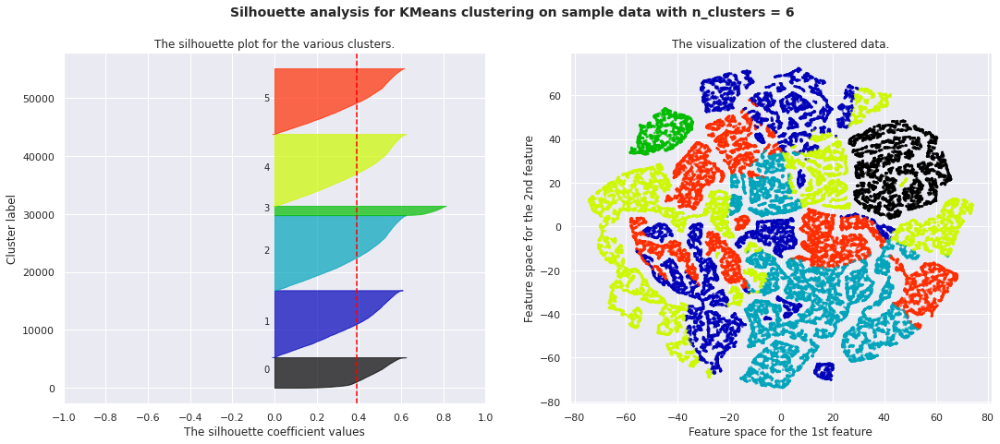

In [ ]:
plot_silhouette_project_KMEANS(X1, X1_tsne, 6)

In [ ]:
km1 = KMeans(n_clusters=6, random_state=10)
km1.fit_predict(X1)

array([2, 2, 1, ..., 4, 5, 2], dtype=int32)

In [ ]:
X1_labeled = pd.DataFrame(X1, columns=features+review)
X1_labeled['cluster'] = km1.labels_

In [ ]:
X1_labeled['cluster'].value_counts()

2    12941
4    12392
1    11581
5    11315
0     5244
3     1608
Name: cluster, dtype: int64

In [ ]:
X1_final = pd.concat([df_2017_2m['customer_unique_id'],X1_labeled], axis=1)

# DF_2017_4m_all

In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary', 'nb_items_ordered']
review=['review_score']

In [ ]:
pipe1 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                        #  ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

pipe2 = Pipeline([
                         ('selector', DataFrameSelector(review)),
                         ('std_scaler', MinMaxScaler())
])

full_pipeline = FeatureUnion(transformer_list=[
                                               ('pipe1', pipe1),
                                               ('pipe2', pipe2)
])

In [ ]:
df_2017_4m = add_attr_group(df_2017_4m)

In [ ]:
X2 = full_pipeline.fit_transform(df_2017_4m)

In [ ]:
X2_tsne = TSNE(n_components=2).fit_transform(X2)

For n_clusters = 6 The average silhouette_score is : 0.3886957457157413


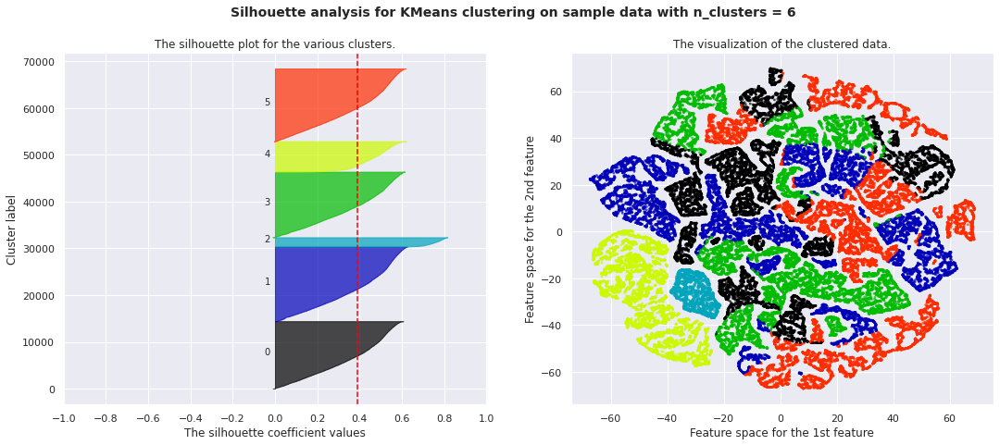

In [ ]:
plot_silhouette_project_KMEANS(X2, X2_tsne, 6)

In [ ]:
km2 = KMeans(n_clusters=6, random_state=10)
km2.fit_predict(X2)

array([1, 1, 3, ..., 5, 3, 1], dtype=int32)

In [ ]:
X2_labeled = pd.DataFrame(X2, columns=features+review)
X2_labeled['cluster'] = km2.labels_

In [ ]:
X2_labeled['cluster'].value_counts()

1    15941
5    15557
0    14413
3    14011
4     6499
2     2001
Name: cluster, dtype: int64

In [ ]:
X2_final = pd.concat([df_2017_4m['customer_unique_id'],X2_labeled], axis=1)

In [ ]:
X1_labeled.groupby('cluster').agg({'frequency':'mean', 'recency':'mean', 'monetary':'mean', 'nb_items_ordered':'mean', 'review_score':'mean'})

,frequency,recency,monetary,nb_items_ordered,review_score
cluster,,,,,
0,-0.173409,0.002077,0.625650,2.649249,0.647716
1,-0.173409,-0.864427,0.775136,-0.376750,0.755947
2,-0.173409,0.865782,-0.887902,-0.376750,0.814755
3,5.766612,-0.158364,0.915285,2.660213,0.788115
4,-0.173409,-0.870664,-0.933571,-0.376750,0.782400
5,-0.173409,0.869631,0.824535,-0.376750,0.817863


# DF_2017_6m_all

In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary', 'nb_items_ordered']
review=['review_score']

In [ ]:
pipe1 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                        #  ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

pipe2 = Pipeline([
                         ('selector', DataFrameSelector(review)),
                         ('std_scaler', MinMaxScaler())
])

full_pipeline = FeatureUnion(transformer_list=[
                                               ('pipe1', pipe1),
                                               ('pipe2', pipe2)
])

In [ ]:
df_2017_6m = add_attr_group(df_2017_6m)

In [ ]:
X3 = full_pipeline.fit_transform(df_2017_6m)

In [ ]:
X2_tsne = TSNE(n_components=2).fit_transform(X2)

For n_clusters = 6 The average silhouette_score is : 0.3886957457157413


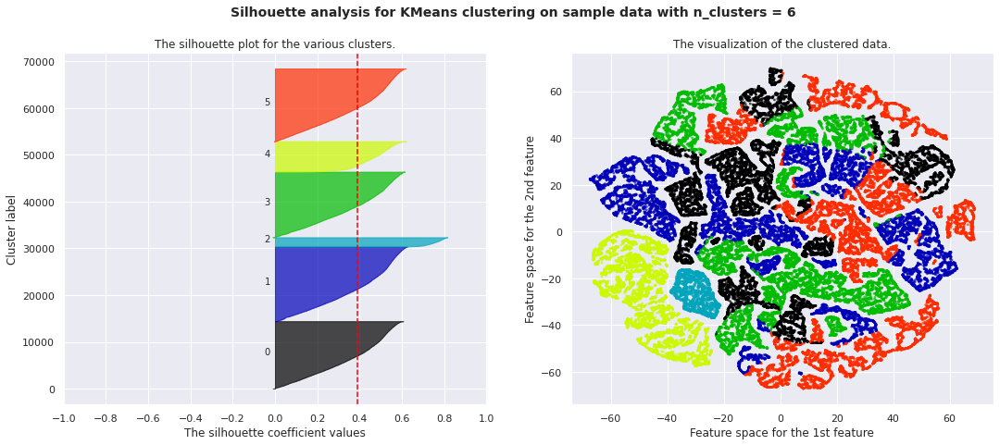

In [ ]:
plot_silhouette_project_KMEANS(X2, X2_tsne, 6)

In [ ]:
km3 = KMeans(n_clusters=6, random_state=10)
km3.fit_predict(X3)

array([0, 5, 4, ..., 2, 0, 4], dtype=int32)

In [ ]:
X3_labeled = pd.DataFrame(X3, columns=features+review)
X3_labeled['cluster'] = km3.labels_

In [ ]:
X3_labeled['cluster'].value_counts()

4    18802
5    18447
0    16877
2    16516
3     7743
1     2408
Name: cluster, dtype: int64

In [ ]:
X3_final = pd.concat([df_2017_6m['customer_unique_id'],X3_labeled], axis=1)

# DF_2017_8m_all

In [ ]:
# features= ['frequency', 'nb_days_to_deliver',
#        'payment_installments', 'review_score', 'title_length',
#        'message_length', 'recency', 'nb_items_ordered', 'monetary', 'perc_freight',
#        'product_name_lenght', 'product_description_lenght',
#        'product_photos_qty', 'monetary_cat']

features= ['frequency', 'recency', 'monetary', 'nb_items_ordered']
review=['review_score']

In [ ]:
pipe1 = Pipeline([
                         ('selector', DataFrameSelector(features)),
                         ('log_transform', QuantileTransformer(n_quantiles=1000, output_distribution='uniform')),
                        #  ('log_transform', FunctionTransformer(np.log1p)),
                         ('std_scaler', StandardScaler())
])

pipe2 = Pipeline([
                         ('selector', DataFrameSelector(review)),
                         ('std_scaler', MinMaxScaler())
])

full_pipeline = FeatureUnion(transformer_list=[
                                               ('pipe1', pipe1),
                                               ('pipe2', pipe2)
])

In [ ]:
df_2017_8m = add_attr_group(df_2017_8m)

In [ ]:
X4 = full_pipeline.fit_transform(df_2017_8m)

In [ ]:
X2_tsne = TSNE(n_components=2).fit_transform(X2)

For n_clusters = 6 The average silhouette_score is : 0.3886957457157413


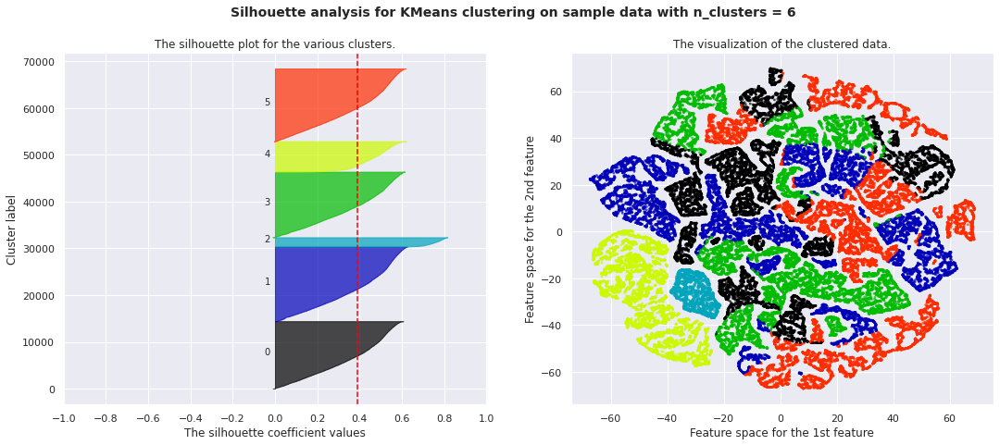

In [ ]:
plot_silhouette_project_KMEANS(X2, X2_tsne, 6)

In [ ]:
km4 = KMeans(n_clusters=6, random_state=10)
km4.fit_predict(X4)

array([0, 3, 1, ..., 5, 0, 1], dtype=int32)

In [ ]:
X4_labeled = pd.DataFrame(X4, columns=features+review)
X4_labeled['cluster'] = km4.labels_

In [ ]:
values=X4_labeled['cluster'].value_counts().sort_index()
# names = values.index()
values, names

(0    19462
 1    21786
 2     2782
 3    21105
 4     8766
 5    18955
 Name: cluster, dtype: int64, Int64Index([1, 3, 0, 5, 4, 2], dtype='int64'))

([<matplotlib.patches.Wedge at 0x7f0cee37c940>,
 [Text(0.8144742885701768, 0.7393454086271886, ''),
  Text(-0.6368245494853133, 0.8969138716581587, ''),
  Text(-1.0047909880874493, -0.44765507956265593, ''),
  Text(0.16230083044875704, -1.0879606796367431, ''),
  Text(0.973231573292376, -0.5126600284270725, ''),
  Text(1.0951310439707898, -0.10338276709127227, '')])

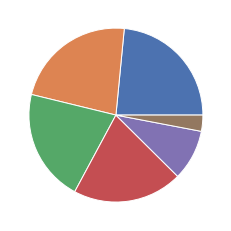

In [ ]:
plt.pie(X4_labeled['cluster'].value_counts())

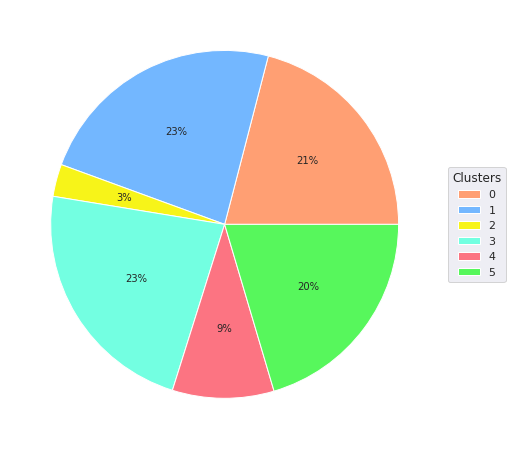

In [ ]:
fig=plt.figure(figsize=(8,8))
colors = ['#ff9f73','#73b7ff','#f7f419','#73ffe1', '#fc7482','#57f75c']
plt.pie(values, autopct='%1.f%%', colors=colors)
plt.legend(['0', '1','2','3','4','5'],
          title="Clusters",
          loc="center left",
          bbox_to_anchor=(1, 0, 0.5, 1))

# plt.title("Nutriscore distribution within the dataset")

In [ ]:
X4_final = pd.concat([df_2017_8m['customer_unique_id'],X4_labeled], axis=1)

In [ ]:
merge4 = X_final.merge(X4_final, on='customer_unique_id', how='left')

In [ ]:
adjusted_rand_score(merge4['cluster_x'], merge4['cluster_y'])

0.5331599840977791

In [ ]:
X1_labeled.groupby('cluster').agg({'frequency':'mean', 'recency':'mean', 'monetary':'mean', 'nb_items_ordered':'mean', 'review_score':'mean'})

,frequency,recency,monetary,nb_items_ordered,review_score
cluster,,,,,
0,-0.173409,0.002077,0.625650,2.649249,0.647716
1,-0.173409,-0.864427,0.775136,-0.376750,0.755947
2,-0.173409,0.865782,-0.887902,-0.376750,0.814755
3,5.766612,-0.158364,0.915285,2.660213,0.788115
4,-0.173409,-0.870664,-0.933571,-0.376750,0.782400
5,-0.173409,0.869631,0.824535,-0.376750,0.817863


# ARI

In [ ]:
merge1 = X_final.merge(X1_final, on='customer_unique_id', how='left')
adjusted_rand_score(merge1['cluster_x'], merge1['cluster_y'])

0.6710223431762137

In [ ]:
merge2 = X_final.merge(X2_final, on='customer_unique_id', how='left')
adjusted_rand_score(merge2['cluster_x'], merge2['cluster_y'])

0.5314618971830339

In [ ]:
merge3 = X_final.merge(X3_final, on='customer_unique_id', how='left')
adjusted_rand_score(merge3['cluster_x'], merge3['cluster_y'])

0.5215833117013318

In [ ]:
merge4 = X_final.merge(X4_final, on='customer_unique_id', how='left')
adjusted_rand_score(merge4['cluster_x'], merge4['cluster_y'])

0.5331599840977791

In [ ]:
merge12 = X1_final.merge(X2_final, on='customer_unique_id', how='left')
adjusted_rand_score(merge12['cluster_x'], merge12['cluster_y'])

0.7403281956182208

In [ ]:
merge13 = X1_final.merge(X3_final, on='customer_unique_id', how='left')
adjusted_rand_score(merge13['cluster_x'], merge13['cluster_y'])

0.5796008169108751

In [ ]:
merge14 = X1_final.merge(X4_final, on='customer_unique_id', how='left')
adjusted_rand_score(merge14['cluster_x'], merge14['cluster_y'])

0.5150919259900419

In [ ]:
merge23 = X2_final.merge(X3_final, on='customer_unique_id', how='left')
adjusted_rand_score(merge23['cluster_x'], merge23['cluster_y'])

0.7856353098850289

In [ ]:
merge24 = X2_final.merge(X4_final, on='customer_unique_id', how='left')
adjusted_rand_score(merge24['cluster_x'], merge24['cluster_y'])

0.6402797925596779

In [ ]:
merge34 = X3_final.merge(X4_final, on='customer_unique_id', how='left')
adjusted_rand_score(merge34['cluster_x'], merge34['cluster_y'])

0.8211779617982004

# Cluster interpretation

In [ ]:
X4_final

,customer_unique_id,frequency,recency,monetary,nb_items_ordered,review_score,cluster
0,0000366f3b9a7992bf8c76cfdf3221e2,-0.175742,-0.892894,0.465616,-0.376687,1.00,0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,-0.175742,-0.854751,-1.656678,-0.376687,0.75,3
2,0000f46a3911fa3c0805444483337064,-0.175742,1.621087,-0.366850,-0.376687,0.50,1
3,0000f6ccb0745a6a4b88665a16c9f078,-0.175742,0.747262,-1.307564,-0.376687,0.75,1
4,0004aac84e0df4da2b147fca70cf8255,-0.175742,0.572150,0.969888,-0.376687,1.00,5
...,...,...,...,...,...,...,...
92851,fffcf5a5ff07b0908bd4e2dbc735a684,-0.175742,1.319409,1.725442,2.603399,1.00,4
92852,fffea47cd6d3cc0a88bd621562a9d061,-0.175742,0.303414,-0.399562,-0.376687,0.75,1
92853,ffff371b4d645b6ecea244b27531430a,-0.175742,1.690438,0.064640,-0.376687,1.00,5
92854,ffff5962728ec6157033ef9805bacc48,-0.175742,-0.820075,0.360009,-0.376687,1.00,0


In [ ]:
X4_final.dtypes

customer_unique_id     object
frequency             float64
recency               float64
monetary              float64
nb_items_ordered      float64
review_score          float64
cluster                 int32
dtype: object

In [ ]:
X4_final['cluster'].astype('object').value_counts()

1    21786
3    21105
0    19462
5    18955
4     8766
2     2782
Name: cluster, dtype: int64

In [ ]:
pipe1.inverse_transform(X4_final['recency'])

ValueError: ignored

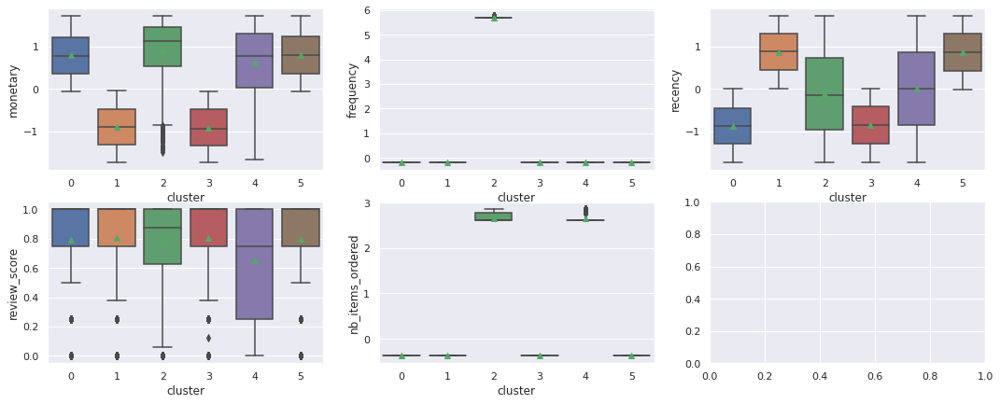

In [ ]:
fig, ax = plt.subplots(2, 3)
fig.set_size_inches(18, 7)
sns.boxplot(y='monetary', x='cluster', data=X4_final, ax=ax[0,2], showmeans=True )
sns.boxplot(y='frequency', x='cluster', data=X4_final, ax=ax[0,1], showmeans=True)
sns.boxplot(y='recency', x='cluster', data=X4_final, ax=ax[0,0], showmeans=True)
sns.boxplot(y='review_score', x='cluster', data=X4_final, ax=ax[1,0], showmeans=True)
sns.boxplot(y='nb_items_ordered', x='cluster', data=X4_final, ax=ax[1,1], showmeans=True)

  - Cluster 2: Best customers (frequent, spend more)
  - Cluster 4: Unhappy customers (bought multiple items at once) 
  - Cluster 0: Happy customers that spend much than average however did not buy recently
  - Cluster 5: Same as Cluster 0 but recent buyers.
  - Cluster 1: low value but spent recently and relatively happy with their purchase
  - Cluster 3: lost customers (low value and last purchase long time ago)


Actions from marketers:
Generally speaking, the community within Olist is not really active. Only 2% of the customers have ordered multiple times. The focus should be on keeping the most active customers and converting other clients into frequent buyers.

Different actions where identified to to that:
  - Fidelity program for cluster 2 + investigate why unhappy customers and send offers
  - Cluster 5 high potential. Happy customers, recent buyers and high value. Send them attractive offers. They represent the population with the highest probability of converting to best clients.
  - Take action to make them (Cluster 0) buy again as there are high valued customers.
  - Low value customers (Cluster 1) but bought recently and statified with their purchase. 
  - Cluster 4 Try to understand why these customers where unhappy as it might give many insights to improve the overall Olist experience and build a stronger community.
  -  Lost customers. Might be too late to bring them back to buy. 